# Characterization of Searching for Parking Using Foursquare Data

## Introduction
In this project, I will be using foursquare location data to analyze and characterize the average percentage number of vehicles searching for parking by the hour around a given parking location in different neighbourhoods of Toronto, Canada.  

For different neighbourhoods, the activities at different venues in each neighbourhood has an effect on the average time taken for car owners to find parking space in such neighbourhoods. 
For example for neighbourhoods with many resturants, night clubs and cafe, the average time taken to find parking space could be much longer in the evenings when compared to the average time taken to find parking space in neighbourhoods that do not have such points of interest. 

## Background
The information below was taken from the web site: __(https://data.geotab.com/urban-infrastructure/searching-for-parking)__:

Studies reveal that drivers searching for parking in large urban centers not only causes frustration, but contributes to traffic congestion and additional greenhouse gas (GHG) emissions. To put the problem into perspective, on average, American drivers spend 17 hours a year searching for parking, which is estimated to cost $345 per driver in time, fuel, and emissions. Drivers are not the only ones impacted by this problem - cities are as well. Out of 6,000 U.S. drivers that responded to a survey, sixty three percent reported they avoided driving to a destination due to parking challenges.

## StakeHolders
This type of analysis could be interesting for city planners that need clear understanding of how parking location are used with respect to the activities in the different neighbourhoods of a city.
The analysis could also be of interest to would-be enterprenours that are planning to invest in new businesses in different neighbourhoods in a city

## The Data
Two sets of data will be used in this project: 
1. Searching for parking data from Geotab - __(https://data.geotab.com/urban-infrastructure/searching-for-parking)__.
1. Foursquare location data

### Searching for Parking Data
This data set is a crowd source data set that is provided free of charge by Geotab. Full description is give at the web site: __(https://data.geotab.com/urban-infrastructure/searching-for-parking)__. 
The data set is constructed from a rolling average for the last six months and it is available in Google Big Query table. The table below gives a summary of the fields in the Big Query table:

| Field | Type   | Description|   
|:------:|:------:|:------|
|Geohash|STRING|Geohash at the 7 character level (153m x 153m) that identifies the geohash associated with the parking area|
|Latitude_SW|FLOAT|Latitude of the southwest corner of the geohash|
|Longitude_SW|FLOAT|Longitude of the southwest corner of the geohash|
|Latitude_NE|FLOAT|Latitude of the northeast corner of the geohash|
|Longitude_NE|FLOAT|Longitude of the northeast corner of the geohash|
|Latitude|FLOAT|The average latitude of the parking location|
|Longitude|FLOAT|The average longitude of the parking location|
|City|STRING|City (or municipality) within which the geohash resides (U.S., Canada, and Mexico only)|
|County|STRING|County within which the geohash resides (U.S. and Mexico only)|
|State|STRING|State within which the geohash resides (U.S., Canada, and Mexico only)|
|Country|STRING|Country (or territory) within which the geohash resides (English common name)|
|ISO_3166_2|STRING|ISO_3166_2 codes for country and subdivision|
|AvgTimeToPark|FLOAT|The average time taken to search for parking (in minutes)|
|AvgTimeToParkRatio|FLOAT|The ratio between the average time taken to search for parking and of those not searching for parking in the current geohash|
|TotalSearching|FLOAT|The number of drivers searching for parking|
|PercentSearching|FLOAT|The percentage of drivers that were searching for parking|
|AvgUniqueGeohashes|FLOAT|The average number of unique geohashes at the 7 character level (including neighbouring and parking geohashes) that were driven in among vehicles that searched for parking|
|AvgTotalGeohashes|FLOAT|The average number of total geohashes at the 7 character level (including neighbouring and parking geohashes) that were driven in among vehicles that searched for parking|
|CirclingDistribution|STRING|JSON object representing the neighbouring geohashes at the 7 character level whereby vehicles searching for parking tend to spend their time. Each geohash will have the average percentage of time spent in that geohash prior to parking|
|HourlyDistribution|STRING|JSON object representing the average prevalence of searching for parking by hour of day (% distribution based on number of vehicles experiencing parking problems)|
|SearchingByHour|STRING|JSON object representing the average percentage of vehicles searching for parking within the hour|
|PercentCar|FLOAT|Percentage of vehicles with parking issues that were cars.|
|PercentMpv|FLOAT|Percentage of vehicles with parking issues that were multi-purpose vehicles.|
|PercentLdt|FLOAT|Percentage of vehicles with parking issues that were light duty trucks|
|PercentMdt|FLOAT|Percentage of vehicles with parking issues that were medium duty trucks|
|PercentHdt|FLOAT|Percentage of vehicles with parking issues that were heavy duty trucks.|
|PercentOther|FLOAT|Percentage of vehicles with parking issues that were of unknown classification.|
|UpdateDate|DATETIME|Date and time that the record was updated.|
|Version|STRINGT|Version number of the dataset.|

The code below shows an example of the average percentage number of vehicles seacrhing for parking by the hour around a given parking location in Toronto, Canada. The dataset was extracted into a csv file from Big Table and used in the code shown.

In [85]:
import folium
import geohash as gh
import pandas as pd
import numpy as np
import json
import vincent
from pandas.io.json import json_normalize
from geopy.geocoders import Nominatim # convert an address into latitude and longitude values and vice versa
import requests
import seaborn as sns
import matplotlib.pyplot as plt
import scipy.stats as stats
from sklearn.preprocessing import MinMaxScaler
from folium.plugins import HeatMap
from sklearn.cluster import KMeans
import matplotlib.cm as cm
import matplotlib.colors as colors
from selenium import webdriver
import os
import time

In [2]:
data =  pd.read_csv('results-20190728-131843.csv') # data for a parking location 

In [88]:
nbrs = pd.DataFrame()

for i in np.arange(0,len(data),1):
 rows = data.iloc[i].SearchingByHour
 rows = json_normalize(json.loads(rows)).transpose().reset_index()
 rows.dropna(subset=[0], inplace=True)

 nbrs = nbrs.append(rows)
 nbrs = nbrs.set_index('index')

 bar = vincent.Bar(nbrs.iloc[:,0])
 bar.axis_titles(x='Parking Geohash: ' + data['Geohash'][0], y='Searching By Hour')
 bar.width = 450
 bar.height = 250
 bar.to_json('hourlydata.json')

 parking_location_map = folium.Map(location=[data['Latitude'][0],data['Longitude'][0]], height=1000, zoom_start=20, control_scale = True, tiles='openstreetmap')

 folium.Marker(
  location = [data['Latitude'][0],data['Longitude'][0]],
  popup=folium.Popup(max_width=500).add_child(folium.Vega(json.load(open('hourlydata.json')), width=500, height=300))
 ).add_to(parking_location_map)
 display(parking_location_map)

In [131]:
def save_map_as_image(parking_location_map, file_name):
    delay=5
    #Save the map as an HTML file
    fn = file_name + '.html'
    tmpurl='file://{path}/{mapfile}'.format(path=os.getcwd(),mapfile=fn)
    parking_location_map.save(fn)
    #Open a browser window...
    browser = webdriver.Firefox(executable_path="/usr/local/bin/geckodriver")
    #..that displays the map...
    browser.get(tmpurl)
    #Give the map tiles some time to load
    time.sleep(delay)
    #Grab the screenshot
    browser.save_screenshot(file_name + '.png')
    #Close the browser
    browser.quit()

In [95]:
save_map_as_image(parking_location_map, 'parking_location_map')

The objective of this project is to use foursquare location data to categorize the main activities behind the usage of such parking locations. We see peak hours in the distribution shown in the map which could be related to the categories of venues in the neighbourhoods around the parking location.  

### Foursquare Venues Categories
Foursquare provides an API that can be used to access information about different categories of venues around a parking location. The list below shows the main categories that are avaliable through the API. Each main category contains one or more sub-categories.

1. Arts & Entertainment (4d4b7104d754a06370d81259)
1. College & University (4d4b7105d754a06372d81259)
1. Event (4d4b7105d754a06373d81259)
1. Food (4d4b7105d754a06374d81259)
1. Nightlife Spot (4d4b7105d754a06376d81259)
1. Outdoors & Recreation (4d4b7105d754a06377d81259)
1. Professional & Other Places (4d4b7105d754a06375d81259)
1. Residence (4e67e38e036454776db1fb3a)
1. Shop & Service (4d4b7105d754a06378d81259)
1. Travel & Transport (4d4b7105d754a06379d81259)

Full details are available from the web site: __(https://developer.foursquare.com/docs/resources/categories)__. In this project, the API will be used to query for information using the main categories. 

## Method
The following methods will be used in the analysis and categorization of the searching of parking data:
1. Use boxplots to show the number of venues in each Foursquare venue category in order to show which activity dominates utilization of the parking location.
1. Use k-mean clustering to show the dominant venue categories within 1000 metres of a parking location.

In [4]:
geolocator = Nominatim(user_agent="searching_for_parking")
def get_coordinates(area_address): # area = city, neighbourhood, county etc
        #area_address = 'North York, ON'
        area_location = geolocator.geocode(area_address)
        print('The geograpical coordinate of {} is {}, {}.'.format(area_address, area_location.latitude, area_location.longitude))
        return area_location

In [5]:
def get_street_from_parking_location(latitude, longitude):
    #geolocator = Nominatim(user_agent="searching_for_parking")
    location_str = str(latitude) + ',' + str(longitude)
    address = geolocator.reverse(location_str)
    return address

In [6]:
class foursquare_user_info_file_handler:
    def __init__(self):
        self.cached_file_data = None
    
    def do_search(self, token):
        found = None
        token = token.strip('\r\n')
        for line in self.cached_file_data:
            splitted = line.split('=')
            if token == splitted[0]:
                found = splitted[1]
        return found
    
    def set_data(self, file):
        if self.cached_file_data == None:
            file_handle = open(file, 'r')
            self.cached_file_data = file_handle.readlines()
            file_handle.close()
        
    def get_user_data_from_file(self, token, file):
        self.set_data(file)
        return self.do_search(token)

In [7]:
def get_categories_data(venue_category):
        for category_item in venue_category:
            cat_id = category_item['id']
            cat_name = category_item['name']
            cat_pluralName = category_item['pluralName']
            cat_shortName = category_item['shortName']
            cat_icon = category_item['icon']
            cat_prefix = cat_icon['prefix']
            cat_suffix = cat_icon['suffix']
            cat_primary = category_item['primary']
            
            categories_icon = (cat_prefix, cat_suffix)
        
        categories_Data = (cat_id, cat_name, cat_pluralName, cat_shortName, categories_icon, cat_primary)
        return categories_Data

In [8]:
file_handler = foursquare_user_info_file_handler()
file_path = './foursquare_id_info.txt'
CLIENT_ID = file_handler.get_user_data_from_file('CLIENT_ID', file_path)
CLIENT_SECRET = file_handler.get_user_data_from_file('CLIENT_SECRET', file_path)
VERSION = file_handler.get_user_data_from_file('VERSION', file_path)

In [9]:
#all_venues_nearby = pd.DataFrame(columns=['Venue', 'Venue Latitude', 'Venue Longitude', 'Venue Category'])
def getNearbyVenues(lat, lng, category_id, radius=500):
    try:
        # create the API request URL
        url =  'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&categoryId={}'.format(
            CLIENT_ID, 
            CLIENT_SECRET, 
            VERSION, 
            lat, 
            lng, 
            radius,
            category_id
           )
        # make the GET request
        json_results = requests.get(url).json()
        response = json_results["response"]
        total_results = response['totalResults']
        if total_results > 0:
            results = response['groups'][0]['items']
            nearby_venues_cat = pd.DataFrame(columns = ['Venue', 'Venue Latitude', 'Venue Longitude', 'Venue Category'])
            for v in results:
                venue_name = v['venue']['name']
                #print(venue_name)
                venue_lat = v['venue']['location']['lat']
                venue_lng = v['venue']['location']['lng']
                venue_category = v['venue']['categories']
                categories_Data = get_categories_data(venue_category)
                cat_name = categories_Data[1]
                # return only relevant information for each nearby venue
                nearby_venues_cat = nearby_venues_cat.append({'Venue': venue_name, 'Venue Latitude': venue_lat, 'Venue Longitude': venue_lng, 'Venue Category': cat_name}, ignore_index=True)
                #all_venues_nearby = all_venues_nearby.append({'Venue': venue_name, 'Venue Latitude': venue_lat, 'Venue Longitude': venue_lng, 'Venue Category': cat_name}, ignore_index=True)
            return nearby_venues_cat
        else:
            return None
    except:
        return None 

In [10]:
class Coordinate:
    def __init__(self, lat, lng):
        self.lat = lat
        self.lng = lng
        
class geohash_handler:
    def __init__(self):
        self.coordinate = None
        self.geohash = None
        
    def get_geohash(self, lat, lng):
        self.coordinate = Coordinate(lat, lng)
        self.geohash = geohash.encode(lat, lng, precision=7)
        return self.geohash
    
    def decode_geohash(self, geohash_in):
        pair_value = geohash.decode(geohash_in)
        return Coordinate(pair_value[0], pair_value[1])  

In [11]:
def get_coordinates(area_address): # area = city, neighbourhood, county etc
        #area_address = 'North York, ON'
        geolocator = Nominatim(user_agent="on_explorer")
        area_location = geolocator.geocode(area_address)
        print('The geograpical coordinate of {} is {}, {}.'.format(area_address, area_location.latitude, area_location.longitude))
        return area_location

In [12]:
area_address = 'Scarborough, Toronto, Ontario, M1S 5C2'
def get_coordinates(area_address): # area = city, neighbourhood, county etc
        #area_address = 'North York, ON'
        geolocator = Nominatim(user_agent="on_explorer")
        area_location = geolocator.geocode(area_address)
        print('The geograpical coordinate of {} is {}, {}.'.format(area_address, area_location.latitude, area_location.longitude))
        return area_location

In [13]:
toronto_data_file = 'results-20190801-184800.csv'

In [14]:
toronto_data_df = pd.read_csv(toronto_data_file)

In [15]:
def create_search_for_parking_index(df):
    ### Decode Geohash into latitude and longitude
    df['Latitude'] = df.apply(lambda row: gh.decode(row.Geohash)[0], axis = 1)
    df['Longitude'] = df.apply(lambda row: gh.decode(row.Geohash)[1], axis = 1)
    
    #### Calculate Searching for Parking Index and scale it to range from 1 to 10
    a = 0.3
    b = 0.7
    df['Index_tmp'] = df.apply(lambda row: a*row['SearchingForParkingRatio'] + b*row['AvgTimeToParkRatio'], axis = 1)
    return df

In [16]:
def scale_search_for_parking_index(df):
    IndexMax = df.Index_tmp.mean() + 3*df.Index_tmp.std()
    ScaleData = df[df.Index_tmp <= IndexMax]
    scaler = MinMaxScaler(feature_range=(0,10)).fit(pd.DataFrame(ScaleData.Index_tmp))
    df['Index'] = scaler.transform(pd.DataFrame(df.Index_tmp))
    df = df.round({'Index':2})
    df['Index'] = df.apply(lambda row: 10 if row['Index'] > 10 else row['Index'], axis=1)
    return df

In [17]:
def create_map(df):
    #### Create heatmap data
    heatmap_data = df[['Geohash','Index','Latitude','Longitude']]
    heatmap_data['Value'] = heatmap_data.apply(lambda row: [row.Latitude, row.Longitude, row.Index/10], axis = 1)
    heatdata = heatmap_data.Value.tolist() # a list of lists: [[latitude, longitude, index/10],...]
    
    #### Define map
    area_address = 'Toronto, Ontario, CA'
    toronto_location = get_coordinates(area_address)
    heatmap = folium.Map([toronto_location.latitude, toronto_location.longitude], tiles='openstreetmap', zoom_start=6)
    
    #### Plot Geohash Markers
    Markers = folium.FeatureGroup(name='ParkingGeohash Markers')
    
    # Add markers to layer
    for index, row in heatmap_data.iterrows():
        c = folium.Marker([row['Latitude'],row['Longitude']], popup = 'Geohash: ' + row.Geohash + ', Index: ' + str(row.Index))
        c.add_to(Markers)
    Markers.add_to(heatmap)
    
    #### Plot heatmap based on the Searching for Parking Index
    index = folium.FeatureGroup(name='Geohash - Index')
    HeatMap(data = heatdata, min_opacity = 0.3, max_zoom = 12, max_val = 1, radius = 25).add_to(index)
    index.add_to(heatmap)
    
    # Add all the layers (feature groups) onto the map
    folium.LayerControl().add_to(heatmap)
    return heatmap

In [18]:
toronto_data_df = create_search_for_parking_index(toronto_data_df)
toronto_data_df = scale_search_for_parking_index(toronto_data_df)

In [19]:
heatmap = create_map(toronto_data_df) 
heatmap 

/home/otasowie/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  after removing the cwd from sys.path.


The geograpical coordinate of Toronto, Ontario, CA is 43.7170226, -79.4197830350134.


In [101]:
save_map_as_image(heatmap, 'heatmap')

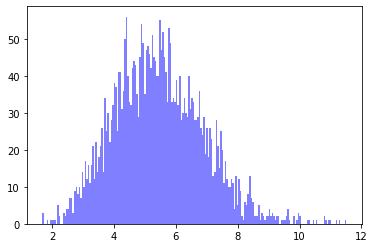

In [20]:
AvgTimeToPark = toronto_data_df['AvgTimeToPark']
np_array = np.array(AvgTimeToPark)
num_bins = 200
mu = np_array.mean()
sigma = np_array.std()
n, bins, patches = plt.hist(np_array, num_bins, facecolor='blue', alpha=0.5)
plt.show()

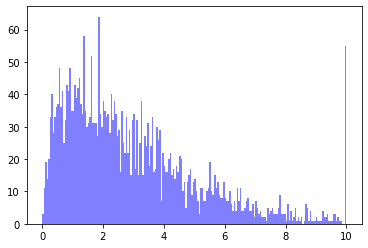

In [21]:
Index = toronto_data_df['Index']
np_array = np.array(Index)
num_bins = 200
mu = np_array.mean()
sigma = np_array.std()
n, bins, patches = plt.hist(np_array, num_bins, facecolor='blue', alpha=0.5)
plt.show()

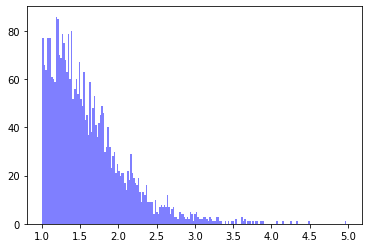

In [22]:
AvgTimeToParkRatio = toronto_data_df['AvgTimeToParkRatio']
np_array = np.array(AvgTimeToParkRatio)
num_bins = 200
mu = np_array.mean()
sigma = np_array.std()
n, bins, patches = plt.hist(np_array, num_bins, facecolor='blue', alpha=0.5)
plt.show()

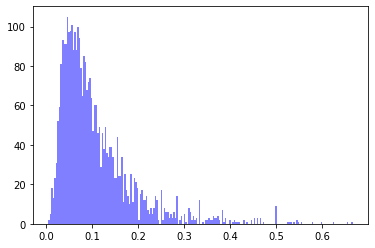

In [23]:
PercentSearching = toronto_data_df['PercentSearching']
np_array = np.array(PercentSearching)
num_bins = 200
mu = np_array.mean()
sigma = np_array.std()
n, bins, patches = plt.hist(np_array, num_bins, facecolor='blue', alpha=0.5)
plt.show()

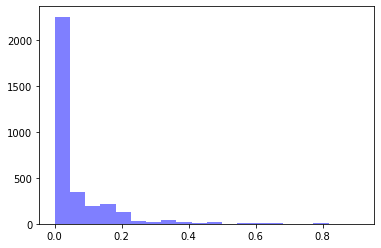

In [24]:
PercentCar = toronto_data_df['PercentCar']
np_array = np.array(PercentCar)
num_bins = 20
mu = np_array.mean()
sigma = np_array.std()
n, bins, patches = plt.hist(np_array, num_bins, facecolor='blue', alpha=0.5)
plt.show()

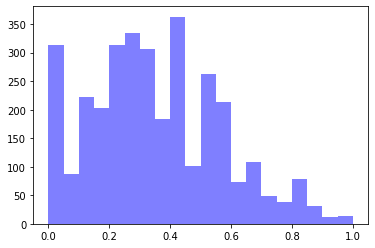

In [25]:
PercentMPV = toronto_data_df['PercentMPV']
np_array = np.array(PercentMPV)
num_bins = 20
mu = np_array.mean()
sigma = np_array.std()
n, bins, patches = plt.hist(np_array, num_bins, facecolor='blue', alpha=0.5)
plt.show()

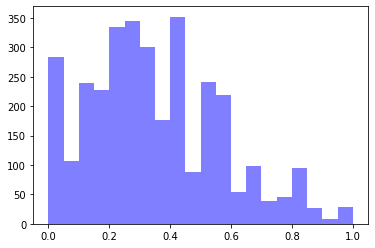

In [26]:
PercentLDT = toronto_data_df['PercentLDT']
np_array = np.array(PercentLDT)
num_bins = 20
mu = np_array.mean()
sigma = np_array.std()
n, bins, patches = plt.hist(np_array, num_bins, facecolor='blue', alpha=0.5)
plt.show()

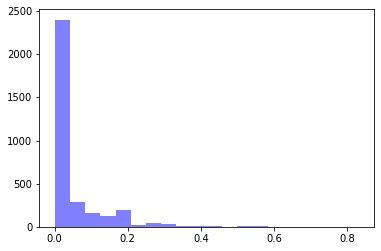

In [27]:
PercentMDT = toronto_data_df['PercentMDT']
np_array = np.array(PercentMDT)
num_bins = 20
mu = np_array.mean()
sigma = np_array.std()
n, bins, patches = plt.hist(np_array, num_bins, facecolor='blue', alpha=0.5)
plt.show()

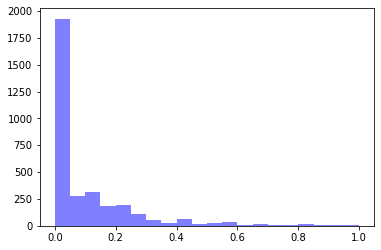

In [28]:
PercentHDT = toronto_data_df['PercentHDT']
np_array = np.array(PercentHDT)
num_bins = 20
mu = np_array.mean()
sigma = np_array.std()
n, bins, patches = plt.hist(np_array, num_bins, facecolor='blue', alpha=0.5)
plt.show()

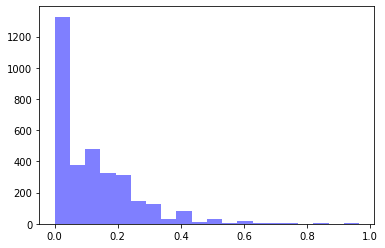

In [29]:
PercentOther = toronto_data_df['PercentOther']
np_array = np.array(PercentOther)
num_bins = 20
mu = np_array.mean()
sigma = np_array.std()
n, bins, patches = plt.hist(np_array, num_bins, facecolor='blue', alpha=0.5)
plt.show()

In [30]:
reduced_set_df = toronto_data_df.loc[toronto_data_df['Index'] > 9.9]

In [31]:
reduced_set_df.shape

(55, 32)

In [96]:
reduced_set_heatmap = create_map(reduced_set_df)
reduced_set_heatmap 

The geograpical coordinate of Toronto, Ontario, CA is 43.7170226, -79.4197830350134.


/home/otasowie/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  after removing the cwd from sys.path.


In [102]:
save_map_as_image(reduced_set_heatmap, 'reduced_set_heatmap')

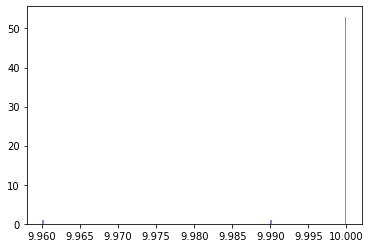

In [33]:
Index = reduced_set_df['Index']
np_array = np.array(Index)
num_bins = 200
mu = np_array.mean()
sigma = np_array.std()
n, bins, patches = plt.hist(np_array, num_bins, facecolor='blue', alpha=0.5)
plt.show()

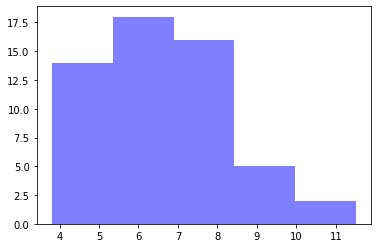

In [34]:
AvgTimeToPark = reduced_set_df['AvgTimeToPark']
np_array = np.array(AvgTimeToPark)
num_bins = 5
mu = np_array.mean()
sigma = np_array.std()
n, bins, patches = plt.hist(np_array, num_bins, facecolor='blue', alpha=0.5)
plt.show()

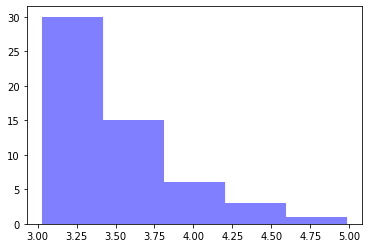

In [35]:
AvgTimeToParkRatio = reduced_set_df['AvgTimeToParkRatio']
np_array = np.array(AvgTimeToParkRatio)
num_bins = 5
mu = np_array.mean()
sigma = np_array.std()
n, bins, patches = plt.hist(np_array, num_bins, facecolor='blue', alpha=0.5)
plt.show()

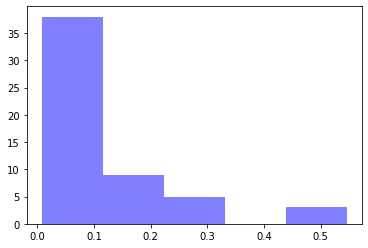

In [36]:
PercentSearching = reduced_set_df['PercentSearching']
np_array = np.array(PercentSearching)
num_bins = 5
mu = np_array.mean()
sigma = np_array.std()
n, bins, patches = plt.hist(np_array, num_bins, facecolor='blue', alpha=0.5)
plt.show()

In [37]:
def get_coordinate_tupples(df):
    longitudes = df['Longitude']
    latitudes = df['Latitude']
    geohashes = df['Geohash']
    tupple_list = list()
    for geohash, lat, lng in zip(geohashes, latitudes, longitudes):
        tupple_list.append((geohash, lat, lng))
    return tupple_list

In [38]:

def get_key_from_index(index, keys): 
    cat_keys = categories.keys()
    if index > 9:
        index = 0
    key = keys[index]
    index = index + 1
    return (index, key)  

In [39]:
radius =1000
categories = {'Arts & Entertainment ':'4d4b7104d754a06370d81259', 
              'College & University':'4d4b7105d754a06372d81259', 
              'Event':'4d4b7105d754a06373d81259', 
              'Food':'4d4b7105d754a06374d81259',
              'Nightlife Spot': '4d4b7105d754a06376d81259',
              'Outdoors & Recreation': '4d4b7105d754a06377d81259',
              'Professional & Other Places': '4d4b7105d754a06375d81259',
              'Residence': '4e67e38e036454776db1fb3a',
              'Shop & Service': '4d4b7105d754a06378d81259',
              'Travel & Transport': '4d4b7105d754a06379d81259'
             }

def store_nearby_venues(tupple_list):
    venues_dictionary = dict()
    for tupple in tupple_list:
        geohash = tupple[0]
        lat = tupple[1]
        lng = tupple[2]
        for key in categories.keys():
            category_id  = categories[key]
            storage_key = geohash + ':' + category_id + ':' + key 
            print(category_id, ' ', geohash)
            nearby_venues_cat = getNearbyVenues(lat,lng, category_id, radius)
            venues_dictionary[storage_key] = nearby_venues_cat
    return venues_dictionary

In [40]:
tupple_list = get_coordinate_tupples(reduced_set_df)

In [41]:
venues_dictionary = store_nearby_venues(tupple_list)
print(len(venues_dictionary))    

4d4b7104d754a06370d81259   dpz893q
4d4b7105d754a06372d81259   dpz893q
4d4b7105d754a06373d81259   dpz893q
4d4b7105d754a06374d81259   dpz893q
4d4b7105d754a06376d81259   dpz893q
4d4b7105d754a06377d81259   dpz893q
4d4b7105d754a06375d81259   dpz893q
4e67e38e036454776db1fb3a   dpz893q
4d4b7105d754a06378d81259   dpz893q
4d4b7105d754a06379d81259   dpz893q
4d4b7104d754a06370d81259   dpz2kdu
4d4b7105d754a06372d81259   dpz2kdu
4d4b7105d754a06373d81259   dpz2kdu
4d4b7105d754a06374d81259   dpz2kdu
4d4b7105d754a06376d81259   dpz2kdu
4d4b7105d754a06377d81259   dpz2kdu
4d4b7105d754a06375d81259   dpz2kdu
4e67e38e036454776db1fb3a   dpz2kdu
4d4b7105d754a06378d81259   dpz2kdu
4d4b7105d754a06379d81259   dpz2kdu
4d4b7104d754a06370d81259   dpz2xvp
4d4b7105d754a06372d81259   dpz2xvp
4d4b7105d754a06373d81259   dpz2xvp
4d4b7105d754a06374d81259   dpz2xvp
4d4b7105d754a06376d81259   dpz2xvp
4d4b7105d754a06377d81259   dpz2xvp
4d4b7105d754a06375d81259   dpz2xvp
4e67e38e036454776db1fb3a   dpz2xvp
4d4b7105d754a06378d8

4d4b7105d754a06377d81259   dpz2v4p
4d4b7105d754a06375d81259   dpz2v4p
4e67e38e036454776db1fb3a   dpz2v4p
4d4b7105d754a06378d81259   dpz2v4p
4d4b7105d754a06379d81259   dpz2v4p
4d4b7104d754a06370d81259   dpz895n
4d4b7105d754a06372d81259   dpz895n
4d4b7105d754a06373d81259   dpz895n
4d4b7105d754a06374d81259   dpz895n
4d4b7105d754a06376d81259   dpz895n
4d4b7105d754a06377d81259   dpz895n
4d4b7105d754a06375d81259   dpz895n
4e67e38e036454776db1fb3a   dpz895n
4d4b7105d754a06378d81259   dpz895n
4d4b7105d754a06379d81259   dpz895n
4d4b7104d754a06370d81259   dpz8974
4d4b7105d754a06372d81259   dpz8974
4d4b7105d754a06373d81259   dpz8974
4d4b7105d754a06374d81259   dpz8974
4d4b7105d754a06376d81259   dpz8974
4d4b7105d754a06377d81259   dpz8974
4d4b7105d754a06375d81259   dpz8974
4e67e38e036454776db1fb3a   dpz8974
4d4b7105d754a06378d81259   dpz8974
4d4b7105d754a06379d81259   dpz8974
4d4b7104d754a06370d81259   dpz82sh
4d4b7105d754a06372d81259   dpz82sh
4d4b7105d754a06373d81259   dpz82sh
4d4b7105d754a06374d8

4d4b7104d754a06370d81259   dpz90fe
4d4b7105d754a06372d81259   dpz90fe
4d4b7105d754a06373d81259   dpz90fe
4d4b7105d754a06374d81259   dpz90fe
4d4b7105d754a06376d81259   dpz90fe
4d4b7105d754a06377d81259   dpz90fe
4d4b7105d754a06375d81259   dpz90fe
4e67e38e036454776db1fb3a   dpz90fe
4d4b7105d754a06378d81259   dpz90fe
4d4b7105d754a06379d81259   dpz90fe
4d4b7104d754a06370d81259   dpz2pqw
4d4b7105d754a06372d81259   dpz2pqw
4d4b7105d754a06373d81259   dpz2pqw
4d4b7105d754a06374d81259   dpz2pqw
4d4b7105d754a06376d81259   dpz2pqw
4d4b7105d754a06377d81259   dpz2pqw
4d4b7105d754a06375d81259   dpz2pqw
4e67e38e036454776db1fb3a   dpz2pqw
4d4b7105d754a06378d81259   dpz2pqw
4d4b7105d754a06379d81259   dpz2pqw
4d4b7104d754a06370d81259   dpz8ekz
4d4b7105d754a06372d81259   dpz8ekz
4d4b7105d754a06373d81259   dpz8ekz
4d4b7105d754a06374d81259   dpz8ekz
4d4b7105d754a06376d81259   dpz8ekz
4d4b7105d754a06377d81259   dpz8ekz
4d4b7105d754a06375d81259   dpz8ekz
4e67e38e036454776db1fb3a   dpz8ekz
4d4b7105d754a06378d8

In [42]:
for key in venues_dictionary.keys():
    print(key)
    display(venues_dictionary[key])

dpz893q:4d4b7104d754a06370d81259:Arts & Entertainment 


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Cineplex Entertainment - Head Office,43.684314,-79.392285,Movie Theater
1,Andrew Freedom Road,43.690156,-79.390726,Music Venue
2,Skyrims Movie Room,43.687683,-79.391580,Movie Theater
3,tarragon,43.688652,-79.393678,Theater
4,Tunnel of Glam,43.689242,-79.394352,Art Gallery
5,Kaghaz Rangi,43.689002,-79.394745,Art Gallery
6,Your Radio,43.688915,-79.394885,Music Venue
7,Toronto Chamber Choir,43.690963,-79.395103,Music Venue
8,Woodlawn Pottery Studio,43.684445,-79.389843,Art Gallery
9,Cineplex Office,43.684700,-79.392856,Movie Theater


dpz893q:4d4b7105d754a06372d81259:College & University


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Deer Park Public School,43.689241,-79.391619,College Academic Building
1,English School of Canada,43.688486,-79.391119,College Classroom
2,University of Bahcesehir Campus Toronto,43.697136,-79.392708,College Academic Building
3,Academy Of Design And Technology,43.696640,-79.396000,General College & University
4,Paige Property Inc.,43.694522,-79.399056,College Administrative Building


dpz893q:4d4b7105d754a06373d81259:Event


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,On My Way to Steal Yo Girl,43.692884,-79.379219,Parade


dpz893q:4d4b7105d754a06374d81259:Food


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,9bars,43.688660,-79.391940,Café
1,The Bagel House,43.687374,-79.393696,Bagel Shop
2,Capocaccia Café,43.685915,-79.393305,Italian Restaurant
3,Cava Restaurant,43.689809,-79.394932,Tapas Restaurant
4,Union Social Eatery,43.687895,-79.394916,American Restaurant
5,kibo sushi house,43.682727,-79.392270,Sushi Restaurant
6,nutbar,43.682811,-79.391945,Vegetarian / Vegan Restaurant
7,Sunny Morning Breakfast & Lunch,43.686512,-79.393507,Breakfast Spot
8,Kwan Restaurant,43.688737,-79.394359,Cantonese Restaurant
9,Mary Be Kitchen,43.687708,-79.395062,Restaurant


dpz893q:4d4b7105d754a06376d81259:Nightlife Spot


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Boxcar Social,43.681750,-79.391447,Coffee Shop
1,The Rosedale Diner,43.680448,-79.390816,Wine Bar
2,Fionn MacCool's,43.687921,-79.394783,Pub
3,Bull & Firkin,43.696581,-79.396226,Pub
4,Raiders E-Sports Centre,43.687683,-79.395944,Sports Bar
5,Scallywags,43.687982,-79.394676,Pub
6,Midtown Gastro Hub,43.690035,-79.394853,Gastropub
7,Red Lantern,43.697893,-79.389330,Gastropub
8,Rosehill Venue Lounge,43.686457,-79.393054,Lounge
9,Jester on Yonge,43.687689,-79.393808,Pub


dpz893q:4d4b7105d754a06377d81259:Outdoors & Recreation


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,David A. Balfour Park,43.685629,-79.388078,Park
1,Rosehill Reservoir,43.686304,-79.388133,Park
2,Toronto Lawn Tennis Club,43.680667,-79.388559,Athletics & Sports
3,Moksha Yoga Uptown,43.688799,-79.394484,Yoga Studio
4,Kay Gardner Beltline Trail,43.696452,-79.395313,Trail
5,GoodLife Fitness Toronto Yonge and St Clair,43.688484,-79.393781,Gym
6,GoodLife Fitness,43.689617,-79.394695,Gym
7,Pure Fitness,43.693007,-79.387781,Gym
8,barre3,43.689855,-79.394835,Gym / Fitness Center
9,barre3,43.689855,-79.394835,Gym / Fitness Center


dpz893q:4d4b7105d754a06375d81259:Professional & Other Places


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Rosedale,43.682624,-79.391892,Professional & Other Places
1,Government of Canada,43.688403,-79.391863,Office
2,Weston Centre,43.688651,-79.393151,Office
3,Thornley Fallis,43.688263,-79.393078,Office
4,One St. Clair Ave. East,43.688161,-79.393713,Office
5,2 St. Clair Avenue West,43.688870,-79.394872,Office
6,Boom 97.3 Studio,43.688761,-79.394969,Office
7,National Speakers Bureau,43.688541,-79.395088,Office
8,45 St. Clair,43.687844,-79.395418,Office
9,40 St. Clair,43.687917,-79.395665,Office


dpz893q:4e67e38e036454776db1fb3a:Residence


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Summerhill Properties - The Summerhill,43.684654,-79.391828,Residential Building (Apartment / Condo)
1,Bretton Place,43.686021,-79.391633,Residential Building (Apartment / Condo)
2,South Algiers,43.688154,-79.401327,Residential Building (Apartment / Condo)
3,Angus House,43.698014,-79.387920,Residential Building (Apartment / Condo)
4,CAPREIT Toronto Apartments - 1 Oriole Road,43.687081,-79.400096,Building


dpz893q:4d4b7105d754a06378d81259:Shop & Service


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,LCBO,43.681497,-79.391261,Liquor Store
1,Sobeys Urban Fresh St. Clair,43.688479,-79.390769,Grocery Store
2,The Market By Longo’s,43.686711,-79.399536,Supermarket
3,LCBO,43.686991,-79.399238,Liquor Store
4,Shoppers Drug Mart,43.689255,-79.394496,Pharmacy
5,Harvest Wagon,43.680433,-79.390665,Gourmet Shop
6,Room 2046,43.683256,-79.392174,Gift Shop
7,Loblaws,43.688484,-79.393781,Grocery Store
8,The Beer Store,43.680217,-79.390074,Beer Store
9,President's Choice Financial ATM,43.688420,-79.393510,ATM


dpz893q:4d4b7105d754a06379d81259:Travel & Transport


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Toronto Suites,43.693524,-79.396569,Hotel
1,St Clair Subway Station,43.687971,-79.393077,Metro Station
2,Zip-Car,43.690476,-79.393732,Rental Car Location
3,Yonge & St Clair,43.688134,-79.394039,Intersection
4,Zipcar,43.686453,-79.392586,Rental Car Location
5,Zip-Car,43.692440,-79.391670,Rental Car Location
6,TTC Stop #14345,43.688114,-79.394513,Light Rail Station
7,Zip-Car,43.685070,-79.389550,Rental Car Location
8,TTC Stop #8160,43.687089,-79.398159,Light Rail Station
9,Summerhill Subway Station,43.682291,-79.390777,Metro Station


dpz2kdu:4d4b7104d754a06370d81259:Arts & Entertainment 


None

dpz2kdu:4d4b7105d754a06372d81259:College & University


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Canadian Business College,43.652049,-79.601660,General College & University
1,Ontario Safety League,43.659144,-79.599356,College Classroom
2,Queen's Collegiate,43.650847,-79.601693,College Administrative Building
3,Crestron Technical Institute,43.656677,-79.610867,Trade School


dpz2kdu:4d4b7105d754a06373d81259:Event


None

dpz2kdu:4d4b7105d754a06374d81259:Food


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Prince Japanese Steakhouse,43.648952,-79.605052,Japanese Restaurant
1,Bravo Bistro,43.659420,-79.603604,Eastern European Restaurant
2,Plaka restaurant,43.659419,-79.601647,Greek Restaurant
3,Chaska Indian Street Food Obsession,43.655242,-79.606706,Indian Restaurant
4,Subway,43.655196,-79.606886,Sandwich Place
5,Palmyra,43.648888,-79.605434,Mediterranean Restaurant
6,Mickele's Ristorante,43.653287,-79.600563,Italian Restaurant
7,La Scala,43.660501,-79.600557,Italian Restaurant
8,FiAMMA Ristorante,43.648504,-79.605272,Italian Restaurant
9,Mr.Sub,43.650033,-79.604657,Restaurant


dpz2kdu:4d4b7105d754a06376d81259:Nightlife Spot


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,The Irish Shebeen Pub,43.650172,-79.604177,Pub
1,Orbit Cafe,43.650500,-79.602965,Bar


dpz2kdu:4d4b7105d754a06377d81259:Outdoors & Recreation


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Centennial Park Golf Centre,43.649285,-79.597661,Golf Course
1,Diamond Beach,43.651455,-79.591757,Baseball Field
2,Anytime Fitness,43.650820,-79.605460,Gym / Fitness Center
3,Etobicoke Creek Trail,43.649288,-79.605176,Trail
4,Max Ward Park,43.656997,-79.607393,Baseball Field
5,Batting Cages at Centennial Park,43.651694,-79.591682,Baseball Field


dpz2kdu:4d4b7105d754a06375d81259:Professional & Other Places


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,"Regus - Ontario, Mississauga - Toronto Airport...",43.657400,-79.604000,Business Service
1,The Explorer Group,43.656071,-79.602664,Office
2,Brand Momentum,43.656620,-79.598751,Office
3,Orbitor Studio,43.657535,-79.601512,Office
4,Ericsson Canada,43.657300,-79.603298,Office
5,AVW-TELAV,43.656621,-79.604946,Office
6,Sal Guzzo LL B Professional Corporation,43.658026,-79.598662,Office
7,Remco,43.658146,-79.602349,Office
8,Brand Momentum,43.659130,-79.599861,Office
9,PepsiCo Headquarters,43.655950,-79.608636,Office


dpz2kdu:4e67e38e036454776db1fb3a:Residence


None

dpz2kdu:4d4b7105d754a06378d81259:Shop & Service


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,WIND Mobile,43.652317,-79.602741,Electronics Store
1,CBCI Telecom Canada,43.656200,-79.599400,Electronics Store
2,WOODSTOCK TRADING COMPANY INC.,43.657407,-79.603430,Warehouse Store
3,"Regus - Ontario, Mississauga - Toronto Airport...",43.657400,-79.604000,Business Service
4,Cariati Law,43.658212,-79.597945,Lawyer
5,Match Marketing Group,43.656276,-79.609401,Business Service
6,Baka Communications,43.656630,-79.591230,Electronics Store
7,Newton Brother's Company,43.661878,-79.600286,Clothing Store
8,Druxy's Famous Deli,43.658261,-79.611171,Food Service


dpz2kdu:4d4b7105d754a06379d81259:Travel & Transport


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,TownePlace Suites Mississauga-Airport Corporat...,43.655975,-79.599997,Hotel
1,Best Western Plus Travel Hotel Toronto Airport,43.653043,-79.600593,Hotel
2,Homewood Suites by Hilton,43.652366,-79.601291,Hotel
3,Homewood Suites by Hilton Toronto Airport Corp...,43.652438,-79.601118,Hotel
4,Spectrum Transitway Station,43.649129,-79.606499,Bus Station


dpz2xvp:4d4b7104d754a06370d81259:Arts & Entertainment 


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Joseph D Carrier Art Gallery,43.712252,-79.455994,Art Gallery
1,Full Out Dance Competition,43.715199,-79.452356,Dance Studio
2,Denison Gallery,43.703701,-79.452553,Art Gallery
3,Danceology,43.701378,-79.452846,Dance Studio


dpz2xvp:4d4b7105d754a06372d81259:College & University


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Fieldstone Day School,43.712409,-79.453894,General College & University
1,Medix College - Toronto,43.717268,-79.448147,Medical School


dpz2xvp:4d4b7105d754a06373d81259:Event


None

dpz2xvp:4d4b7105d754a06374d81259:Food


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Columbus Colombian Bakery (Panaderia Colombiana),43.709173,-79.453331,Latin American Restaurant
1,Harvey's,43.715413,-79.455296,Fast Food Restaurant
2,Krystos,43.718516,-79.455855,Greek Restaurant
3,Mary Brown's Famous Chicken,43.718309,-79.455706,Fried Chicken Joint
4,Swiss Chalet Rotisserie & Grill,43.717214,-79.456116,Restaurant
5,Burger King,43.714210,-79.456396,Fast Food Restaurant
6,Miyako Sushi Restaurant,43.709111,-79.443930,Japanese Restaurant
7,Darosa,43.706970,-79.453121,Mediterranean Restaurant
8,Camarra's Pizzeria & Restaurant,43.708329,-79.453488,Pizza Place
9,McDonald's,43.704899,-79.452393,Fast Food Restaurant


dpz2xvp:4d4b7105d754a06376d81259:Nightlife Spot


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Playtime Bowl,43.717427,-79.458148,Bowling Alley
1,Schueys Bar And Grill,43.704269,-79.452421,Bar
2,Hookah bar,43.707802,-79.443284,Hookah Bar


dpz2xvp:4d4b7105d754a06377d81259:Outdoors & Recreation


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Columbus Centre,43.713012,-79.456487,Gym
1,Sgt. Splatter’s Project Paintball,43.703290,-79.455914,Paintball Field
2,Adrenalin Fitness,43.705790,-79.455548,Gym / Fitness Center
3,Fit4less,43.716687,-79.447473,Gym
4,Fit4Less,43.716656,-79.447257,Gym
5,GoodLife Fitness,43.716884,-79.446838,Gym / Fitness Center
6,Caledonia Park,43.712583,-79.465217,Park


dpz2xvp:4d4b7105d754a06375d81259:Professional & Other Places


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Aden Earth HQ,43.714232,-79.454370,Office
1,Olympia Tile and Stone,43.713162,-79.460464,Building
2,Index Exchange,43.702963,-79.457820,Office
3,750 Lawrence Avenue West,43.715561,-79.449597,Building
4,StyleDemocracy,43.701871,-79.454284,Office
5,Denneboom,43.702744,-79.459275,Office
6,151 Yonge Street,43.718601,-79.455388,Office
7,Dante Alighieri Academy,43.710531,-79.458580,High School
8,Toronto Medical Associates,43.713759,-79.457384,Doctor's Office
9,West Toronto Physiotherapy and Rehabilitation ...,43.713849,-79.457556,Physical Therapist


dpz2xvp:4e67e38e036454776db1fb3a:Residence


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,437 Glen Park Ave.,43.707488,-79.455342,Residential Building (Apartment / Condo)


dpz2xvp:4d4b7105d754a06378d81259:Shop & Service


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Lady York Foods,43.709445,-79.452979,Grocery Store
1,PetSmart,43.716544,-79.445926,Pet Store
2,City Fish Market,43.709105,-79.453660,Fish Market
3,ARD Outdoor,43.712402,-79.454262,Furniture / Home Store
4,Staples,43.716931,-79.456472,Paper / Office Supplies Store
5,Pauline Books & Media,43.712498,-79.454806,Bookstore
6,Creative Silhouettes Inc.,43.706856,-79.453644,Print Shop
7,Tasco,43.713335,-79.454245,Furniture / Home Store
8,Franco Private Investigation Services,43.706016,-79.452964,Business Service
9,Sleep Country,43.713749,-79.454218,Mattress Store


dpz2xvp:4d4b7105d754a06379d81259:Travel & Transport


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Enterprise Rent-A-Car,43.706440,-79.452560,Rental Car Location
1,Harbour Star Boat Cruise,43.718114,-79.450235,Moving Target


dpz87wq:4d4b7104d754a06370d81259:Arts & Entertainment 


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,The Fox Theatre,43.672801,-79.287272,Indie Movie Theater
1,Beaches International Jazz Festival,43.669992,-79.300348,Jazz Club
2,Alyona Dance Studio,43.671408,-79.291559,Dance Studio
3,Studio 888,43.672264,-79.288910,Art Gallery
4,Lens Factory,43.671987,-79.290421,Art Gallery
5,For The Love Of It School Of Dance,43.671067,-79.292366,Dance Studio
6,St-Denis Studios Inc.,43.675031,-79.288022,Music Venue
7,Lens Factory,43.670869,-79.296308,Art Gallery
8,The Floating Ropes,43.667666,-79.293502,Exhibit
9,Beach Dance School,43.673816,-79.282301,Dance Studio


dpz87wq:4d4b7105d754a06372d81259:College & University


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Glen Ames Swimming Pool,43.674623,-79.298152,General College & University
1,Notre Dame Highschool,43.680734,-79.293309,Student Center
2,Beaches Rec Centre,43.673659,-79.298634,College Gym


dpz87wq:4d4b7105d754a06373d81259:Event


None

dpz87wq:4d4b7105d754a06374d81259:Food


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Tori's Bakeshop,43.672114,-79.290331,Vegetarian / Vegan Restaurant
1,Bagels On Fire,43.672864,-79.286784,Bagel Shop
2,Beacher Cafe,43.671938,-79.291238,Breakfast Spot
3,Veloute Bistro,43.672267,-79.289584,French Restaurant
4,Xola,43.672603,-79.288080,Mexican Restaurant
5,Vi Vetha,43.673720,-79.282155,Breakfast Spot
6,The Beech Tree,43.680493,-79.288846,Gastropub
7,Isabella’s Boutique Restaurant,43.673767,-79.282703,Japanese Restaurant
8,Beaches Bake Shop,43.680363,-79.289692,Bakery
9,Delhi Bistro,43.672506,-79.288353,Indian Restaurant


dpz87wq:4d4b7105d754a06376d81259:Nightlife Spot


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,The Beech Tree,43.680493,-79.288846,Gastropub
1,Castro's Lounge,43.671104,-79.295107,Bar
2,The Fill Station,43.673256,-79.284943,Pub
3,The Feathers Pub,43.680570,-79.287473,Pub
4,Outrigger Tap & Table,43.672761,-79.287764,Pub
5,The Loop,43.680479,-79.287251,Bar
6,Gabby's Food & Fuel,43.670809,-79.296657,Bar
7,Grover Pub and Grub,43.679181,-79.297215,Pub
8,Honey's Beestro,43.672730,-79.287874,Gastropub
9,Fitzgerald's,43.673583,-79.284057,Pub


dpz87wq:4d4b7105d754a06377d81259:Outdoors & Recreation


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,I'm On The Beach,43.670364,-79.284696,Beach
1,Balmy Beach,43.668169,-79.291355,Beach
2,Kew Gardens,43.669038,-79.298538,Park
3,Kew-Balmy Beach,43.667372,-79.295312,Beach
4,Glen Manor Ravine,43.676821,-79.293942,Trail
5,Kew Gardens Play Park,43.669267,-79.299684,Park
6,Kew Beach Off Leash Dog Park,43.665815,-79.296988,Dog Run
7,Ivan Forrest Gardens,43.671669,-79.292573,Park
8,SUPgirlz,43.668989,-79.290476,Scenic Lookout
9,Balsam Beach,43.669035,-79.289076,Beach


dpz87wq:4d4b7105d754a06375d81259:Professional & Other Places


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Top Drawer Creative,43.672591,-79.288350,Office
1,Haverkate & Associates,43.671985,-79.291098,Office
2,Divorce Magazine,43.671364,-79.294810,Office
3,CAPREIT Toronto Apartments - 3000 Queen Street...,43.666820,-79.282890,Building
4,RBC Royal Bank,43.680556,-79.288433,Office
5,R. C. Harris Water Treatment Plant,43.672797,-79.280028,Building
6,Barrett And Welsh,43.678460,-79.299442,Office
7,Balmy Beach Club,43.669964,-79.286481,Club House
8,Toronto Public Library - Beaches Branch,43.670240,-79.298756,Library
9,Dr. Oakey Smith Rhinoplasty,43.672177,-79.289013,Doctor's Office


dpz87wq:4e67e38e036454776db1fb3a:Residence


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,CAPREIT Toronto Apartments - 3000 Queen Street...,43.66682,-79.28289,Building


dpz87wq:4d4b7105d754a06378d81259:Shop & Service


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Mastermind Toys,43.671453,-79.293971,Toy / Game Store
1,The Big Carrot Natural Food Market,43.678879,-79.297734,Health Food Store
2,LCBO,43.669993,-79.300383,Liquor Store
3,Foodland - Toronto,43.670736,-79.298267,Grocery Store
4,Coles,43.670454,-79.298094,Bookstore
5,The Nutty Chocolatier,43.670567,-79.297598,Chocolate Shop
6,Shoppers Drug Mart,43.670639,-79.297690,Pharmacy
7,BeachMac (Beach Mac),43.672128,-79.290139,Electronics Store
8,Pet Valu,43.672517,-79.288923,Pet Store
9,Essentia @ The Beach,43.672093,-79.290648,Furniture / Home Store


dpz87wq:4d4b7105d754a06379d81259:Travel & Transport


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Neville Park Streetcar Loop,43.674553,-79.279695,Light Rail Station
1,Zip-Car,43.678699,-79.298907,Rental Car Location


dpz83w3:4d4b7104d754a06370d81259:Arts & Entertainment 


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Japan Foundation,43.670609,-79.386011,Art Gallery
1,DanceLifeX Centre,43.666956,-79.385297,Dance Studio
2,Masonic Temple,43.672819,-79.388028,Music Venue
3,Royal Ontario Museum,43.668367,-79.394813,Museum
4,CAA Theatre,43.667960,-79.385618,Theater
5,Gardiner Museum,43.668009,-79.393334,Art Museum
6,Cineplex Odeon Varsity & VIP Cinemas,43.668988,-79.389061,Movie Theater
7,MTV Canada,43.672853,-79.388043,Music Venue
8,TD Gallery at the Toronto Reference Library,43.671658,-79.386952,Art Gallery
9,BDX Dance Studio,43.672598,-79.387735,Dance Studio


dpz83w3:4d4b7105d754a06372d81259:College & University


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,"ILAC High Advanced, University Level Building",43.671224,-79.386939,College & University
1,Connect,43.673290,-79.388017,General College & University
2,St. Michael's College,43.666559,-79.389744,University
3,Marvel Beauty School,43.671375,-79.388666,General College & University
4,ILAC - International Language Academy of Canada,43.674107,-79.388939,General College & University
5,Victoria College,43.666961,-79.391608,University
6,ILAC Cumberland,43.670766,-79.388945,College Classroom
7,EmbassyCES,43.669694,-79.390235,College Academic Building
8,University at St. Michael's College,43.665711,-79.389909,University
9,EF Education First,43.669883,-79.389095,General College & University


dpz83w3:4d4b7105d754a06373d81259:Event


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,BartenderOne Divine Wine Workshop,43.670194,-79.388787,Conference
1,林俊杰的被窝里,43.668532,-79.383661,Conference
2,Toronto Fashion Week - Royal Ontario Museum,43.667858,-79.393780,Festival
3,Village Pub Crawl,43.664463,-79.380424,Street Fair


dpz83w3:4d4b7105d754a06374d81259:Food


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Sabai Sabai,43.670647,-79.384857,Thai Restaurant
1,Blu Ristorante and Lounge,43.671685,-79.388614,Italian Restaurant
2,Chick-Fil-A,43.669515,-79.386190,American Restaurant
3,Paramount Fine Foods,43.670677,-79.389865,Middle Eastern Restaurant
4,Buca,43.671917,-79.389236,Italian Restaurant
5,Trattoria Nervosa,43.671019,-79.391081,Italian Restaurant
6,Pi Co.,43.670107,-79.389852,Pizza Place
7,The Salad House,43.669508,-79.386061,Mediterranean Restaurant
8,Black Camel,43.677016,-79.389367,BBQ Joint
9,Salad Days,43.670993,-79.387860,Salad Place


dpz83w3:4d4b7105d754a06376d81259:Nightlife Spot


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,dbar,43.671483,-79.389936,Lounge
1,Wish,43.668759,-79.385694,Restaurant
2,Storm Crow Manor,43.666840,-79.381593,Theme Restaurant
3,The Oxley Public House,43.670537,-79.392977,Gastropub
4,Rebel House,43.677661,-79.389935,Bar
5,The Keg Steakhouse + Bar - Keg Mansion,43.666756,-79.378302,Steakhouse
6,Wickson Social,43.665905,-79.385720,Gastropub
7,Brothers Restaurant,43.670421,-79.389793,Restaurant
8,Momentos,43.671092,-79.391685,Nightclub
9,ONE Restaurant/Lounge,43.670809,-79.393272,New American Restaurant


dpz83w3:4d4b7105d754a06377d81259:Outdoors & Recreation


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,GoodLife Fitness Toronto Bloor and Park,43.671302,-79.384691,Gym
1,Ramsden Park,43.676068,-79.389705,Park
2,889 Yoga,43.674435,-79.388485,Yoga Studio
3,Catalyst Health,43.670753,-79.392204,Gym / Fitness Center
4,Bikram Yoga Yonge,43.668205,-79.385780,Yoga Studio
5,Barbara Hall Park,43.666879,-79.381068,Park
6,Village of Yorkville Park,43.670186,-79.391180,Park
7,Equinox Yorkville,43.671220,-79.394963,Gym
8,Toronto Lawn Tennis Club,43.680667,-79.388559,Athletics & Sports
9,Hone Fitness,43.667484,-79.385510,Gym


dpz83w3:4d4b7105d754a06375d81259:Professional & Other Places


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Salon Escape,43.670047,-79.392196,Salon / Barbershop
1,Salon Solis,43.668356,-79.385921,Salon / Barbershop
2,Manulife Financial,43.672070,-79.382449,Office
3,Royal Ontario Museum - ROM Governors,43.668226,-79.393801,Office
4,Forest Hill Real Estate Inc. Yorkville,43.671597,-79.393559,Office
5,ISX (International Student Exchange),43.671587,-79.387540,Office
6,Unilever Canada HQ,43.671074,-79.383240,Office
7,2 Bloor Street East,43.670748,-79.386755,Office
8,2 Bloor Street West,43.670777,-79.386968,Office
9,Easy Group Inc,43.670374,-79.385662,Office


dpz83w3:4e67e38e036454776db1fb3a:Residence


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Four Seasons Hotel Toronto,43.671796,-79.389457,Hotel
1,Windsor Arms Hotel,43.668781,-79.390850,Hotel
2,Signatures on Bloor,43.670293,-79.385233,Residential Building (Apartment / Condo)
3,One Bloor,43.670417,-79.386341,Residential Building (Apartment / Condo)
4,18 Yorkville,43.671933,-79.388507,Residential Building (Apartment / Condo)
5,8 Park Road,43.671260,-79.385499,Office
6,Residences On Bloor,43.671004,-79.380529,Residential Building (Apartment / Condo)
7,Chaz Yorkville,43.669027,-79.384044,Residential Building (Apartment / Condo)
8,28 Ted Rogers Way,43.670681,-79.380695,Residential Building (Apartment / Condo)
9,Couture Condominium,43.670682,-79.380696,Residential Building (Apartment / Condo)


dpz83w3:4d4b7105d754a06378d81259:Shop & Service


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Page & Panel: The TCAF Shop,43.671653,-79.387141,Comic Shop
1,Kitchen Stuff Plus,43.671191,-79.386955,Furniture / Home Store
2,Anthropologie,43.671074,-79.391123,Women's Store
3,Pusateri's Fine Foods,43.671275,-79.390142,Gourmet Shop
4,Toronto Hemp Company,43.668419,-79.385848,Smoke Shop
5,Indigo,43.669065,-79.389057,Bookstore
6,Fiorio Hair Design,43.670170,-79.391400,Cosmetics Shop
7,Bloor-Yorkville,43.670214,-79.391047,Shopping Mall
8,COS,43.669516,-79.390390,Clothing Store
9,Harry Rosen Menswear,43.669661,-79.390585,Men's Store


dpz83w3:4d4b7105d754a06379d81259:Travel & Transport


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Four Seasons Hotel Toronto,43.671796,-79.389457,Hotel
1,The Anndore House,43.668801,-79.385413,Hotel
2,The Hazelton Hotel,43.670764,-79.393257,Hotel
3,Windsor Arms Hotel,43.668781,-79.390850,Hotel
4,Town Inn Suites,43.669056,-79.382573,Hotel
5,Isabella Hotel,43.670098,-79.375983,Hotel
6,Downtown Inn,43.666997,-79.381083,Bed & Breakfast
7,Zipcar,43.671299,-79.385203,Rental Car Location
8,Hertz,43.670998,-79.384489,Rental Car Location
9,Enterprise Rent-A-Car,43.671075,-79.385792,Rental Car Location


dpz2pr7:4d4b7104d754a06370d81259:Arts & Entertainment 


None

dpz2pr7:4d4b7105d754a06372d81259:College & University


None

dpz2pr7:4d4b7105d754a06373d81259:Event


None

dpz2pr7:4d4b7105d754a06374d81259:Food


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Cheese Boutique,43.638466,-79.475258,Deli / Bodega
1,Roccos Plum Tomato,43.630335,-79.485012,Italian Restaurant
2,U-Know Sushi,43.630326,-79.485386,Sushi Restaurant
3,krazy roll,43.625837,-79.477113,Sushi Restaurant
4,Eden Trattoria,43.627035,-79.476776,Italian Restaurant
5,Subway,43.630278,-79.482737,Sandwich Place
6,Popeyes Louisiana Kitchen,43.627176,-79.487990,Fried Chicken Joint
7,Pizza Pizza,43.629913,-79.481457,Pizza Place
8,KFC,43.630603,-79.484482,Fast Food Restaurant
9,Wok Terminal,43.630631,-79.484513,Chinese Restaurant


dpz2pr7:4d4b7105d754a06376d81259:Nightlife Spot


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,firkin on the bay,43.626584,-79.476959,Bar
1,Rustic Social House,43.630038,-79.476492,Bar
2,Palace Pier Rooftop Club,43.631465,-79.474434,Cocktail Bar


dpz2pr7:4d4b7105d754a06377d81259:Outdoors & Recreation


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Humber Bay Arch Bridge,43.632078,-79.471091,Scenic Lookout
1,Humber Bay Shores Park,43.627282,-79.476620,Park
2,Sheldon Lookout Rock,43.630846,-79.470911,Scenic Lookout
3,Basketball Court,43.632604,-79.474901,Basketball Court
4,Newport beach,43.629587,-79.476851,Beach
5,NXT 2 Gym,43.636218,-79.471067,Gym / Fitness Center
6,Humber Marshes,43.635353,-79.470380,Park
7,NXT Condo Gym,43.636120,-79.470463,Gym / Fitness Center
8,Windermere Roundabout,43.642310,-79.478180,Park


dpz2pr7:4d4b7105d754a06375d81259:Professional & Other Places


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,InfraBiz Inc.,43.626966,-79.478488,Business Service
1,Palace Pier,43.631477,-79.474434,Building
2,Yenius Interactive Marketing,43.637147,-79.472136,Office
3,VINYL WINDOWS PROFESSIONALS,43.638996,-79.473504,Building
4,Renopoint Inc. General Contracting,43.630484,-79.491856,Office
5,103 The Queensway,43.636272,-79.470627,Building
6,Midwife alliance,43.630315,-79.485161,Maternity Clinic
7,Lakeshore West Medical Centre,43.630155,-79.477356,Medical Center


dpz2pr7:4e67e38e036454776db1fb3a:Residence


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,2119 Lake Shore Blvd,43.627177,-79.478673,Residential Building (Apartment / Condo)
1,NXT Condos,43.636120,-79.471030,Residential Building (Apartment / Condo)
2,Waterscapes,43.626011,-79.477424,Residential Building (Apartment / Condo)


dpz2pr7:4d4b7105d754a06378d81259:Shop & Service


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,LCBO,43.630094,-79.481985,Liquor Store
1,Pet Valu,43.629905,-79.480825,Pet Store
2,Pier 1 Imports,43.629630,-79.481018,Furniture / Home Store
3,Booster Juice,43.629926,-79.481996,Smoothie Shop
4,Sobeys Queensway,43.630320,-79.481343,Grocery Store
5,Shoppers Drug Mart,43.630576,-79.482273,Pharmacy
6,Ontario Food Terminal,43.628728,-79.485815,Farmers Market
7,Beauty Boutique by Shoppers Drug Mart,43.630320,-79.481343,Cosmetics Shop
8,Sobeys Pharmacy Etobicoke,43.630320,-79.481343,Pharmacy
9,Rogers,43.630170,-79.481510,Electronics Store


dpz2pr7:4d4b7105d754a06379d81259:Travel & Transport


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Humber Loop,43.630989,-79.478814,Light Rail Station


dpz2tvw:4d4b7104d754a06370d81259:Arts & Entertainment 


None

dpz2tvw:4d4b7105d754a06372d81259:College & University


None

dpz2tvw:4d4b7105d754a06373d81259:Event


None

dpz2tvw:4d4b7105d754a06374d81259:Food


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Wakame Sushi,43.711507,-79.531797,Japanese Restaurant
1,Jolly II Italian Restaurant,43.711946,-79.531510,Italian Restaurant
2,Subway,43.712418,-79.534819,Sandwich Place
3,Mcdonald's in Walmart,43.714250,-79.553289,Fast Food Restaurant
4,Mr.Sub,43.711033,-79.535338,Sandwich Place
5,Sunset Grill,43.711412,-79.535130,Breakfast Spot
6,Wild Wing,43.710522,-79.534984,Wings Joint
7,Caldense Bakery & Pastries,43.711633,-79.532580,Bakery
8,McDonald's,43.711581,-79.535074,Fast Food Restaurant


dpz2tvw:4d4b7105d754a06376d81259:Nightlife Spot


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Ocean 49,43.711637,-79.531633,Bar


dpz2tvw:4d4b7105d754a06377d81259:Outdoors & Recreation


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,GoodLife Fitness North York Weston and 401,43.709610,-79.533425,Gym
1,Pine point tennis club,43.711697,-79.544771,Tennis Court
2,Pine Point Arena,43.712899,-79.542861,Skating Rink
3,Crawford Jones Memorial Park,43.710475,-79.538503,Farm
4,Pine Point Park,43.716775,-79.542775,Park
5,Stewie,43.716978,-79.535197,Campground
6,Weston Oak Tree,43.705748,-79.548172,Scenic Lookout
7,Strathburn Park,43.711500,-79.531280,Baseball Field


dpz2tvw:4d4b7105d754a06375d81259:Professional & Other Places


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Theodore & Pringle Optical in Real Canadian Su...,43.710187,-79.533775,Eye Doctor
1,GoodLife Fitness North York Weston and 401,43.709610,-79.533425,Gym
2,Pine Point Arena,43.712899,-79.542861,Skating Rink
3,Ministry of the Environment,43.710261,-79.542900,Government Building
4,Toronto Public Health,43.710170,-79.545578,Medical Lab
5,Weston Road Medical Clinic,43.710208,-79.534512,Doctor's Office


dpz2tvw:4e67e38e036454776db1fb3a:Residence


None

dpz2tvw:4d4b7105d754a06378d81259:Shop & Service


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,LCBO,43.712703,-79.531550,Liquor Store
1,The Beer Store,43.711702,-79.534393,Beer Store
2,Real Canadian Superstore,43.708390,-79.533897,Grocery Store
3,Best Buy,43.711281,-79.532298,Electronics Store
4,Psidhu OPC,43.710688,-79.535207,Optical Shop
5,Crossroads Plaza,43.711656,-79.534507,Shopping Mall
6,Pet Valu,43.710889,-79.534583,Pet Store
7,Reitmans,43.712350,-79.533130,Women's Store
8,Walmart,43.714226,-79.553293,Big Box Store
9,Joe Fresh,43.709610,-79.533425,Clothing Store


dpz2tvw:4d4b7105d754a06379d81259:Travel & Transport


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Hwy 401 at Weston Rd.,43.713362,-79.536114,Intersection
1,Enterprise Rent-A-Car,43.711357,-79.535517,Rental Car Location
2,Hwy 401 at Islington,43.709295,-79.552185,Intersection


dpz8bzu:4d4b7104d754a06370d81259:Arts & Entertainment 


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Toronto Centre for the Arts,43.766228,-79.414115,Theater
1,Cineplex Cinemas Empress Walk,43.768625,-79.412613,Movie Theater
2,Gibson House Museum,43.770311,-79.412972,History Museum
3,Toronto Dance Salsa,43.768559,-79.412618,Dance Studio
4,Cardinal Carter Theatre,43.763999,-79.409600,Theater
5,Sunset Dance Art,43.761331,-79.410918,Dance Studio


dpz8bzu:4d4b7105d754a06372d81259:College & University


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Yamaha Music School,43.767693,-79.412355,College Classroom
1,Upper Madison College,43.767627,-79.412364,Student Center
2,Tdsb head office,43.767311,-79.412675,College Administrative Building
3,Toronto District School Board,43.766030,-79.410864,College Administrative Building
4,Toronto catholic District School Board,43.763459,-79.407885,College Administrative Building


dpz8bzu:4d4b7105d754a06373d81259:Event


None

dpz8bzu:4d4b7105d754a06374d81259:Food


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Konjiki Ramen,43.766998,-79.412222,Ramen Restaurant
1,The Keg,43.766579,-79.412131,Steakhouse
2,The Captain's Boil,43.773255,-79.413805,Seafood Restaurant
3,Aroma Espresso Bar,43.769449,-79.413081,Café
4,Satay Sate,43.766690,-79.412100,Indonesian Restaurant
5,Sushi Moto Sake & Wine Bar,43.763902,-79.411559,Sushi Restaurant
6,MYMY Chicken,43.764658,-79.411096,Fried Chicken Joint
7,Wako Sushi + Bar,43.770806,-79.413138,Japanese Restaurant
8,Pastel Creperie & Dessert House,43.776219,-79.414648,Creperie
9,Bake Code 烘焙密碼,43.763969,-79.411641,Bakery


dpz8bzu:4d4b7105d754a06376d81259:Nightlife Spot


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Wako Sushi + Bar,43.770806,-79.413138,Japanese Restaurant
1,Dakgogi,43.773010,-79.413875,Korean Restaurant
2,Symposium Cafe Restaurant & Lounge,43.771075,-79.413396,Restaurant
3,Union Social Eatery,43.763797,-79.411358,Restaurant
4,St. Louis Bar & Grill,43.773040,-79.413771,Sports Bar
5,Aura,43.766013,-79.410813,Lounge
6,Nomé Izakaya,43.762559,-79.411440,Japanese Restaurant
7,Aburi Room,43.769197,-79.414039,Sushi Restaurant
8,한바탕 (Han Ba Tang) (Han Ba Tang),43.762910,-79.411408,Bar
9,Studio Lounge Karaoke,43.763929,-79.411530,Karaoke Bar


dpz8bzu:4d4b7105d754a06377d81259:Outdoors & Recreation


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Mel Lastman Square,43.767701,-79.412975,Plaza
1,GoodLife Fitness North York Madison Centre,43.764836,-79.412709,Gym
2,Douglas Snow Aquatic Centre,43.767317,-79.414982,Pool
3,Moksha Yoga North York,43.763250,-79.405468,Yoga Studio
4,Fit4Less,43.768238,-79.412714,Gym
5,Gibson Park,43.768906,-79.415474,Park
6,Lee Lifeson Music Park,43.768930,-79.409650,Park
7,Ultima Gym,43.765945,-79.410788,Gym
8,Dempsey Park,43.769991,-79.419037,Park
9,Willowdale Park,43.766148,-79.407495,Park


dpz8bzu:4d4b7105d754a06375d81259:Professional & Other Places


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Jonathan Torch Curly Hair Institute,43.760360,-79.415140,Salon / Barbershop
1,Professional Engineers Ontario,43.761343,-79.412898,Office
2,"Cognizant Office, North York Center",43.768097,-79.412935,Office
3,Deloitte,43.768495,-79.412783,Office
4,Capital One,43.768112,-79.412942,Office
5,Invesco Canada,43.768172,-79.412920,Office
6,Platinum XO,43.765267,-79.410289,Office
7,Warner Bros,43.766671,-79.412272,Office
8,Scotiabank,43.767627,-79.412221,Building
9,Royal Bank Tower,43.765764,-79.412453,Office


dpz8bzu:4e67e38e036454776db1fb3a:Residence


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Empress Plaza II,43.768738,-79.411612,Residential Building (Apartment / Condo)
1,Gibson Square,43.769292,-79.413025,Residential Building (Apartment / Condo)
2,Kingsdale,43.770941,-79.412272,Residential Building (Apartment / Condo)
3,Ultima Tower - North,43.765687,-79.412059,Residential Building (Apartment / Condo)
4,Prelude,43.764324,-79.413240,Residential Building (Apartment / Condo)
5,The Panday Group,43.771493,-79.412023,Furniture / Home Store
6,5 Northtown Way,43.773906,-79.414025,Residential Building (Apartment / Condo)
7,Platinum XO,43.765267,-79.410289,Office
8,2 Forest Laneway,43.763330,-79.409924,Residential Building (Apartment / Condo)
9,4 Forest Laneway,43.762354,-79.410892,Residential Building (Apartment / Condo)


dpz8bzu:4d4b7105d754a06378d81259:Shop & Service


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Loblaws,43.768722,-79.412101,Grocery Store
1,Michaels,43.767245,-79.411974,Arts & Crafts Store
2,Empress Walk,43.768540,-79.412671,Shopping Mall
3,PetSmart,43.769139,-79.412522,Pet Store
4,Metro,43.773950,-79.413476,Supermarket
5,Longo’s Sheppard Centre,43.762221,-79.410762,Grocery Store
6,Whole Foods Market,43.760662,-79.411044,Grocery Store
7,Best Buy,43.768115,-79.412608,Electronics Store
8,Dollarama,43.768722,-79.412101,Discount Store
9,Winners,43.763018,-79.410412,Department Store


dpz8bzu:4d4b7105d754a06379d81259:Travel & Transport


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Novotel Toronto North York,43.768723,-79.414257,Hotel
1,Zip-Car,43.767760,-79.413770,Rental Car Location
2,North York Centre Subway Station,43.767840,-79.412806,Metro Station
3,Enterprise Rent-A-Car,43.768538,-79.413862,Rental Car Location
4,Zip-Car,43.767760,-79.413770,Rental Car Location
5,Zip-Car,43.767760,-79.413770,Rental Car Location
6,Avis Car Rental,43.764796,-79.412264,Rental Car Location
7,Tyrone Airport,43.764917,-79.409930,Airport
8,Olivia's Housing,43.762666,-79.409719,Hotel
9,Sheppard-Yonge Subway Station,43.761906,-79.411609,Metro Station


dpz9jrj:4d4b7104d754a06370d81259:Arts & Entertainment 


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Cougar,43.815048,-79.207749,Exhibit


dpz9jrj:4d4b7105d754a06372d81259:College & University


None

dpz9jrj:4d4b7105d754a06373d81259:Event


None

dpz9jrj:4d4b7105d754a06374d81259:Food


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Subway,43.806805,-79.222515,Sandwich Place
1,Pizza Hut,43.808326,-79.220616,Pizza Place
2,Pizza Pizza,43.806613,-79.221243,Pizza Place
3,McDonald's,43.806375,-79.221588,Fast Food Restaurant
4,Taco Bell,43.806687,-79.220693,Fast Food Restaurant
5,A&W Canada,43.809292,-79.223009,American Restaurant


dpz9jrj:4d4b7105d754a06376d81259:Nightlife Spot


None

dpz9jrj:4d4b7105d754a06377d81259:Outdoors & Recreation


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Malvern Arena,43.808594,-79.216634,Skating Rink
1,Malvern Recreation Centre,43.807954,-79.217085,Gym / Fitness Center
2,Planet Fitness,43.806744,-79.219900,Gym / Fitness Center
3,Telfer park,43.807310,-79.226403,Park


dpz9jrj:4d4b7105d754a06375d81259:Professional & Other Places


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Blessed Mother Teresa Catholic Secondary School,43.809969,-79.214441,High School
1,Mother Teresa Catholic Secondary School,43.810084,-79.216461,High School
2,Toronto Public Library - Malvern Branch,43.808068,-79.216153,Library
3,Malvern Medical Centre,43.808561,-79.219776,Doctor's Office
4,Scarborough Professional Centre,43.808177,-79.220271,Medical Center
5,Canada Post,43.808408,-79.220666,Post Office
6,Corrective Healthcare & Rehabilitation,43.809292,-79.220693,Chiropractor
7,Taibu CHC,43.806450,-79.220209,Medical Center
8,Sheridan Cyrus Dentistry,43.809810,-79.221040,Dentist's Office
9,CML HealthCare,43.809264,-79.221547,Medical Center


dpz9jrj:4e67e38e036454776db1fb3a:Residence


None

dpz9jrj:4d4b7105d754a06378d81259:Shop & Service


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Shoppers Drug Mart,43.809610,-79.222729,Pharmacy
1,Shoppers Drug Mart,43.806489,-79.223024,Pharmacy
2,Francois' No Frills,43.808416,-79.223520,Grocery Store
3,Circle K,43.808097,-79.220449,Convenience Store
4,Rexall,43.809402,-79.220812,Pharmacy
5,The Medicine Shoppe Pharmacy,43.806064,-79.220674,Pharmacy
6,Marks & Spencer,43.809380,-79.223440,Clothing Store
7,Malvern Town Centre,43.806294,-79.221828,Shopping Mall


dpz9jrj:4d4b7105d754a06379d81259:Travel & Transport


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Neilson and crow trail,43.808590,-79.224360,Bus Station
1,TTC Bus #133 - Neilson,43.801772,-79.217761,Bus Stop


dpz8edp:4d4b7104d754a06370d81259:Arts & Entertainment 


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Tent In The Sky Studios,43.699223,-79.288873,Music Venue
1,Children's Peace Theatre,43.698826,-79.295390,Theater
2,Movie Theater,43.687034,-79.283031,Multiplex


dpz8edp:4d4b7105d754a06372d81259:College & University


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Blantyre Public School,43.685218,-79.284008,General College & University
1,"Max the Mutt College of Animation, Art & Design",43.690374,-79.292986,Community College
2,Marca College Of Hair And Esthetics,43.689944,-79.293950,Trade School
3,West Scarborough Neighborhood Community Centre,43.701139,-79.284822,College Rec Center


dpz8edp:4d4b7105d754a06373d81259:Event


None

dpz8edp:4d4b7105d754a06374d81259:Food


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Mayettes Famous Restaurant Filipino food,43.692453,-79.281828,Filipino Restaurant
1,Double Sushi,43.689475,-79.295828,Sushi Restaurant
2,Pizza Pizza,43.689536,-79.295685,Pizza Place
3,Wing Wings chinese food restaurant,43.690897,-79.290089,Chinese Restaurant
4,Halibut House Victoria Park,43.690541,-79.288770,Fish & Chips Shop
5,Subway,43.690425,-79.290553,Sandwich Place
6,Mr Tasty's Drive In,43.689726,-79.293727,Burger Joint
7,Hakka Chopsticks,43.690192,-79.292946,Chinese Restaurant
8,Popeyes Louisiana Kitchen,43.689031,-79.297896,Fried Chicken Joint
9,Burger King,43.690848,-79.288537,Fast Food Restaurant


dpz8edp:4d4b7105d754a06376d81259:Nightlife Spot


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Will And Helm Design,43.695936,-79.290959,Lounge
1,The Low Bar,43.694497,-79.296076,Bar
2,Royal Canadian Legion #9,43.687962,-79.296655,Bar
3,Royal Canadian Legion #11,43.688024,-79.296796,Bar
4,Morgan's,43.685725,-79.286881,Pub


dpz8edp:4d4b7105d754a06377d81259:Outdoors & Recreation


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,LA Fitness,43.690360,-79.291339,Gym / Fitness Center
1,Dentonia Park,43.692809,-79.295533,Park
2,Eldon And Dentonia Park,43.693555,-79.291589,Baseball Field
3,Dentonia Park Golf Course,43.695326,-79.289115,Golf Course
4,Tidal CrossFit,43.690933,-79.284193,Gym
5,Beach Fairway Golf Range,43.688436,-79.286361,Golf Course
6,Warden Woods Dog Park,43.699998,-79.282433,Dog Run


dpz8edp:4d4b7105d754a06375d81259:Professional & Other Places


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Allstate Insurance: Kandasamy Radhakrishna,43.689679,-79.290642,Office
1,Allstate Insurance: Richard Keen Sing Chow,43.689679,-79.290642,Office
2,Allstate Insurance: Christopher Alcober,43.689679,-79.290642,Office
3,Allstate Insurance: Daniel Lunansky,43.689679,-79.290642,Office
4,Allstate Insurance: Toronto Danforth Agency,43.689361,-79.290707,Insurance Office
5,Teesdale Place,43.696195,-79.287596,Building
6,We Build Design,43.695928,-79.295068,Office
7,CAPREIT Toronto Apartments - 75 Eastdale Avenue,43.695092,-79.300045,Building
8,Victoria Park Station - Parking Lot,43.694517,-79.289093,Parking
9,The UPS Store,43.691251,-79.288614,Post Office


dpz8edp:4e67e38e036454776db1fb3a:Residence


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Cambridge Place Apartments,43.693204,-79.287452,Residential Building (Apartment / Condo)
1,Pharmacy Place I,43.699775,-79.284897,Residential Building (Apartment / Condo)
2,CAPREIT Toronto Apartments - 75 Eastdale Avenue,43.695092,-79.300045,Building


dpz8edp:4d4b7105d754a06378d81259:Shop & Service


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,LCBO,43.691295,-79.285971,Liquor Store
1,Staples,43.689660,-79.289451,Paper / Office Supplies Store
2,Dollarama,43.689672,-79.290646,Discount Store
3,Metro,43.690017,-79.288840,Pharmacy
4,Loblaws,43.687910,-79.287134,Grocery Store
5,The Beer Store,43.691645,-79.286508,Beer Store
6,Gateway Newstand,43.694477,-79.289194,Convenience Store
7,Mosquito Toronto,43.692177,-79.291038,Home Service
8,Pesterminate Inc.,43.691479,-79.288010,Home Service
9,FreshCo,43.687780,-79.285483,Grocery Store


dpz8edp:4d4b7105d754a06379d81259:Travel & Transport


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Victoria Park Subway Station,43.694883,-79.288735,Metro Station
1,Enterprise Rent-A-Car,43.691580,-79.285640,Rental Car Location
2,Zip-Car,43.688823,-79.299502,Rental Car Location


dpz8dfd:4d4b7104d754a06370d81259:Arts & Entertainment 


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Dance Kids Canada,43.696563,-79.317385,Dance Studio
1,Elevated Wetlands Sculptures,43.701848,-79.337202,Public Art
2,Mos Eisley Cantina,43.687242,-79.328910,Music Venue


dpz8dfd:4d4b7105d754a06372d81259:College & University


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Diefenbaker Public School,43.695116,-79.331486,General College & University
1,Di Pede's math class,43.695858,-79.335975,College Classroom


dpz8dfd:4d4b7105d754a06373d81259:Event


None

dpz8dfd:4d4b7105d754a06374d81259:Food


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Knuckle Sandwich,43.696194,-79.328749,Sandwich Place
1,Little Coxwell Restaurant,43.696180,-79.328958,Thai Restaurant
2,Pizza Hut,43.696383,-79.328778,Pizza Place
3,Subway,43.689830,-79.326023,Sandwich Place
4,Thai Fusion,43.696136,-79.328741,Thai Restaurant
5,Kouzina,43.697407,-79.329175,Greek Restaurant
6,Mr.Sub,43.697277,-79.329678,Restaurant
7,Paul's Spaghetti,43.692984,-79.333487,Italian Restaurant
8,Apple cafe,43.689975,-79.326399,Café
9,Panzerotto Pizza,43.689695,-79.323629,Pizza Place


dpz8dfd:4d4b7105d754a06376d81259:Nightlife Spot


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Remarks Bar & Grill,43.696726,-79.329219,Pub
1,kwames fusion,43.693081,-79.333954,Bar
2,Sophie's Sports Bar & Grill,43.692776,-79.334456,Bar
3,Shack In The Back,43.688438,-79.330222,Gay Bar
4,MacLean's,43.687940,-79.330659,Gastropub


dpz8dfd:4d4b7105d754a06377d81259:Outdoors & Recreation


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Old East York Village,43.696855,-79.329302,Plaza
1,Cosburn Park Lawn Bowling Club,43.692833,-79.330173,Athletics & Sports
2,Dieppe Park,43.692207,-79.336074,Park
3,Cullen Bryant Park,43.700417,-79.328230,Park
4,Taylor Creek Park - West,43.701260,-79.331726,Park
5,Les Anthony Parkette,43.691387,-79.322940,Park


dpz8dfd:4d4b7105d754a06375d81259:Professional & Other Places


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,S. Walter Stewart Library,43.692151,-79.329659,Library
1,East York Collegiate Institute,43.694913,-79.327580,High School
2,Coxwell Animal Clinic,43.696141,-79.328801,Medical Center
3,Cosburn Middle School,43.694221,-79.330859,School
4,Veda Therapies,43.697258,-79.324749,Alternative Healer
5,East York Civic Centre,43.691178,-79.328259,City Hall
6,Metro Licensing & Standards,43.690891,-79.328020,Government Building
7,South East Toronto Family Health Team,43.690463,-79.326759,Doctor's Office
8,Coxwell Medical Building,43.690372,-79.326865,Medical Center
9,CML HealthCare,43.690202,-79.329027,Medical Center


dpz8dfd:4e67e38e036454776db1fb3a:Residence


None

dpz8dfd:4d4b7105d754a06378d81259:Shop & Service


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,LCBO,43.696728,-79.328875,Liquor Store
1,East York Farmers' Market,43.690482,-79.328509,Farmers Market
2,Shoppers Drug Mart,43.699244,-79.318939,Pharmacy
3,Edward Jones - Financial Advisor: Robert Secord,43.696603,-79.329307,Business Service
4,Life Learning Strategies,43.695998,-79.336798,Business Service
5,Beauty Boutique by Shoppers Drug Mart,43.699232,-79.319319,Cosmetics Shop
6,President's Choice Financial ATM,43.699212,-79.319357,ATM
7,Jump 6,43.689287,-79.324152,Business Service


dpz8dfd:4d4b7105d754a06379d81259:Travel & Transport


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Coxwell Ave And O'Connor Dr,43.698566,-79.329735,Intersection
1,TTC Stop #5790,43.696087,-79.336283,Bus Stop
2,Mortimer Avenue At Roosevelt Road Bus Stop,43.690044,-79.329420,Bus Stop
3,TTC Stop #8913,43.696486,-79.317577,Bus Stop


dpz957t:4d4b7104d754a06370d81259:Arts & Entertainment 


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Robby Orr,43.789122,-79.313131,Theater
1,Bucc N' Flavor Dance Studio,43.791214,-79.313006,Dance Studio


dpz957t:4d4b7105d754a06372d81259:College & University


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,"STEPHEN LEACOCK CRC,",43.785484,-79.30185,College Gym


dpz957t:4d4b7105d754a06373d81259:Event


None

dpz957t:4d4b7105d754a06374d81259:Food


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Chris Jerk Caribbean Bistro,43.789660,-79.302340,Caribbean Restaurant
1,Mexico Lindo,43.789672,-79.302698,Mexican Restaurant
2,Hunter's Pizza,43.789993,-79.302453,Greek Restaurant
3,Little Sheep Mongolian Hot Pot 小肥羊,43.791611,-79.313269,Hotpot Restaurant
4,Bong Lua,43.789955,-79.302421,Vietnamese Restaurant
5,Wei's Taiwenese Food,43.789970,-79.302420,Taiwanese Restaurant
6,Pho 33,43.790531,-79.300089,Vietnamese Restaurant
7,Gusto Pizza,43.783607,-79.298983,Pizza Place
8,Red Sail Boat Bakery 紅帆船西餅麵包,43.791656,-79.313317,Bakery
9,Orchid Garden Deli and Grill,43.784053,-79.292830,Deli / Bodega


dpz957t:4d4b7105d754a06376d81259:Nightlife Spot


None

dpz957t:4d4b7105d754a06377d81259:Outdoors & Recreation


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Tam O'Shanter Golf Course,43.786929,-79.299413,Golf Course
1,Highland Heights Park,43.795669,-79.300392,Park
2,Olympian Swimming,43.791575,-79.313204,Gym Pool
3,Torres Tae Kwon Do,43.791842,-79.313522,Martial Arts Dojo


dpz957t:4d4b7105d754a06375d81259:Professional & Other Places


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Relax Foot,43.790039,-79.302551,Building
1,CAPREIT Scarborough Apartments - 25 Bay Mills ...,43.780598,-79.303199,Building
2,Stephen Leacock Community Centre,43.786641,-79.301912,Community Center
3,Toronto Public Library - Agincourt Branch,43.785394,-79.293685,Library
4,Stephen Leacock Collegiate Institute - Gym,43.785057,-79.300964,High School
5,Wesley Chapel FMC,43.785621,-79.310595,Church
6,Wardenwood Health Centre,43.785190,-79.310395,Doctor's Office
7,Nuclear Blogs,43.782311,-79.297621,Tech Startup
8,Bridletowne Warden Animal Hospital,43.781960,-79.308949,Animal Shelter
9,Holy Spirit Roman Catholic Church,43.780487,-79.302329,Church


dpz957t:4e67e38e036454776db1fb3a:Residence


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,CAPREIT Scarborough Apartments - 25 Bay Mills ...,43.780598,-79.303199,Building


dpz957t:4d4b7105d754a06378d81259:Shop & Service


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Shoppers Drug Mart,43.785077,-79.310585,Pharmacy
1,Eaton Centre USA,43.783572,-79.304916,Shopping Mall
2,President's Choice Financial ATM,43.784896,-79.309849,ATM
3,Warden Mart Dollar & Smoke Shop,43.784852,-79.310418,Convenience Store
4,24 Hours Psychic,43.797559,-79.298909,Astrologer
5,A K Sports Cards & Comics,43.784034,-79.293109,Hobby Shop
6,Just Games,43.784049,-79.292819,Video Game Store


dpz957t:4d4b7105d754a06379d81259:Travel & Transport


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Warden Ave & Huntingwood Dr,43.786781,-79.308404,Intersection
1,TTC Stop #8540,43.792368,-79.313797,Bus Stop


dpz2zut:4d4b7104d754a06370d81259:Arts & Entertainment 


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,World ballet art Competition,43.751257,-79.458961,Dance Studio
1,Touchbass Productions,43.751449,-79.446754,Music Venue


dpz2zut:4d4b7105d754a06372d81259:College & University


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Ontario College Of Management & Technology,43.753920,-79.467514,General College & University
1,Pre-Apprenticeship Training Institute,43.753064,-79.465854,Trade School
2,The Skating Lab,43.750944,-79.463662,College Gym


dpz2zut:4d4b7105d754a06373d81259:Event


None

dpz2zut:4d4b7105d754a06374d81259:Food


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Le Montmartre,43.751219,-79.457446,French Restaurant
1,Grill Gate,43.753123,-79.451690,Mediterranean Restaurant
2,Times Square Diner,43.751058,-79.455591,American Restaurant
3,Pizza Nova,43.750856,-79.456392,Pizza Place
4,Domino's Pizza,43.753049,-79.450965,Pizza Place
5,Soup Kettle,43.754361,-79.466381,Café


dpz2zut:4d4b7105d754a06376d81259:Nightlife Spot


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Le Montmartre,43.751219,-79.457446,French Restaurant
1,Josies Sport Bar,43.751768,-79.454888,Bar
2,Royal Canadian Legion #527,43.752971,-79.460381,Bar


dpz2zut:4d4b7105d754a06377d81259:Outdoors & Recreation


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Archers Arena,43.754101,-79.467200,Recreation Center
1,Banting Park,43.749103,-79.459273,Park
2,Elite Spa,43.749155,-79.462816,Gym / Fitness Center
3,Metro Place - swimming pool,43.751006,-79.464014,Gym Pool
4,Bunch of Fun Playland,43.753158,-79.465118,Playground
5,Sporttesting,43.744320,-79.457542,Gym
6,Balmoral Park,43.745431,-79.449669,Park


dpz2zut:4d4b7105d754a06375d81259:Professional & Other Places


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Manulife Asset Management Limited,43.742746,-79.455317,Office
1,Eggs Media,43.754768,-79.466300,Design Studio
2,Scouts Canada - Central Ontario Administrative...,43.752768,-79.466199,Office
3,Digital Marketing Reputation Agency,43.750219,-79.455335,Advertising Agency
4,M&D Medical Centre,43.752159,-79.454782,Medical Center
5,Expressive Art Therapy Toronto,43.750041,-79.458293,Mental Health Office
6,New Age Recovery Rehabilitation Services,43.751621,-79.458498,Medical Center
7,Avid Apparel,43.750963,-79.460560,Factory
8,Toronto Buddhist Church,43.749556,-79.461305,Church
9,Toronto Heschel School,43.752118,-79.450921,School


dpz2zut:4e67e38e036454776db1fb3a:Residence


None

dpz2zut:4d4b7105d754a06378d81259:Shop & Service


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,I.D.A. - M & D Sheppard Pharmacy,43.752424,-79.454548,Pharmacy
1,The Appliance Mechanic,43.753916,-79.451860,Other Repair Shop
2,Strellson Suits,43.750622,-79.463514,Men's Store
3,Idomo Furniture International,43.750978,-79.464074,Furniture / Home Store
4,Canadian Centre For Addictions,43.751381,-79.466182,Pharmacy
5,Greater Toronto Scout Shop,43.752761,-79.466196,Outdoor Supply Store
6,Toni Plus,43.753322,-79.467446,Clothing Store
7,FIX AUTO ALLEN EXPRESSWAY,43.756494,-79.465643,Auto Workshop


dpz2zut:4d4b7105d754a06379d81259:Travel & Transport


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Sheppard West Station Kiss-N-Ride,43.749602,-79.461627,Metro Station
1,Sheppard West Subway Station,43.749503,-79.462276,Metro Station
2,TTC Bus #105B - Downsview North,43.749419,-79.462338,Bus Station
3,Sheppard West Bus Terminal,43.749264,-79.462280,Bus Station


dpz8sjv:4d4b7104d754a06370d81259:Arts & Entertainment 


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Production Svc Inc.,43.716503,-79.258715,Performing Arts Venue


dpz8sjv:4d4b7105d754a06372d81259:College & University


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Danforth Gardens Public School,43.708444,-79.271154,College Academic Building
1,J G Workman,43.707011,-79.266536,Student Center
2,Witz Education,43.713736,-79.260314,Trade School


dpz8sjv:4d4b7105d754a06373d81259:Event


None

dpz8sjv:4d4b7105d754a06374d81259:Food


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Mama's Boys Burgers,43.708574,-79.267539,Burger Joint
1,Subway,43.706974,-79.268644,Sandwich Place
2,Pizza Pizza,43.708319,-79.267736,Pizza Place
3,Pizza Hut,43.706935,-79.268688,Pizza Place
4,Pho Dai Nam,43.707699,-79.268783,Asian Restaurant
5,Wimpys Diner,43.716182,-79.261620,Fast Food Restaurant
6,Bread King Bakery,43.707411,-79.269013,Bakery
7,Mr.Sub,43.716239,-79.260528,Restaurant
8,Bakery On The Go,43.711271,-79.279506,Bakery
9,Cafe on the go,43.711151,-79.279469,Bakery


dpz8sjv:4d4b7105d754a06376d81259:Nightlife Spot


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Newfoundlander,43.708375,-79.267108,Bar
1,The Birchmount,43.707241,-79.269259,Bar


dpz8sjv:4d4b7105d754a06377d81259:Outdoors & Recreation


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Untamed Strength Systems,43.712311,-79.270698,Gym
1,Warden Woods Park,43.710527,-79.278966,Park
2,MLS Soccerplex,43.715682,-79.259661,Soccer Field
3,Morreau Trail Park,43.710240,-79.279378,Playground


dpz8sjv:4d4b7105d754a06375d81259:Professional & Other Places


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Birch Dan Animal Hospital,43.710165,-79.264805,Veterinarian
1,Romanian orthodox church All Saints,43.709993,-79.264873,Church
2,Toronto Public Library - Albert Campbell Branch,43.708099,-79.269143,Library
3,Warden Station - South Parking Lot,43.710997,-79.279274,Parking
4,Warden Station - North Parking Lot,43.713075,-79.280199,Parking
5,TTC Birchmount Division,43.706069,-79.269112,Parking
6,Warden Hilltop Community Centre,43.714520,-79.281101,Community Center


dpz8sjv:4e67e38e036454776db1fb3a:Residence


None

dpz8sjv:4d4b7105d754a06378d81259:Shop & Service


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,The Beer Store,43.713765,-79.272981,Beer Store
1,Dollarama,43.707250,-79.269553,Discount Store
2,Fu Yao Supermarket,43.711709,-79.271876,Grocery Store
3,Maycock Contracting,43.709672,-79.264693,Construction & Landscaping
4,Sunvalley,43.708156,-79.267992,Grocery Store
5,Fido Exclusive Dealer - Intown Communications,43.715681,-79.260782,Mobile Phone Shop
6,Rogers Authorized Dealer - Uptown Communications,43.715681,-79.260782,Mobile Phone Shop
7,Edward Jones - Financial Advisor: Thomas Moxam,43.714543,-79.281304,Business Service
8,William Richardson Photography,43.721721,-79.274082,Photography Studio
9,Sweet Lemon Productions,43.705681,-79.266384,Business Service


dpz8sjv:4d4b7105d754a06379d81259:Travel & Transport


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Birchmount Rd & St Clair Ave E,43.714040,-79.271507,Intersection
1,TTC Stop #14964,43.718488,-79.272973,Bus Stop
2,Warden Station Bus Loop,43.711241,-79.279576,Bus Station
3,Warden Subway Station,43.711229,-79.279602,Metro Station
4,Warden Ave & St. Clair Ave E,43.712057,-79.281005,Intersection


dpz9hsh:4d4b7104d754a06370d81259:Arts & Entertainment 


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Henry's Records,43.793014,-79.251775,Music Venue
1,Winteringham Village Hall,43.789616,-79.240574,Music Venue
2,Just Feel It Toronto Dance Studio,43.785637,-79.255860,Dance Studio


dpz9hsh:4d4b7105d754a06372d81259:College & University


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Durham Business College,43.784889,-79.254753,College Academic Building
1,anitas Driving Academy,43.792278,-79.237587,College Classroom
2,Sir Wilfred Laurier Collegate,43.792736,-79.238719,College Auditorium
3,St. John Ambulance Scarborough,43.788361,-79.241054,Medical School


dpz9hsh:4d4b7105d754a06373d81259:Event


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Ticketgateway.com,43.792628,-79.256337,Other Event
1,Susur Restaurant,43.788848,-79.256959,Other Event
2,Radiant Exhibits,43.785642,-79.245372,Other Event


dpz9hsh:4d4b7105d754a06374d81259:Food


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Mona's Roti,43.791613,-79.251015,Caribbean Restaurant
1,Babu Catering & Take Out,43.791721,-79.251132,Sri Lankan Restaurant
2,Silver Spoon Pak-Indian Restaurant,43.791930,-79.251253,Indian Restaurant
3,The Roti Hut,43.787277,-79.258724,Caribbean Restaurant
4,Francesca Bakery,43.787716,-79.256852,Bakery
5,Panagio's Breakfast & Lunch,43.792370,-79.260203,Breakfast Spot
6,Markham Station Restaurant,43.792644,-79.238473,Diner
7,Subway,43.792963,-79.239847,Sandwich Place
8,Remely's,43.792398,-79.249561,Filipino Restaurant
9,Fairview Seafood Chinese Cuisine,43.792907,-79.239348,Chinese Restaurant


dpz9hsh:4d4b7105d754a06376d81259:Nightlife Spot


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,BarVespa,43.791252,-79.250976,Bar
1,Twilight,43.791999,-79.258584,Lounge
2,Kingsmen Pub And Grill,43.784023,-79.253530,Pub


dpz9hsh:4d4b7105d754a06377d81259:Outdoors & Recreation


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Strength-N-U,43.784888,-79.251685,Gym / Fitness Center
1,World Gym,43.784580,-79.255324,Gym / Fitness Center
2,Booty Camp Fitness,43.786951,-79.247574,Gym / Fitness Center
3,White Heaven Park,43.786821,-79.250718,Park
4,Metro Golf Dome,43.785115,-79.246646,Gym / Fitness Center


dpz9hsh:4d4b7105d754a06375d81259:Professional & Other Places


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,TTC Malvern Division,43.795125,-79.242414,Building
1,Franklin Empire Inc.,43.786029,-79.244492,Office
2,Town Centre Plaza,43.785282,-79.255349,Office
3,ServiceOntario,43.791158,-79.251641,Government Building
4,Rust King Ltd.,43.796582,-79.252018,Non-Profit
5,FedEx Depot,43.793014,-79.257117,Post Office
6,Canadapost,43.788901,-79.258045,Post Office
7,McCowan Medical Professional Centre,43.788879,-79.258042,Doctor's Office
8,Toronto Police Service - 42 Division,43.789563,-79.239502,Police Station
9,SNU-Therapy,43.784836,-79.251455,Chiropractor


dpz9hsh:4e67e38e036454776db1fb3a:Residence


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Riviera Club II Condominiums,43.789964,-79.254373,Residential Building (Apartment / Condo)


dpz9hsh:4d4b7105d754a06378d81259:Shop & Service


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,National Sports,43.784484,-79.255138,Sporting Goods Shop
1,Food Basics Pharmacy,43.792994,-79.240329,Pharmacy
2,Pioneer Convenience Store,43.791688,-79.247999,Convenience Store
3,Optical Thirty8,43.791911,-79.250327,Optical Shop
4,Southwest Bindings,43.795540,-79.247154,Paper / Office Supplies Store
5,Shoppers Drug Mart,43.794384,-79.240118,Pharmacy
6,Super Knitting Inc. - Sportswear Fabric Wholes...,43.795114,-79.253869,Fabric Shop
7,Food Basics,43.793095,-79.240683,Supermarket
8,Clore Beauty Supply,43.792814,-79.240179,Department Store
9,Rogers Authorized Dealer - Global Wireless Sol...,43.792553,-79.239878,Mobile Phone Shop


dpz9hsh:4d4b7105d754a06379d81259:Travel & Transport


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Enterprise Rent-A-Car,43.792694,-79.247757,Rental Car Location
1,Enterprise Rent-A-Car,43.793352,-79.245050,Rental Car Location
2,Limo Bus,43.788476,-79.249696,Tourist Information Center
3,Advantage Car & Truck Rentals Scarborough,43.790490,-79.255285,Rental Car Location
4,Scarborough Transfer Station,43.796989,-79.242265,Bus Station
5,Bus Stop: 85 & 102,43.793044,-79.238510,Bus Station
6,Giggles Inflatable Rentals and Party Supplies,43.783860,-79.252260,Rental Car Location


dpz2zjn:4d4b7104d754a06370d81259:Arts & Entertainment 


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,NXT LVL,43.752911,-79.488304,Music Venue
1,Downsview Film and Television Studios,43.746969,-79.480421,Theater


dpz2zjn:4d4b7105d754a06372d81259:College & University


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,SAVES Goaltending Intl,43.756426,-79.477363,General College & University
1,Adriana Mema,43.755273,-79.480791,Trade School


dpz2zjn:4d4b7105d754a06373d81259:Event


None

dpz2zjn:4d4b7105d754a06374d81259:Food


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Nino D'Aversa,43.759913,-79.488885,Pizza Place
1,Pizza Pizza,43.745791,-79.487362,Pizza Place
2,Taco Bell / KFC,43.758822,-79.489307,Fast Food Restaurant
3,Mr.Sub,43.760620,-79.489669,Restaurant
4,McDonald's,43.762531,-79.490283,Fast Food Restaurant
5,Pho Huong Trang,43.746054,-79.487567,Vietnamese Restaurant


dpz2zjn:4d4b7105d754a06376d81259:Nightlife Spot


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Caribbean Tropix,43.750796,-79.487100,Bar
1,SVG Bar and Nightclub,43.754741,-79.479317,Nightclub
2,Penalty Box Pub,43.756155,-79.477483,Sports Bar


dpz2zjn:4d4b7105d754a06377d81259:Outdoors & Recreation


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Chesswood Arena,43.756212,-79.477480,Skating Rink
1,Grandravine Community Centre,43.751816,-79.490487,Skating Rink
2,Grandravine Park,43.751450,-79.492070,Park
3,Sentinel Park,43.755395,-79.500082,Baseball Field


dpz2zjn:4d4b7105d754a06375d81259:Professional & Other Places


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Simply Tire,43.760378,-79.488730,Automotive Shop
1,Tire Outfitters,43.761856,-79.490510,Automotive Shop
2,Yorkview Medical Centre,43.754780,-79.488387,Doctor's Office
3,City of Toronto Animal Services North Region,43.753434,-79.483111,Government Building
4,Mt. Zion Filipino Seventh Day Adventist Church,43.755399,-79.481977,Church
5,Imdadul Islamic Centre,43.758593,-79.486946,Mosque
6,Android Direct GTA,43.749727,-79.479293,TV Station
7,Toronto Korean SDA Church,43.758958,-79.478545,Church


dpz2zjn:4e67e38e036454776db1fb3a:Residence


None

dpz2zjn:4d4b7105d754a06378d81259:Shop & Service


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Walmart,43.757685,-79.489131,Big Box Store
1,Dollarama,43.756249,-79.487950,Discount Store
2,Vito's No Frills,43.754008,-79.487747,Grocery Store
3,Downsview Flea Market,43.751142,-79.480093,Flea Market
4,Condo Painters Pro,43.751149,-79.488122,Home Service
5,Latitude Countertops,43.759658,-79.483530,Furniture / Home Store
6,Pit Stop Tires & Rims,43.760441,-79.486316,Auto Garage
7,Shipfusion,43.759379,-79.481535,Shipping Store
8,Momaleathers,43.749727,-79.479293,Leather Goods Store
9,Sieu Thi Long Phat,43.746051,-79.487204,Grocery Store


dpz2zjn:4d4b7105d754a06379d81259:Travel & Transport


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Canada Car Rental,43.758973,-79.485452,Rental Car Location
1,Downsview Park Subway Station,43.753534,-79.478552,Metro Station
2,TTC Stop 6070,43.748154,-79.482464,Bus Stop
3,Downsview Park Go Station,43.753697,-79.478421,Train Station


dpz2wq1:4d4b7104d754a06370d81259:Arts & Entertainment 


None

dpz2wq1:4d4b7105d754a06372d81259:College & University


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Utm Library,43.715166,-79.527661,College Library


dpz2wq1:4d4b7105d754a06373d81259:Event


None

dpz2wq1:4d4b7105d754a06374d81259:Food


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Wakame Sushi,43.711507,-79.531797,Japanese Restaurant
1,Jolly II Italian Restaurant,43.711946,-79.531510,Italian Restaurant
2,Subway,43.712418,-79.534819,Sandwich Place
3,Fiera Foods,43.718946,-79.525921,Bakery
4,Sunset Grill,43.711412,-79.535130,Breakfast Spot
5,Mr.Sub,43.711033,-79.535338,Sandwich Place
6,Wild Wing,43.710522,-79.534984,Wings Joint
7,Caldense Bakery & Pastries,43.711633,-79.532580,Bakery
8,McDonald's,43.711581,-79.535074,Fast Food Restaurant


dpz2wq1:4d4b7105d754a06376d81259:Nightlife Spot


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Ocean 49,43.711637,-79.531633,Bar


dpz2wq1:4d4b7105d754a06377d81259:Outdoors & Recreation


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,GoodLife Fitness North York Weston and 401,43.709610,-79.533425,Gym
1,Pellatt Parkette,43.712836,-79.529729,Park
2,Baycrest Terrace,43.716376,-79.522413,Skating Rink
3,Strathburn Park,43.711500,-79.531280,Baseball Field
4,Stewie,43.716978,-79.535197,Campground
5,Pelmo Community Centre,43.714419,-79.519893,Outdoors & Recreation
6,Strathburn Park,43.721765,-79.532854,Baseball Field
7,Wallace C. Swanek Park,43.708896,-79.522648,Park
8,Level 100 Sports Productions,43.707935,-79.526253,Sports Club
9,Rosemount Gardens Parkette,43.706849,-79.527669,Playground


dpz2wq1:4d4b7105d754a06375d81259:Professional & Other Places


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Sleep Country Warehouse,43.714085,-79.528051,Office
1,Sleep Country Canada Office,43.714138,-79.526927,Office
2,The Shepherd Group,43.714130,-79.526310,Office
3,Theodore & Pringle Optical in Real Canadian Su...,43.710187,-79.533775,Eye Doctor
4,GoodLife Fitness North York Weston and 401,43.709610,-79.533425,Gym
5,Weston Road Medical Clinic,43.710208,-79.534512,Doctor's Office
6,Therapeutic Solutions Wellness Studio,43.708028,-79.531767,Medical Center
7,Taric Islamic Centre,43.718196,-79.516873,Mosque


dpz2wq1:4e67e38e036454776db1fb3a:Residence


None

dpz2wq1:4d4b7105d754a06378d81259:Shop & Service


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,LCBO,43.712703,-79.531550,Liquor Store
1,The Beer Store,43.711702,-79.534393,Beer Store
2,Best Buy,43.711281,-79.532298,Electronics Store
3,Kitchen Stuff Plus (Warehouse Sale),43.715175,-79.525818,Furniture / Home Store
4,Real Canadian Superstore,43.708390,-79.533897,Grocery Store
5,Kooy Brothers Lawn Equipment Ltd.,43.716147,-79.527939,Construction & Landscaping
6,Chesswood Transmission,43.717398,-79.526063,Other Repair Shop
7,Mark's,43.713005,-79.531548,Clothing Store
8,Best Value Supermarket,43.712469,-79.531652,Grocery Store
9,The Brick,43.713095,-79.532567,Furniture / Home Store


dpz2wq1:4d4b7105d754a06379d81259:Travel & Transport


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Maple Leafs Movers North York : Moving Company,43.712945,-79.523249,Moving Target
1,Hwy 401 at Weston Rd.,43.713362,-79.536114,Intersection
2,Enterprise Rent-A-Car,43.711357,-79.535517,Rental Car Location


dpz2sw0:4d4b7104d754a06370d81259:Arts & Entertainment 


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Woodbine Racetrack,43.717929,-79.598574,Racecourse
1,Woodbine Concert Hall,43.715159,-79.604076,Music Venue
2,Rainbow Cinema Woodbine,43.720125,-79.600789,Movie Theater


dpz2sw0:4d4b7105d754a06372d81259:College & University


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Accounting Centre,43.720610,-79.613562,College Academic Building
1,T Building,43.720990,-79.613010,College Administrative Building
2,Photos photoboth,43.719457,-79.602642,College Stadium


dpz2sw0:4d4b7105d754a06373d81259:Event


None

dpz2sw0:4d4b7105d754a06374d81259:Food


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Mandarin Buffet,43.719798,-79.595820,Chinese Restaurant
1,Subway,43.719075,-79.595933,Sandwich Place
2,Post Parade Dining Room,43.715040,-79.604529,Restaurant
3,Willows Dining Room,43.715243,-79.605224,American Restaurant
4,Hoofbeats,43.715644,-79.603626,Café
5,New York Fries,43.719974,-79.600815,Fast Food Restaurant
6,Bourbon St. Grill,43.720042,-79.600859,Fast Food Restaurant
7,Charleys Philly Steaks,43.719954,-79.600632,Sandwich Place
8,Woodbine Centre Food Court,43.720096,-79.600818,Food Court
9,Cinnabon,43.720284,-79.600311,Bakery


dpz2sw0:4d4b7105d754a06376d81259:Nightlife Spot


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,OLG Slots at Woodbine,43.715572,-79.603754,Casino
1,Champions Bar and Patio,43.719846,-79.608736,Bar


dpz2sw0:4d4b7105d754a06377d81259:Outdoors & Recreation


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Zaza Shawarma,43.719994,-79.600826,Yoga Studio
1,Planet Fitness,43.719063,-79.595205,Gym / Fitness Center


dpz2sw0:4d4b7105d754a06375d81259:Professional & Other Places


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Dr. Archie Chung & Associates,43.720218,-79.600406,Hospital


dpz2sw0:4e67e38e036454776db1fb3a:Residence


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Mansions of Humberwood,43.722497,-79.613385,Residential Building (Apartment / Condo)


dpz2sw0:4d4b7105d754a06378d81259:Shop & Service


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Sport Chek Woodbine,43.720515,-79.599347,Sporting Goods Shop
1,Trade Secrets,43.719629,-79.600496,Cosmetics Shop
2,Stars Men's Shops,43.719691,-79.600357,Men's Store
3,Urban Behavior,43.719971,-79.600505,Clothing Store
4,Bulk Barn,43.720290,-79.600887,Food & Drink Shop
5,Hakim Optical,43.719599,-79.599825,Optical Shop
6,LensCrafters,43.719439,-79.599540,Optical Shop
7,Costa Blanca,43.720214,-79.600612,Women's Store
8,Rogers,43.719840,-79.599954,Electronics Store
9,GameStop,43.720284,-79.600546,Video Game Store


dpz2sw0:4d4b7105d754a06379d81259:Travel & Transport


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Comfort Hotel Airport North,43.716187,-79.594093,Hotel


dpz2sqq:4d4b7104d754a06370d81259:Arts & Entertainment 


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Woodbine Racetrack,43.717929,-79.598574,Racecourse
1,Woodbine Concert Hall,43.715159,-79.604076,Music Venue
2,Rainbow Cinema Woodbine,43.720125,-79.600789,Movie Theater


dpz2sqq:4d4b7105d754a06372d81259:College & University


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Accounting Centre,43.720610,-79.613562,College Academic Building
1,L102A,43.725519,-79.607008,College Classroom
2,L102C,43.725519,-79.607008,College Classroom
3,T Building,43.720990,-79.613010,College Administrative Building
4,Photos photoboth,43.719457,-79.602642,College Stadium


dpz2sqq:4d4b7105d754a06373d81259:Event


None

dpz2sqq:4d4b7105d754a06374d81259:Food


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Willows Dining Room,43.715243,-79.605224,American Restaurant
1,Post Parade Dining Room,43.715040,-79.604529,Restaurant
2,Hoofbeats,43.715644,-79.603626,Café
3,Mr.Sub,43.720684,-79.613142,Restaurant
4,Al- Meezans Spicy Grill,43.720753,-79.613385,Afghan Restaurant
5,New York Fries,43.719974,-79.600815,Fast Food Restaurant
6,Bourbon St. Grill,43.720042,-79.600859,Fast Food Restaurant
7,Woodbine Centre Food Court,43.720096,-79.600818,Food Court
8,Charleys Philly Steaks,43.719954,-79.600632,Sandwich Place
9,Teriyaki Experience,43.720544,-79.600645,Japanese Restaurant


dpz2sqq:4d4b7105d754a06376d81259:Nightlife Spot


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,OLG Slots at Woodbine,43.715572,-79.603754,Casino
1,Champions Bar and Patio,43.719846,-79.608736,Bar


dpz2sqq:4d4b7105d754a06377d81259:Outdoors & Recreation


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Humber Arboretum,43.724653,-79.608006,Garden
1,Zaza Shawarma,43.719994,-79.600826,Yoga Studio


dpz2sqq:4d4b7105d754a06375d81259:Professional & Other Places


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,td canda trust,43.720143,-79.600645,Office
1,Blanco Canada,43.713921,-79.619277,Office
2,Docap,43.710137,-79.617276,Office
3,Kanda Optical,43.720219,-79.613910,Doctor's Office
4,Rexdale Medical,43.720861,-79.613200,Medical Center
5,Humberwood Medical Clinic,43.720926,-79.613437,Doctor's Office
6,Canadian System Inc,43.720676,-79.614389,Business Center
7,Revitamax Rehab & Wellness,43.720893,-79.614457,Chiropractor
8,Dr. Archie Chung & Associates,43.720218,-79.600406,Hospital
9,"Drs. Chung & Tse, Optometrists",43.720388,-79.600064,Doctor's Office


dpz2sqq:4e67e38e036454776db1fb3a:Residence


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Mansions of Humberwood,43.722497,-79.613385,Residential Building (Apartment / Condo)


dpz2sqq:4d4b7105d754a06378d81259:Shop & Service


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Sport Chek Woodbine,43.720515,-79.599347,Sporting Goods Shop
1,Hasty Market / Country Style,43.721001,-79.613337,Convenience Store
2,Trade Secrets,43.719629,-79.600496,Cosmetics Shop
3,Bulk Barn,43.720290,-79.600887,Food & Drink Shop
4,Stars Men's Shops,43.719691,-79.600357,Men's Store
5,Urban Behavior,43.719971,-79.600505,Clothing Store
6,Costa Blanca,43.720214,-79.600612,Women's Store
7,GameStop,43.720284,-79.600546,Video Game Store
8,Bentley,43.720318,-79.600574,Luggage Store
9,Tbooth wireless,43.720259,-79.600361,Mobile Phone Shop


dpz2sqq:4d4b7105d754a06379d81259:Travel & Transport


None

dpz2nc3:4d4b7104d754a06370d81259:Arts & Entertainment 


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Cherry Jam,43.601721,-79.505838,Music Venue
1,Rehearsal Factory,43.601986,-79.506130,Music Venue
2,Cafe Musique,43.600767,-79.504991,Music Venue
3,The Assembly Hall,43.597727,-79.515800,Concert Hall


dpz2nc3:4d4b7105d754a06372d81259:College & University


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Toronto Police College,43.604295,-79.503548,General College & University
1,Humber College Annex,43.598901,-79.514545,College Classroom
2,H Building,43.595474,-79.513451,College Academic Building
3,D Building,43.596666,-79.515186,College Academic Building
4,L Building,43.595873,-79.515087,College Academic Building
5,Building C,43.596530,-79.515855,College Academic Building
6,J Building,43.595306,-79.514707,College Academic Building
7,Humber Fashion Institute,43.598220,-79.517373,College Academic Building
8,E Building,43.596830,-79.514573,General College & University
9,I Building,43.595383,-79.514086,General College & University


dpz2nc3:4d4b7105d754a06373d81259:Event


None

dpz2nc3:4d4b7105d754a06374d81259:Food


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Huevos Gourmet,43.601188,-79.503717,Mexican Restaurant
1,Cellar Door Restaurant,43.600221,-79.507638,Italian Restaurant
2,Kitchen on 6th,43.601396,-79.504563,Breakfast Spot
3,Bombay on the Lake,43.600157,-79.507992,Indian Restaurant
4,Domino's Pizza,43.601676,-79.500908,Pizza Place
5,New Toronto Fish & Chips,43.601849,-79.503281,Restaurant
6,Delicia Bakery & Pastry,43.601403,-79.503012,Bakery
7,Lucky Dice Restaurant,43.601392,-79.503056,Café
8,Popeyes Louisiana Kitchen,43.602069,-79.499400,Fried Chicken Joint
9,The Kabob House,43.600479,-79.506599,Falafel Restaurant


dpz2nc3:4d4b7105d754a06376d81259:Nightlife Spot


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Albatros Pub,43.599737,-79.510094,Pub
1,Refinery Public House,43.599855,-79.509107,Gastropub
2,Vape on the Lake,43.600209,-79.506963,Lounge
3,Maple Leaf House,43.602040,-79.498678,American Restaurant
4,The Louvre,43.600079,-79.513505,Speakeasy


dpz2nc3:4d4b7105d754a06377d81259:Outdoors & Recreation


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Prince Of Wales Park,43.598797,-79.499001,Park
1,Cliff Lumsdon Park,43.595776,-79.501771,Park
2,8th St. Skateboard Park,43.602455,-79.507644,Park
3,Crossfit Colosseum,43.604816,-79.507024,Gym
4,Lakeshore Village,43.598181,-79.501390,Scenic Lookout
5,Rotary Park Pool,43.595392,-79.507532,Pool


dpz2nc3:4d4b7105d754a06375d81259:Professional & Other Places


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,CAPREIT Etobicoke Apartments - 148 Islington A...,43.601336,-79.506562,Residential Building (Apartment / Condo)
1,Absolute Tent & Event Services,43.607310,-79.506002,Office
2,CN Mimico,43.605505,-79.514164,Office
3,Lakeshore Village Walk-in Medical Clinic,43.601060,-79.503866,Doctor's Office
4,Seventh Street Junior School,43.600028,-79.503652,Elementary School
5,St. Teresa Catholic School,43.599286,-79.508379,School
6,LAMP,43.603417,-79.503077,Medical Center
7,Toronto Public Library (New Toronto Branch),43.599232,-79.509783,Library
8,Second Street Jr Middle School,43.603899,-79.500225,Middle School
9,Daily Bread Food Bank,43.606121,-79.504170,Non-Profit


dpz2nc3:4e67e38e036454776db1fb3a:Residence


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,CAPREIT Etobicoke Apartments - 148 Islington A...,43.601336,-79.506562,Residential Building (Apartment / Condo)


dpz2nc3:4d4b7105d754a06378d81259:Shop & Service


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,LCBO,43.602281,-79.499302,Liquor Store
1,Rabba Fine Foods,43.599050,-79.512038,Supermarket
2,Booster Juice,43.596035,-79.515154,Smoothie Shop
3,WIND Mobile,43.601014,-79.504967,Electronics Store
4,Village Vinyl,43.600902,-79.505019,Record Shop
5,Don Russell Drug Mart,43.600820,-79.503908,Pharmacy
6,Edward Jones - Financial Advisor: Cyrus Chan,43.600478,-79.507464,Business Service
7,Powerful Sales Solutions,43.600585,-79.504937,Business Service
8,Elegant Touch Esthetics Studio,43.600157,-79.507185,Health & Beauty Service
9,Shoppers Drug Mart,43.601677,-79.502239,Pharmacy


dpz2nc3:4d4b7105d754a06379d81259:Travel & Transport


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,TTC Bus #110 - Islington South,43.601491,-79.508835,Bus Stop
1,The West Lake,43.601424,-79.502038,Hotel
2,TTC Stop #13946,43.602055,-79.498744,Light Rail Station
3,Islington & New Toronto St.,43.606705,-79.506400,Intersection
4,TTC Stop #5181,43.598031,-79.517045,Light Rail Station
5,TTC Stop 12122,43.598125,-79.517236,Bus Stop
6,Humber College Lakeshore Bus Stop,43.595856,-79.515846,Bus Station


dpz9n0e:4d4b7104d754a06370d81259:Arts & Entertainment 


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Joy Booth School Of Dancing (JBSD),43.776458,-79.180906,Dance Studio
1,Star Dance Academy,43.774592,-79.177033,Dance Studio


dpz9n0e:4d4b7105d754a06372d81259:College & University


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,University of TORONTO - MW building,43.776858,-79.173583,College Academic Building
1,Z Cups Etc,43.767973,-79.188123,Community College
2,Utsc Tennis Courts,43.779301,-79.184299,College Rec Center


dpz9n0e:4d4b7105d754a06373d81259:Event


None

dpz9n0e:4d4b7105d754a06374d81259:Food


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Chick-N-Joy,43.768752,-79.187982,Fried Chicken Joint
1,Little Caesars Pizza,43.769046,-79.184386,Pizza Place
2,Sunset Grill,43.772319,-79.184900,Breakfast Spot
3,Subway,43.771913,-79.185475,Sandwich Place
4,Swiss Chalet Rotisserie & Grill,43.767697,-79.189914,Pizza Place
5,Pizza Hut,43.770455,-79.186157,Pizza Place
6,KFC,43.768984,-79.185629,Fast Food Restaurant
7,Lick's Homeburgers,43.771677,-79.185380,Burger Joint
8,Peking Garden Restaurant,43.771946,-79.185976,Chinese Restaurant
9,Hakka No.1,43.772340,-79.185480,Indian Restaurant


dpz9n0e:4d4b7105d754a06376d81259:Nightlife Spot


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Shoeless Joe's,43.768892,-79.185851,Sports Bar
1,Kingstation Pub,43.771839,-79.185838,Bar
2,Champions Bar,43.773045,-79.184598,Bar
3,Karl's Sports Bar and Grill,43.771828,-79.185900,Bar
4,Karla's Roadhouse,43.775299,-79.178499,Bar


dpz9n0e:4d4b7105d754a06377d81259:Outdoors & Recreation


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Fit4Less,43.770747,-79.184040,Gym
1,Heron Park,43.769327,-79.177201,Park
2,Heron Park Community Centre,43.768867,-79.176958,Gym / Fitness Center
3,St. Margaret's Parkette,43.767323,-79.193569,Park


dpz9n0e:4d4b7105d754a06375d81259:Professional & Other Places


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Shangri-la Health Centre,43.771266,-79.186364,Medical Center
1,Ehatare Retirement Home,43.775453,-79.182686,Hospital
2,MCI The Doctors Office,43.769647,-79.185606,Doctor's Office
3,St. Martin de Porres Roman Catholic Church,43.768123,-79.186156,Church
4,Kingston Square Dental,43.768442,-79.188263,Dentist's Office
5,Toronto Public Library - Morningside Branch,43.769948,-79.178511,Library
6,Heron Park Community Centre,43.768867,-79.176958,Gym / Fitness Center
7,Miller Lash House,43.780075,-79.185661,Event Space
8,Toronto Police Service - 43 Division,43.770860,-79.174233,Police Station
9,Woburn Medical Centre,43.766631,-79.192286,Medical Center


dpz9n0e:4e67e38e036454776db1fb3a:Residence


None

dpz9n0e:4d4b7105d754a06378d81259:Shop & Service


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Bulk Barn,43.771342,-79.184341,Food & Drink Shop
1,LCBO,43.771462,-79.184384,Liquor Store
2,Booster Juice,43.770668,-79.184150,Smoothie Shop
3,Shoppers Drug Mart,43.770282,-79.185012,Pharmacy
4,Dollarama,43.771085,-79.184288,Discount Store
5,The Beer Store,43.769793,-79.187505,Beer Store
6,Food Basics,43.770013,-79.185540,Supermarket
7,The Source,43.771085,-79.184288,Electronics Store
8,Kaboom Fireworks,43.770939,-79.184968,Fireworks Store
9,The Source,43.770842,-79.184455,Electronics Store


dpz9n0e:4d4b7105d754a06379d81259:Travel & Transport


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Bus stop: 54 @ Colllinsgrove/Ling,43.769141,-79.182887,Bus Station
1,Lawrence Ave E & Kingston Rd,43.767704,-79.189490,Intersection


dpz820w:4d4b7104d754a06370d81259:Arts & Entertainment 


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Gallery 1313,43.641188,-79.433378,Art Gallery
1,Northern Contemporary,43.638961,-79.443913,Art Gallery
2,TO. Lounge,43.641365,-79.433472,Music Venue
3,Gallery 345,43.649251,-79.444212,Concert Hall
4,Neubacher Shor,43.641972,-79.432145,Art Gallery
5,Neubacher Shor Contemporary NSC,43.641959,-79.432035,Art Gallery


dpz820w:4d4b7105d754a06372d81259:College & University


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Odyssey Montessori,43.643427,-79.442514,College Academic Building
1,Holy Family Catholic School,43.638740,-79.434849,General College & University
2,Feldenkrais Toronto West,43.645554,-79.449308,Medical School
3,Parkdale Community Recreation Centre,43.643529,-79.437531,College Rec Center


dpz820w:4d4b7105d754a06373d81259:Event


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Polish Festival,43.648514,-79.45033,Festival


dpz820w:4d4b7105d754a06374d81259:Food


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Food & Liquor,43.639618,-79.441811,Restaurant
1,Mitzi's Cafe,43.642927,-79.442166,Café
2,Tennessee Tavern,43.639971,-79.439874,Eastern European Restaurant
3,Craig's Cookies,43.639250,-79.442830,Bakery
4,Shangrila,43.639688,-79.441542,Asian Restaurant
5,Glory Hole Doughnuts,43.639687,-79.441368,Donut Shop
6,Easy Restaurant,43.638702,-79.445843,Breakfast Spot
7,Sushi Nomi,43.641215,-79.447103,Sushi Restaurant
8,Yummy Stuff,43.639293,-79.443521,Bakery
9,Amico's Pizza,43.639389,-79.443090,Italian Restaurant


dpz820w:4d4b7105d754a06376d81259:Nightlife Spot


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,The Ace,43.646144,-79.448860,American Restaurant
1,Local Kitchen & Wine Bar,43.638951,-79.445224,Italian Restaurant
2,The Dizzy Gastro Sports Pub,43.648306,-79.449646,Gastropub
3,Barque Butcher Bar,43.647641,-79.449486,Butcher
4,Shameful Tiki Room,43.641326,-79.433210,Beach Bar
5,Seventeen Eighteen,43.638908,-79.445388,Lounge
6,The Yukon,43.639682,-79.441255,Bar
7,Duggan's Brewery,43.641556,-79.432217,Brewery
8,Royal Canadian Legion #344,43.634336,-79.439231,Bar
9,Vegandale Brewery,43.641630,-79.432225,Brewery


dpz820w:4d4b7105d754a06377d81259:Outdoors & Recreation


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Budapest Park,43.636963,-79.449103,Park
1,The Boulevard Club,43.635537,-79.444350,Athletics & Sports
2,Sorauren Avenue Park,43.648443,-79.443405,Park
3,Sunnyside Beach,43.637466,-79.453235,Beach
4,Lakeshore Boulevard Parklands,43.635463,-79.441682,Park
5,Sorauren Park Farmer's Market,43.648099,-79.443702,Park
6,High Park Club,43.642734,-79.454178,Curling Ice
7,Grafton Avenue Park,43.639624,-79.445957,Park
8,Beaty Boulevard Parkette,43.638597,-79.445021,Park
9,Snap Fitness,43.644825,-79.448411,Gym


dpz820w:4d4b7105d754a06375d81259:Professional & Other Places


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,RBC Royal Bank,43.644744,-79.448352,Bank
1,easyhosting123,43.640687,-79.438448,Office
2,Nathan Zahorchak Photography,43.646152,-79.434368,Photography Lab
3,Toronto Public Library (High Park Branch),43.645174,-79.448837,Library
4,Palais Royale Ballroom,43.636724,-79.447153,Event Space
5,The Well,43.641511,-79.432030,Chiropractor
6,Toronto Public Library - Parkdale Branch,43.641248,-79.432714,Library
7,St. Joseph's Health Centre,43.640264,-79.450828,Hospital
8,Royal Canadian Legion #344,43.634336,-79.439231,Bar
9,Roncesvalles Animal Hospital,43.639659,-79.446290,Veterinarian


dpz820w:4e67e38e036454776db1fb3a:Residence


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Triller,43.639942,-79.443712,Residential Building (Apartment / Condo)
1,Copernicus Lodge,43.640485,-79.447374,Assisted Living


dpz820w:4d4b7105d754a06378d81259:Shop & Service


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Coriander Girl,43.639584,-79.441784,Flower Shop
1,Toronto Designers Market,43.639023,-79.444140,Flea Market
2,North Standard Trading Post,43.639285,-79.443539,Clothing Store
3,Common Sort,43.641030,-79.434620,Thrift / Vintage Store
4,The Mercantile,43.647948,-79.449563,Gourmet Shop
5,Qi Natural Food,43.645817,-79.448810,Food & Drink Shop
6,Sweetpea's,43.644135,-79.448173,Flower Shop
7,Queen West Antique Centre,43.639102,-79.443993,Antique Shop
8,The Film Buff,43.641371,-79.447132,Video Store
9,Another Story Bookshop,43.648544,-79.449827,Bookstore


dpz820w:4d4b7105d754a06379d81259:Travel & Transport


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Zip-Car,43.639105,-79.444300,Rental Car Location
1,TTC Stop #15059,43.639302,-79.446320,Bus Stop
2,Queen West Hotel,43.639038,-79.442024,Hotel
3,TTC Stop #04582,43.638916,-79.446175,Bus Station
4,Roncie TTC Blackhole,43.638921,-79.446200,Light Rail Station
5,TTC Roncesvalles Division,43.638787,-79.446169,Light Rail Station
6,TTC Stop #04194,43.637111,-79.442598,Bus Stop
7,TTC Stop #06840,43.640428,-79.437554,Light Rail Station
8,TTC Stop #6835,43.640734,-79.434671,Bus Stop
9,TTC Stop #06908 (Parkside and Lakeshore),43.639604,-79.453872,Light Rail Station


dpz8e4u:4d4b7104d754a06370d81259:Arts & Entertainment 


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Dance Kids Canada,43.696563,-79.317385,Dance Studio
1,The Duffy-Hamman Dive,43.690648,-79.316784,Circus
2,Lobby.,43.695294,-79.303105,Music Venue


dpz8e4u:4d4b7105d754a06372d81259:College & University


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Esso,43.690846,-79.312966,College Academic Building


dpz8e4u:4d4b7105d754a06373d81259:Event


None

dpz8e4u:4d4b7105d754a06374d81259:Food


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Jawny Bakers,43.705783,-79.312913,Gastropub
1,Diamond Pizza,43.694693,-79.304883,Pizza Place
2,Pizza Pizza,43.705159,-79.313130,Pizza Place
3,Thai Wok,43.692789,-79.315951,Asian Restaurant
4,Venice Pizza,43.705921,-79.313957,Pizza Place
5,Rise & Dine Eatery,43.705769,-79.311638,Breakfast Spot


dpz8e4u:4d4b7105d754a06376d81259:Nightlife Spot


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Jawny Bakers,43.705783,-79.312913,Gastropub
1,Royal Canadian Legion #22,43.693222,-79.316256,Bar
2,The House of Cran,43.692034,-79.314337,Brewery


dpz8e4u:4d4b7105d754a06377d81259:Outdoors & Recreation


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Taylor Creek Park,43.696599,-79.306693,Park
1,East York Memorial Arena,43.697224,-79.315397,Skating Rink
2,East York Curling Club,43.696827,-79.313658,Curling Ice
3,Stan Wadlow Park,43.697836,-79.314303,Park
4,East York Memorial Arena,43.697624,-79.315145,Athletics & Sports
5,East York Skating Club,43.697306,-79.315376,Skating Rink
6,Les Anthony Parkette,43.691387,-79.322940,Park


dpz8e4u:4d4b7105d754a06375d81259:Professional & Other Places


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,[the green nightmare:] studio,43.693632,-79.305367,Office
1,Canadian Martyrs School,43.698184,-79.319514,Church
2,DA Morrison Public School,43.694874,-79.311420,High School
3,urArtist Network,43.700207,-79.320138,General Entertainment
4,Veda Therapies,43.697258,-79.324749,Alternative Healer
5,Church of the Resurrection,43.689147,-79.314488,Church
6,Code in Chaos Inc.,43.693802,-79.304531,Tech Startup


dpz8e4u:4e67e38e036454776db1fb3a:Residence


None

dpz8e4u:4d4b7105d754a06378d81259:Shop & Service


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Old's Cool General Store,43.694483,-79.308460,Convenience Store
1,Shoppers Drug Mart,43.699244,-79.318939,Pharmacy
2,The Beer Store,43.693731,-79.316759,Beer Store
3,Shoppers Drug Mart,43.705933,-79.312825,Pharmacy
4,Beauty Boutique by Shoppers Drug Mart,43.699232,-79.319319,Cosmetics Shop
5,President's Choice Financial ATM,43.699212,-79.319357,ATM
6,New Star Video,43.692565,-79.315937,Video Store
7,ACCL Waterproofing,43.692093,-79.315572,Construction & Landscaping
8,SaltZ&Co,43.690209,-79.314880,Health & Beauty Service
9,East York Animal Clinic,43.705921,-79.312196,Pet Store


dpz8e4u:4d4b7105d754a06379d81259:Travel & Transport


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,TTC Stop #8913,43.696486,-79.317577,Bus Stop
1,St. Clair Ave E & O'Connor Dr,43.705233,-79.313274,Intersection


dpz2v4p:4d4b7104d754a06370d81259:Arts & Entertainment 


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Swing Golf Lounge,43.728485,-79.576890,Mini Golf
1,Albion Cinemas,43.741940,-79.584988,Indie Movie Theater


dpz2v4p:4d4b7105d754a06372d81259:College & University


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Academy of Learning Etobicoke,43.737399,-79.564662,General College & University
1,Academy of Learning Toronto,43.737461,-79.566872,Community College


dpz2v4p:4d4b7105d754a06373d81259:Event


None

dpz2v4p:4d4b7105d754a06374d81259:Food


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Drupati's Doubles & Roti Shop,43.736222,-79.563471,Caribbean Restaurant
1,Rajdhani Sweets & Restaurant,43.738409,-79.566246,Indian Restaurant
2,Madras Dosa Hut,43.737156,-79.566460,Indian Restaurant
3,Brar Pakwan,43.738082,-79.566037,Indian Restaurant
4,Popeyes Louisiana Kitchen,43.741202,-79.584545,Fried Chicken Joint
5,Roti-Roti Family Restaurant,43.736241,-79.563531,Caribbean Restaurant
6,Pizza Pizza,43.736619,-79.564600,Pizza Place
7,Pizza Pizza,43.741569,-79.584489,Pizza Place
8,Bento Sushi,43.741709,-79.579529,Sushi Restaurant
9,McDonald's,43.741635,-79.584446,Fast Food Restaurant


dpz2v4p:4d4b7105d754a06376d81259:Nightlife Spot


None

dpz2v4p:4d4b7105d754a06377d81259:Outdoors & Recreation


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Gord & Irene Risk C.S.,43.743971,-79.567120,Skating Rink
1,Bluehaven Park,43.743997,-79.566696,Park


dpz2v4p:4d4b7105d754a06375d81259:Professional & Other Places


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Albion District Branch Library,43.739984,-79.584221,Library
1,Etobicoke Albion Road YMCA Centre,43.741333,-79.584626,Non-Profit
2,Kipling Heights Medical Centre,43.728956,-79.573933,Medical Center
3,Atlantis Dental,43.740517,-79.585433,Dentist's Office
4,St Andrew's Catholic Church,43.743725,-79.582405,Church
5,ServiceOntario,43.736662,-79.562833,Government Building


dpz2v4p:4e67e38e036454776db1fb3a:Residence


None

dpz2v4p:4d4b7105d754a06378d81259:Shop & Service


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Shoppers Drug Mart,43.741685,-79.584487,Pharmacy
1,Sheriff's No Frills,43.741696,-79.584379,Grocery Store
2,The Beer Store,43.741694,-79.584373,Beer Store
3,WIND Mobile,43.739810,-79.576810,Electronics Store
4,All Star Chem-Dry,43.741460,-79.575069,Business Service
5,chatr Mobile,43.737345,-79.564690,Electronics Store
6,Canadian Tire Auto Service Centre,43.741844,-79.582542,Auto Garage
7,Sri Ganesha Astrologer and Psychic Center,43.737133,-79.564087,Astrologer
8,Dollar Tree,43.729349,-79.574295,Discount Store
9,Kaboom Fireworks,43.740624,-79.584662,Fireworks Store


dpz2v4p:4d4b7105d754a06379d81259:Travel & Transport


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,First Flight Limousine,43.740747,-79.576206,Rental Car Location


dpz895n:4d4b7104d754a06370d81259:Arts & Entertainment 


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Cineplex VIP Yonge & Eglinton,43.706515,-79.398950,Movie Theater
1,Cineplex Cinemas Yonge-Eglinton,43.707464,-79.398484,Movie Theater
2,Famous Players Canada Square Cinemas,43.705532,-79.399052,Movie Theater


dpz895n:4d4b7105d754a06372d81259:College & University


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Academy Of Design And Technology,43.696640,-79.396000,General College & University
1,University of Bahcesehir Campus Toronto,43.697136,-79.392708,College Academic Building
2,PGIC Toronto,43.701214,-79.397185,Student Center
3,Centennial College at Eglinton,43.706138,-79.402555,College Academic Building
4,Upper Canada College,43.692588,-79.402944,High School
5,EC Toronto,43.706047,-79.402331,General College & University
6,CLLC Toronto,43.707325,-79.397605,College Academic Building
7,London School of Business and Finance (LSBF),43.706718,-79.400255,General College & University
8,Tamwood Language Centres,43.707374,-79.399012,General College & University
9,Tamwood International Collage Toronto (Tanwood...,43.707401,-79.398832,General College & University


dpz895n:4d4b7105d754a06373d81259:Event


None

dpz895n:4d4b7105d754a06374d81259:Food


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Little Sister,43.701552,-79.397163,Indonesian Restaurant
1,Balsamico,43.701505,-79.397162,Italian Restaurant
2,Tabülè,43.700932,-79.397078,Middle Eastern Restaurant
3,La Salumeria,43.701255,-79.397117,Deli / Bodega
4,Echo Sushi,43.701276,-79.397192,Sushi Restaurant
5,Five Doors North,43.702236,-79.397526,Italian Restaurant
6,St. Louis Bar and Grill,43.701621,-79.397405,Wings Joint
7,Lola Sushi,43.701903,-79.397545,Sushi Restaurant
8,Pizza Pizza,43.698963,-79.396701,Pizza Place
9,The Wallace Gastropub,43.699314,-79.396919,Gastropub


dpz895n:4d4b7105d754a06376d81259:Nightlife Spot


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,St. Louis Bar and Grill,43.701621,-79.397405,Wings Joint
1,The Wallace Gastropub,43.699314,-79.396919,Gastropub
2,Grano,43.701712,-79.397318,Italian Restaurant
3,Prohibition Gastrohouse,43.707098,-79.397009,Gastropub
4,Bull & Firkin,43.696581,-79.396226,Pub
5,Fox & Firkin,43.706946,-79.396580,Pub
6,Kramer's Bar & Grill,43.698582,-79.396631,Pub
7,Red Lantern,43.697893,-79.389330,Gastropub
8,Fionn MacCool's Yonge & Davisville,43.697210,-79.396291,Irish Pub
9,The Queen's Legs,43.704875,-79.407671,Pub


dpz895n:4d4b7105d754a06377d81259:Outdoors & Recreation


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Oriole Park,43.697114,-79.399293,Park
1,Kay Gardner Beltline Trail,43.696452,-79.395313,Trail
2,Kay Gardner Beltline Trail,43.700726,-79.410101,Trail
3,June Rowlands Park,43.700517,-79.389189,Park
4,Yonge Eglinton Square,43.706864,-79.398751,Plaza
5,North Toronto Memorial Community Centre,43.706098,-79.404337,Gym
6,Toronto City Tennis Club,43.698426,-79.390930,Tennis Court
7,SXS Fitness Inc.,43.704774,-79.406466,Gym / Fitness Center
8,North Toronto Memorial Arena,43.707123,-79.404662,Skating Rink
9,GoodLife Fitness Toronto Yonge Eglinton Centre,43.707276,-79.399562,Gym


dpz895n:4d4b7105d754a06375d81259:Professional & Other Places


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Davisville Centre,43.698194,-79.396908,Office
1,Agency59,43.698283,-79.396858,Office
2,Toronto Transit Commission Headquarters,43.697900,-79.396710,Office
3,Amnesty International Toronto Office,43.700153,-79.396979,Office
4,1881 Yonge Street,43.697692,-79.396366,Office
5,Girl Guides of Canada - Guides du Canada Natio...,43.696735,-79.394588,Office
6,Brentwood Towers,43.695319,-79.399044,Building
7,Blue Ant Media,43.697425,-79.392233,Office
8,CAPREIT Toronto Apartments - 411 Duplex Avenue,43.707069,-79.400560,Building
9,Canadian Tire Home Office,43.704766,-79.398349,Office


dpz895n:4e67e38e036454776db1fb3a:Residence


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,77 Davisville Ave,43.698752,-79.393477,Residential Building (Apartment / Condo)
1,111 Davisville Ave,43.699038,-79.392743,Residential Building (Apartment / Condo)
2,Minto Midtown - Quantum South,43.705357,-79.397424,Residential Building (Apartment / Condo)
3,Quantum2,43.705403,-79.397573,Residential Building (Apartment / Condo)
4,"CAPREIT Toronto Apartments - 33,111,141 Davisv...",43.698736,-79.392964,Building
5,Minto Midtown Quantum North,43.705602,-79.397289,Residential Building (Apartment / Condo)
6,The Park Villa,43.706531,-79.403391,Residential Building (Apartment / Condo)
7,45 Dunfield Ave,43.705932,-79.394741,Residential Building (Apartment / Condo)
8,221 Balliol Street,43.698405,-79.388700,Residential Building (Apartment / Condo)
9,The Torontonian,43.706168,-79.393844,Residential Building (Apartment / Condo)


dpz895n:4d4b7105d754a06378d81259:Shop & Service


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,DeSerres,43.705988,-79.402233,Arts & Crafts Store
1,Hasty Market,43.698289,-79.395887,Convenience Store
2,BMV Books,43.707450,-79.398457,Bookstore
3,Apple Tree Farmer's Market,43.700326,-79.389760,Farmers Market
4,LCBO,43.707518,-79.398727,Liquor Store
5,Sugar Mountain,43.707486,-79.398458,Candy Store
6,VIVIFY Hospitality Growth Solutions,43.698679,-79.396896,Business Service
7,Fresh buy market,43.698145,-79.396847,Grocery Store
8,fruits basket,43.698666,-79.396645,Fruit & Vegetable Store
9,iRepair.ca - iPhone & iPod Repair,43.703221,-79.397519,Electronics Store


dpz895n:4d4b7105d754a06379d81259:Travel & Transport


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Toronto Suites,43.693524,-79.396569,Hotel
1,Toronto Rocket,43.698560,-79.398463,Moving Target
2,Avis Car Rental,43.698416,-79.397134,Rental Car Location
3,Davisville Subway Station,43.697852,-79.397228,Metro Station
4,Yonge & Davisville,43.698294,-79.396600,Intersection
5,Zip-Car,43.698744,-79.396228,Rental Car Location
6,Zip-Car,43.703830,-79.398010,Rental Car Location
7,Yonge Line Southbound,43.704300,-79.398502,Moving Target
8,Budget Car & Truck Rental,43.705345,-79.398943,Rental Car Location
9,Zip-Car,43.706106,-79.397870,Rental Car Location


dpz8974:4d4b7104d754a06370d81259:Arts & Entertainment 


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Cineplex VIP Yonge & Eglinton,43.706515,-79.398950,Movie Theater
1,The Regent Theatre,43.702937,-79.387904,Movie Theater
2,Mount Pleasant Theatre,43.705780,-79.389106,Indie Movie Theater
3,Famous Players Canada Square Cinemas,43.705532,-79.399052,Movie Theater


dpz8974:4d4b7105d754a06372d81259:College & University


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,University of Bahcesehir Campus Toronto,43.697136,-79.392708,College Academic Building
1,Academy Of Design And Technology,43.696640,-79.396000,General College & University
2,PGIC Toronto,43.701214,-79.397185,Student Center
3,CLLC Toronto,43.707325,-79.397605,College Academic Building
4,Exit Certified,43.707477,-79.397050,College Classroom
5,London School of Business and Finance (LSBF),43.706718,-79.400255,General College & University
6,Upper Canada College,43.692588,-79.402944,High School
7,Fiorio Beauty Academy,43.698334,-79.396671,Trade School
8,Hansa Language Centre,43.704010,-79.397953,School
9,Paige Property Inc.,43.694522,-79.399056,College Administrative Building


dpz8974:4d4b7105d754a06373d81259:Event


None

dpz8974:4d4b7105d754a06374d81259:Food


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Little Sister,43.701552,-79.397163,Indonesian Restaurant
1,Balsamico,43.701505,-79.397162,Italian Restaurant
2,Tabülè,43.700932,-79.397078,Middle Eastern Restaurant
3,La Salumeria,43.701255,-79.397117,Deli / Bodega
4,Echo Sushi,43.701276,-79.397192,Sushi Restaurant
5,Five Doors North,43.702236,-79.397526,Italian Restaurant
6,St. Louis Bar and Grill,43.701621,-79.397405,Wings Joint
7,Pizza Pizza,43.698963,-79.396701,Pizza Place
8,The Wallace Gastropub,43.699314,-79.396919,Gastropub
9,Lola Sushi,43.701903,-79.397545,Sushi Restaurant


dpz8974:4d4b7105d754a06376d81259:Nightlife Spot


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,St. Louis Bar and Grill,43.701621,-79.397405,Wings Joint
1,The Wallace Gastropub,43.699314,-79.396919,Gastropub
2,Bull & Firkin,43.696581,-79.396226,Pub
3,Grano,43.701712,-79.397318,Italian Restaurant
4,Prohibition Gastrohouse,43.707098,-79.397009,Gastropub
5,Fox & Firkin,43.706946,-79.396580,Pub
6,Red Lantern,43.697893,-79.389330,Gastropub
7,Kramer's Bar & Grill,43.698582,-79.396631,Pub
8,Fionn MacCool's Yonge & Davisville,43.697210,-79.396291,Irish Pub
9,Midtown Gastro Hub,43.690035,-79.394853,Gastropub


dpz8974:4d4b7105d754a06377d81259:Outdoors & Recreation


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,June Rowlands Park,43.700517,-79.389189,Park
1,Kay Gardner Beltline Trail,43.696452,-79.395313,Trail
2,Oriole Park,43.697114,-79.399293,Park
3,GoodLife Fitness Toronto Mount Pleasant and Da...,43.700802,-79.386417,Gym
4,Toronto City Tennis Club,43.698426,-79.390930,Tennis Court
5,Yonge Eglinton Square,43.706864,-79.398751,Plaza
6,GoodLife Fitness Toronto Dunfield and Eglinton,43.707645,-79.395303,Gym
7,Pure Fitness,43.693007,-79.387781,Gym
8,Hillsdale Dog Parkette,43.697450,-79.395499,Dog Run
9,Al Green Sculpture Park,43.697733,-79.394692,Sculpture Garden


dpz8974:4d4b7105d754a06375d81259:Professional & Other Places


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Toronto Transit Commission Headquarters,43.697900,-79.396710,Office
1,1881 Yonge Street,43.697692,-79.396366,Office
2,Davisville Centre,43.698194,-79.396908,Office
3,Agency59,43.698283,-79.396858,Office
4,Girl Guides of Canada - Guides du Canada Natio...,43.696735,-79.394588,Office
5,Amnesty International Toronto Office,43.700153,-79.396979,Office
6,Blue Ant Media,43.697425,-79.392233,Office
7,Brentwood Towers,43.695319,-79.399044,Building
8,Canadian Tire Home Office,43.704766,-79.398349,Office
9,Gaggi Media Communications Inc.,43.705957,-79.398298,Office


dpz8974:4e67e38e036454776db1fb3a:Residence


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,111 Davisville Ave,43.699038,-79.392743,Residential Building (Apartment / Condo)
1,77 Davisville Ave,43.698752,-79.393477,Residential Building (Apartment / Condo)
2,"CAPREIT Toronto Apartments - 33,111,141 Davisv...",43.698736,-79.392964,Building
3,221 Balliol Street,43.698405,-79.388700,Residential Building (Apartment / Condo)
4,Angus House,43.698014,-79.387920,Residential Building (Apartment / Condo)
5,Minto Midtown - Quantum South,43.705357,-79.397424,Residential Building (Apartment / Condo)
6,Quantum2,43.705403,-79.397573,Residential Building (Apartment / Condo)
7,Minto Midtown Quantum North,43.705602,-79.397289,Residential Building (Apartment / Condo)
8,45 Dunfield Ave,43.705932,-79.394741,Residential Building (Apartment / Condo)
9,The Torontonian,43.706168,-79.393844,Residential Building (Apartment / Condo)


dpz8974:4d4b7105d754a06378d81259:Shop & Service


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Hasty Market,43.698289,-79.395887,Convenience Store
1,Loblaws,43.707244,-79.394701,Supermarket
2,DeSerres,43.705988,-79.402233,Arts & Crafts Store
3,Apple Tree Farmer's Market,43.700326,-79.389760,Farmers Market
4,Mastermind Toys,43.704839,-79.388546,Toy / Game Store
5,VIVIFY Hospitality Growth Solutions,43.698679,-79.396896,Business Service
6,fruits basket,43.698666,-79.396645,Fruit & Vegetable Store
7,Fresh buy market,43.698145,-79.396847,Grocery Store
8,D & Y Market,43.698567,-79.396513,Grocery Store
9,Coco's Little Barkery,43.698445,-79.393681,Pet Store


dpz8974:4d4b7105d754a06379d81259:Travel & Transport


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Toronto Suites,43.693524,-79.396569,Hotel
1,Yonge & Davisville,43.698294,-79.396600,Intersection
2,Avis Car Rental,43.698416,-79.397134,Rental Car Location
3,Zip-Car,43.698744,-79.396228,Rental Car Location
4,Davisville Subway Station,43.697852,-79.397228,Metro Station
5,Toronto Rocket,43.698560,-79.398463,Moving Target
6,Zip-Car,43.699215,-79.388844,Rental Car Location
7,Zip-Car,43.703830,-79.398010,Rental Car Location
8,Yonge Line Southbound,43.704300,-79.398502,Moving Target
9,Zip-Car,43.705450,-79.393972,Rental Car Location


dpz82sh:4d4b7104d754a06370d81259:Arts & Entertainment 


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,The Bad Dog Comedy Theatre,43.662067,-79.425076,Comedy Club
1,Comedy Bar,43.661518,-79.427848,Comedy Club
2,Lambadina Lounge,43.661892,-79.425017,Music Venue
3,Luanda House,43.661235,-79.429084,Dance Studio
4,Wow 1Day Painting,43.657254,-79.420748,Art Gallery
5,Lindy Hop Revolution,43.663635,-79.417558,Dance Studio
6,Bloor Street West and Dufferin Street,43.660070,-79.435409,Art Gallery
7,84 Records Studio,43.652898,-79.428232,Rock Club


dpz82sh:4d4b7105d754a06372d81259:College & University


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Central Toronto Academy,43.658053,-79.422242,College Academic Building
1,Toronto School of Art,43.659607,-79.435580,University
2,Old Orchard School,43.652257,-79.422099,General College & University


dpz82sh:4d4b7105d754a06373d81259:Event


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Toronto Santa Claus Parade,43.664337,-79.414795,Parade
1,Liaison Events Inc,43.665171,-79.415241,Other Event


dpz82sh:4d4b7105d754a06374d81259:Food


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,La Bella Managua Restaurant,43.662162,-79.424929,South American Restaurant
1,Filosophy,43.661879,-79.426471,Café
2,Banjara Indian Cuisine,43.662916,-79.421911,Indian Restaurant
3,Terrazza,43.659021,-79.422467,Italian Restaurant
4,Pero Restaurant,43.662699,-79.422671,Ethiopian Restaurant
5,Pam's Caribbean Kitchen,43.661895,-79.426479,Caribbean Restaurant
6,Bloomer's,43.662111,-79.424931,Café
7,Field Trip Cafe,43.661260,-79.430450,Café
8,Skippa,43.658698,-79.422784,Japanese Restaurant
9,Madras Masala,43.662959,-79.421646,Indian Restaurant


dpz82sh:4d4b7105d754a06376d81259:Nightlife Spot


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Civil Liberties,43.662096,-79.425183,Cocktail Bar
1,Tallboys Craft Beer House,43.662457,-79.423709,Pub
2,Paradise Grapevine,43.662367,-79.423390,Wine Bar
3,Northwood,43.662715,-79.422164,Cocktail Bar
4,Comedy Bar,43.661518,-79.427848,Comedy Club
5,Mulberry Bar,43.662549,-79.423344,Cocktail Bar
6,Wise Bar,43.660922,-79.430431,Bar
7,The Caledonian,43.654268,-79.423495,Whisky Bar
8,Mod Club Theatre,43.655172,-79.419214,Nightclub
9,Emmet Ray,43.653825,-79.425684,Bar


dpz82sh:4d4b7105d754a06377d81259:Outdoors & Recreation


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Christie Pits Park,43.664177,-79.420466,Park
1,Dufferin Grove Park,43.656052,-79.431915,Park
2,West End YMCA,43.653626,-79.426092,Gym
3,Octopus Garden Yoga Centre,43.653438,-79.427108,Yoga Studio
4,Dovercourt Park,43.664915,-79.434129,Park
5,Dufferin Grove Park Ice Rink,43.657167,-79.433546,Skating Rink
6,Black Belt World,43.662201,-79.425760,Martial Arts Dojo
7,Irene Avenue Parkette,43.663019,-79.423633,Park
8,Union Yoga + Wellness,43.659757,-79.429733,Yoga Studio
9,toronto bjj,43.662828,-79.421429,Martial Arts Dojo


dpz82sh:4d4b7105d754a06375d81259:Professional & Other Places


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Long & McQuade Musical Instruments,43.661637,-79.427099,Music Store
1,Mi Hermano,43.660293,-79.415373,Salon / Barbershop
2,Re/Max Hallmark,43.653465,-79.427421,Office
3,Chromatica Design,43.656940,-79.415660,Office
4,Brick Row,43.652084,-79.421968,Office
5,Toronto Public Library - Bloor Gladstone Branch,43.660097,-79.434173,Library
6,Toronto Acupuncture Studio,43.661401,-79.428573,Medical Center
7,Contagionist,43.658403,-79.420145,Advertising Agency
8,Ukrainian Catholic Sobor of the Holy Protection,43.664595,-79.426007,Church
9,Bickford Park Animal Hospital,43.663106,-79.420273,Veterinarian


dpz82sh:4e67e38e036454776db1fb3a:Residence


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,851-857 Bloor St. W.,43.662182,-79.424124,Residential Building (Apartment / Condo)
1,St Annes Suites,43.651770,-79.426102,Vacation Rental


dpz82sh:4d4b7105d754a06378d81259:Shop & Service


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Long & McQuade Musical Instruments,43.661637,-79.427099,Music Store
1,Monocle,43.654839,-79.420559,Bookstore
2,The Candy Bar,43.654350,-79.423248,Candy Store
3,Fiesta Farms,43.668471,-79.420485,Grocery Store
4,P.A.T. Central Market 한국식품,43.663955,-79.416340,Grocery Store
5,Just You Sarah & Tom,43.664501,-79.414230,Gift Shop
6,Dufferin Grove Farmers' Market,43.656774,-79.433491,Farmers Market
7,Red Pegasus,43.654973,-79.415108,Gift Shop
8,Pet Uno,43.655130,-79.417211,Pet Store
9,Sunshine Wholesome Market,43.653620,-79.426572,Health Food Store


dpz82sh:4d4b7105d754a06379d81259:Travel & Transport


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Ossington & Harbord,43.658629,-79.423869,Intersection
1,Ossington Subway Station,43.662306,-79.426512,Metro Station
2,Zipcar,43.657660,-79.427930,Rental Car Location
3,Christie Subway Station,43.664058,-79.418509,Metro Station
4,TTC Stop #5956,43.654321,-79.422471,Bus Stop
5,Zipcar,43.665200,-79.432100,Rental Car Location
6,Enterprise Rent-A-Car,43.666146,-79.430764,Rental Car Location
7,TTC Stop #00822,43.655039,-79.418071,Light Rail Station
8,Dufferin Subway Station,43.660094,-79.435418,Metro Station
9,TTC Stop #2013,43.660117,-79.435509,Light Rail Station


dpz2pjw:4d4b7104d754a06370d81259:Arts & Entertainment 


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Cineplex Cinema Screen 2,43.623812,-79.490576,Movie Theater
1,BTS Theater,43.621009,-79.483294,Movie Theater
2,Audley Street Studios,43.619189,-79.494390,Performing Arts Venue
3,Levitation Studios,43.618854,-79.494004,Performing Arts Venue


dpz2pjw:4d4b7105d754a06372d81259:College & University


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Academy of Financial Market Analysis,43.619549,-79.485633,General College & University


dpz2pjw:4d4b7105d754a06373d81259:Event


None

dpz2pjw:4d4b7105d754a06374d81259:Food


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Avenue Café + Bistro,43.624208,-79.484350,Café
1,Tich - Modern Indian Cuisine,43.617585,-79.487298,Indian Restaurant
2,Oro Di Napoli,43.617683,-79.487393,Italian Restaurant
3,krazy roll,43.625837,-79.477113,Sushi Restaurant
4,Mamma Martino's,43.627899,-79.496052,Italian Restaurant
5,Roccos Plum Tomato,43.630335,-79.485012,Italian Restaurant
6,U-Know Sushi,43.630326,-79.485386,Sushi Restaurant
7,Popeyes Louisiana Kitchen,43.627176,-79.487990,Fried Chicken Joint
8,Izba Schnitzel House,43.627567,-79.497410,Eastern European Restaurant
9,Luci Restaurant,43.627366,-79.498204,Italian Restaurant


dpz2pjw:4d4b7105d754a06376d81259:Nightlife Spot


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,firkin on the bay,43.626584,-79.476959,Bar
1,The Relax Shack,43.617670,-79.487166,Bar
2,Dominic's Pub,43.617143,-79.487083,Pub
3,Firkin,43.625637,-79.477325,Bar


dpz2pjw:4d4b7105d754a06377d81259:Outdoors & Recreation


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Humber Bay Park,43.622396,-79.478389,Park
1,Humber Bay Shores Park,43.627282,-79.476620,Park
2,The Gym @ Mystic Pointe Lofts,43.625264,-79.488159,Gym
3,Mystic Pointe yoga,43.624708,-79.487373,Yoga Studio
4,South Beach Shore Club,43.624088,-79.484897,Gym / Fitness Center
5,Grand Avenue Park,43.625492,-79.493077,Park
6,BTS Condo GYM,43.621113,-79.483690,Gym
7,Club W at Westlake Village,43.623120,-79.481834,Athletics & Sports
8,Fitness Coaching Services,43.622367,-79.481699,Gym / Fitness Center
9,Malibu Club,43.619493,-79.482140,Tennis Court


dpz2pjw:4d4b7105d754a06375d81259:Professional & Other Places


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,InfraBiz Inc.,43.626966,-79.478488,Business Service
1,"iLoft, Mystic Pointe",43.623907,-79.488446,Building
2,Mystic Pointe,43.624468,-79.490348,Building
3,Beyond The Sea Condos,43.621172,-79.482904,Building
4,Mr. Christie,43.625181,-79.482085,Building
5,Renopoint Inc. General Contracting,43.630484,-79.491856,Office
6,G Web Pro Marketing Inc,43.619594,-79.485290,Building
7,Grand Harbour Condos,43.619653,-79.484695,Building
8,Toronto Public Library - Humber Bay,43.625122,-79.488495,Library
9,Consulate General of Ukraine,43.619712,-79.485495,Embassy / Consulate


dpz2pjw:4e67e38e036454776db1fb3a:Residence


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,South Beach Condos & Lofts,43.623168,-79.486886,Residential Building (Apartment / Condo)
1,California Condos,43.624359,-79.488980,Residential Building (Apartment / Condo)
2,Westlake Condos,43.623120,-79.483168,Residential Building (Apartment / Condo)
3,Beyond the Sea Condos South Tower (Phase II),43.621039,-79.484281,Residential Building (Apartment / Condo)
4,Beyond The Sea Condos,43.621157,-79.483697,Real Estate Office
5,Beyond The Sea Condos,43.621172,-79.482904,Building
6,Shoreline Towers,43.617611,-79.486679,Residential Building (Apartment / Condo)
7,2119 Lake Shore Blvd,43.627177,-79.478673,Residential Building (Apartment / Condo)
8,Waterscapes,43.626011,-79.477424,Residential Building (Apartment / Condo)


dpz2pjw:4d4b7105d754a06378d81259:Shop & Service


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Metro,43.622937,-79.482695,Supermarket
1,LCBO,43.630094,-79.481985,Liquor Store
2,Beauty Boutique by Shoppers Drug Mart,43.622796,-79.482037,Cosmetics Shop
3,Pet Valu,43.629905,-79.480825,Pet Store
4,Pier 1 Imports,43.629630,-79.481018,Furniture / Home Store
5,Booster Juice,43.629926,-79.481996,Smoothie Shop
6,SHOPPERS DRUG MART,43.622570,-79.482185,Pharmacy
7,Sobeys Queensway,43.630320,-79.481343,Grocery Store
8,Ontario Food Terminal,43.628728,-79.485815,Farmers Market
9,Shoppers Drug Mart,43.630576,-79.482273,Pharmacy


dpz2pjw:4d4b7105d754a06379d81259:Travel & Transport


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Gardiner Expy at Park Lawn,43.626005,-79.486924,Intersection
1,TTC Stop #10118,43.625775,-79.485886,Bus Stop
2,TTC Stop #5186,43.620804,-79.483113,Bus Stop
3,Legion Streetcar Stop,43.620485,-79.483496,Light Rail Station
4,TTC Stop #5190,43.619093,-79.486415,Light Rail Station
5,TTC Stop 05194,43.618610,-79.486549,Light Rail Station
6,Queensway Motel,43.627630,-79.496833,Hotel
7,TTC Stop 06523,43.628845,-79.477509,Light Rail Station


dpz8eye:4d4b7104d754a06370d81259:Arts & Entertainment 


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Cineplex Odeon Eglinton Town Centre Cinemas,43.722601,-79.291983,Movie Theater
1,Love to Dance,43.714254,-79.283343,Dance Studio
2,Love to Dance,43.714254,-79.283343,Dance Studio
3,Lighthouse Productions,43.720639,-79.295003,Theater


dpz8eye:4d4b7105d754a06372d81259:College & University


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Institute Of Technical Trades,43.717970,-79.283008,Trade School
1,Working Skills Center,43.714395,-79.290700,Community College


dpz8eye:4d4b7105d754a06373d81259:Event


None

dpz8eye:4d4b7105d754a06374d81259:Food


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,California Sandwiches,43.726186,-79.287688,Sandwich Place
1,Hakka Legend,43.726046,-79.286561,Chinese Restaurant
2,Ital Vital Rastarant,43.717216,-79.293808,Vegetarian / Vegan Restaurant
3,Five Guys,43.726188,-79.287379,Burger Joint
4,Burrito Boyz,43.725980,-79.286684,Burrito Place
5,Tatami Sushi,43.724299,-79.290987,Japanese Restaurant
6,The Real Greek,43.723107,-79.290586,Greek Restaurant
7,Subway,43.725053,-79.290023,Sandwich Place
8,FV Foods,43.721075,-79.284342,Filipino Restaurant
9,Premium Sweets @ Lebovic,43.721596,-79.288980,Asian Restaurant


dpz8eye:4d4b7105d754a06376d81259:Nightlife Spot


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Mackish Irish Pub,43.719932,-79.284328,Pub
1,Barcode,43.723235,-79.276035,Chinese Restaurant


dpz8eye:4d4b7105d754a06377d81259:Outdoors & Recreation


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Venice Fitness,43.718459,-79.284578,Gym
1,Clairlea Futbol Centre,43.715234,-79.286506,Soccer Field
2,MIND-SET Strength & Conditioning,43.720591,-79.288470,Gym / Fitness Center
3,Warden Woods Park,43.710527,-79.278966,Park


dpz8eye:4d4b7105d754a06375d81259:Professional & Other Places


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Scarboro Steel Works Limited,43.720947,-79.281485,Building
1,Westbury National Ltd,43.723425,-79.286451,Office
2,Michaels,43.724256,-79.289293,Arts & Crafts Store
3,Providence HealthCare,43.712429,-79.284437,Hospital
4,Michaels Global Trading,43.720157,-79.282429,Discount Store
5,SATEC @ W.A. Porter,43.716171,-79.287442,High School
6,Warden Hilltop Community Centre,43.714520,-79.281101,Community Center
7,Warden Station - North Parking Lot,43.713075,-79.280199,Parking
8,Providence Healthcare Parking Lot,43.712496,-79.284748,Parking
9,Warden Station - South Parking Lot,43.710997,-79.279274,Parking


dpz8eye:4e67e38e036454776db1fb3a:Residence


None

dpz8eye:4d4b7105d754a06378d81259:Shop & Service


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Dollarama,43.722250,-79.289431,Discount Store
1,Michaels,43.724256,-79.289293,Arts & Crafts Store
2,Marshall's,43.724005,-79.289581,Department Store
3,The Beer Store,43.713765,-79.272981,Beer Store
4,Party City,43.723614,-79.290680,Toy / Game Store
5,Mattamy Homes - Thomson Towns,43.717514,-79.282794,Home Service
6,Mattamy Homes - Upper Summerside,43.717514,-79.282794,Home Service
7,Michaels Global Trading,43.720157,-79.282429,Discount Store
8,Edward Jones - Financial Advisor: Thomas Moxam,43.714543,-79.281304,Business Service
9,Dollar Tree,43.723880,-79.286009,Discount Store


dpz8eye:4d4b7105d754a06379d81259:Travel & Transport


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Warden Ave & Fairfax Cres,43.716187,-79.282936,Intersection
1,TTC Eglinton Division Bus Garage,43.720671,-79.290503,Bus Station
2,Warden Ave & St. Clair Ave E,43.712057,-79.281005,Intersection
3,Warden Station Bus Loop,43.711241,-79.279576,Bus Station
4,Warden Subway Station,43.711229,-79.279602,Metro Station
5,TTC Stop #14964,43.718488,-79.272973,Bus Stop


dpz83c2:4d4b7104d754a06370d81259:Arts & Entertainment 


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Hockey Hall Of Fame (Hockey Hall of Fame),43.646974,-79.377323,Museum
1,Sony Centre for the Performing Arts,43.646292,-79.376022,Concert Hall
2,The Reservoir Lounge,43.648517,-79.374556,Jazz Club
3,St. Lawrence Market Plaza,43.649169,-79.372330,Art Gallery
4,Design Exchange,43.647972,-79.380104,Art Gallery
5,Imagine Cinemas Market Square,43.649646,-79.372446,Movie Theater
6,Roy Thomson Hall,43.646589,-79.385979,Concert Hall
7,Elgin And Winter Garden Theatres,43.653394,-79.378507,Theater
8,Harbourfront Centre,43.638556,-79.383190,Performing Arts Venue
9,Royal Alexandra Theatre,43.647255,-79.387530,Theater


dpz83c2:4d4b7105d754a06372d81259:College & University


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Ivey Executive Centre,43.648553,-79.382772,University
1,Tangerine Leadership Centre,43.648956,-79.382690,University
2,Manhattan GMAT,43.642636,-79.376570,General College & University
3,Schulich School of Business Nadal Management C...,43.647833,-79.379999,College Academic Building
4,GTA Photography,43.648889,-79.374959,College Classroom
5,Toronto Chinese Academy,43.650140,-79.384857,University
6,DesTech,43.648987,-79.378081,General College & University
7,Kaplan International Toronto,43.645876,-79.375381,Student Center
8,St. Micheal Catholic School,43.648177,-79.369751,College Classroom
9,George Brown Building D,43.650908,-79.369335,College Academic Building


dpz83c2:4d4b7105d754a06373d81259:Event


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Roundhouse Craft Beer Festival,43.641380,-79.384631,Festival
1,Exhibition Stand Suppliers,43.647659,-79.379590,Conference
2,Tangerine Leadership Centre,43.648956,-79.382690,University
3,Ivey Donald K. Johnson Centre,43.648483,-79.383167,Conference
4,Revival Of Islamic Spirit (RIS),43.642910,-79.385178,Conference
5,Hrpa 2019,43.642597,-79.385100,Convention
6,Toronto National Women's Show,43.642597,-79.385184,Convention
7,Deep Learning Summit,43.642320,-79.385315,Conference
8,Fan Expo 2019,43.643806,-79.386060,Convention
9,Audi @ Toronto Autoshow,43.642834,-79.386214,Convention


dpz83c2:4d4b7105d754a06374d81259:Food


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,The Keg Steakhouse + Bar,43.646676,-79.374822,Steakhouse
1,Biff's Bistro,43.647085,-79.376342,French Restaurant
2,Fresh On Front,43.647815,-79.374453,Vegetarian / Vegan Restaurant
3,Sukhothai,43.648487,-79.374547,Thai Restaurant
4,Hogtown Smoke,43.649287,-79.374689,Food Truck
5,Mos Mos Coffee,43.648159,-79.378745,Café
6,Miku,43.641374,-79.377531,Japanese Restaurant
7,Movenpick Cafe,43.647687,-79.377295,Café
8,Beerbistro,43.649419,-79.377237,Gastropub
9,Canoe,43.647452,-79.381320,Restaurant


dpz83c2:4d4b7105d754a06376d81259:Nightlife Spot


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Walrus Pub & Beer Hall,43.647375,-79.379515,Pub
1,WVRST,43.644968,-79.381376,Beer Bar
2,D.W. Alexander,43.648333,-79.373826,Cocktail Bar
3,Beerbistro,43.649419,-79.377237,Gastropub
4,Canoe,43.647452,-79.381320,Restaurant
5,Pravda Vodka Bar,43.648516,-79.374732,Cocktail Bar
6,Air Canada Club,43.643224,-79.379159,Lounge
7,The Reservoir Lounge,43.648517,-79.374556,Jazz Club
8,C'est What,43.648426,-79.373439,Beer Bar
9,Ki Modern Japanese + Bar,43.647167,-79.379608,Japanese Restaurant


dpz83c2:4d4b7105d754a06377d81259:Outdoors & Recreation


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Berczy Park,43.648048,-79.375172,Park
1,Equinox Bay Street,43.648100,-79.379989,Gym
2,Dog Fountain,43.647998,-79.375361,Fountain
3,Maple Leaf Square,43.642925,-79.380892,Plaza
4,Harbour Square Park,43.639253,-79.378395,Park
5,GoodLife Fitness Toronto 137 Yonge Street,43.651242,-79.378068,Gym
6,Adelaide Club Toronto,43.649279,-79.381921,Gym / Fitness Center
7,Lake Ontario,43.638945,-79.379665,Lake
8,Roundhouse Park,43.641745,-79.384279,Park
9,Sugar Beach,43.643380,-79.367442,Beach


dpz83c2:4d4b7105d754a06375d81259:Professional & Other Places


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,"The Westin Harbour Castle, Toronto",43.641211,-79.375749,Hotel
1,InterContinental Toronto Centre,43.644177,-79.385442,Hotel
2,Scotia Plaza,43.649341,-79.380266,Office
3,Royal Bank Plaza,43.646401,-79.379284,Office
4,Bay Adelaide Centre,43.650879,-79.380003,Office
5,First Canadian Place,43.648482,-79.382443,Building
6,BMO Bank of Montreal,43.648508,-79.380644,Bank
7,Toronto Star Newspaper,43.641992,-79.374719,Office
8,Sheraton Centre Toronto Hotel,43.651144,-79.384329,Hotel
9,Corus Quay,43.643290,-79.366521,Office


dpz83c2:4e67e38e036454776db1fb3a:Residence


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,One King West Hotel & Residence,43.649139,-79.377876,Hotel
1,The Ritz-Carlton,43.645330,-79.387089,Hotel
2,Shangri-La Toronto,43.649129,-79.386557,Hotel
3,London on the Esplanade,43.646942,-79.374914,Residential Building (Apartment / Condo)
4,18 Yonge Street,43.644580,-79.376203,Residential Building (Apartment / Condo)
5,25 The Esplanade,43.644621,-79.375262,Residential Building (Apartment / Condo)
6,18 Harbour street,43.643341,-79.376630,Residential Building (Apartment / Condo)
7,Success Tower,43.643628,-79.377370,Residential Building (Apartment / Condo)
8,Pinnacle Centre - 12 Yonge St,43.643172,-79.376328,Residential Building (Apartment / Condo)
9,Residences of the World Trade Centre,43.642772,-79.375176,Residential Building (Apartment / Condo)


dpz83c2:4d4b7105d754a06378d81259:Shop & Service


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,LCBO,43.642944,-79.372440,Liquor Store
1,Real Sports Apparel,43.642860,-79.380184,Sporting Goods Shop
2,St. Lawrence Market (South Building),43.648743,-79.371597,Farmers Market
3,St. Lawrence Market (North Building),43.648793,-79.371945,Farmers Market
4,Winners,43.647748,-79.374551,Clothing Store
5,Aveda Institute Toronto,43.650096,-79.373630,Cosmetics Shop
6,Longo's Maple Leaf Square,43.642517,-79.381393,Supermarket
7,Seafront Fish Market,43.648479,-79.371489,Fish Market
8,Olympic Cheese,43.648702,-79.371541,Cheese Shop
9,Scheffler's Deli,43.648643,-79.371537,Cheese Shop


dpz83c2:4d4b7105d754a06379d81259:Travel & Transport


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,The Fairmont Royal York,43.645449,-79.381508,Hotel
1,The Omni King Edward Hotel,43.649191,-79.376006,Hotel
2,Union Pearson Express,43.644362,-79.383199,Train Station
3,Le Germain Hotel,43.643125,-79.380918,Hotel
4,Delta Hotels by Marriott Toronto,43.642882,-79.383949,Hotel
5,"The Westin Harbour Castle, Toronto",43.641211,-79.375749,Hotel
6,Cosmopolitan Toronto Centre Hotel & Spa,43.649064,-79.377598,Hotel
7,One King West Hotel & Residence,43.649139,-79.377876,Hotel
8,Cambridge Suites Toronto,43.651836,-79.378107,Hotel
9,The Adelaide Hotel Toronto,43.649831,-79.380164,Hotel


dpz83ck:4d4b7104d754a06370d81259:Arts & Entertainment 


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,St. Lawrence Market Plaza,43.649169,-79.372330,Art Gallery
1,Hockey Hall Of Fame (Hockey Hall of Fame),43.646974,-79.377323,Museum
2,Sony Centre for the Performing Arts,43.646292,-79.376022,Concert Hall
3,The Reservoir Lounge,43.648517,-79.374556,Jazz Club
4,Imagine Cinemas Market Square,43.649646,-79.372446,Movie Theater
5,Young People's Theatre,43.649793,-79.368881,Theater
6,Berkeley Street Theatre,43.650517,-79.364173,Theater
7,Design Exchange,43.647972,-79.380104,Art Gallery
8,Arta Gallery,43.650022,-79.361222,Art Gallery
9,OIP Dance Centre,43.652912,-79.371758,Dance Studio


dpz83ck:4d4b7105d754a06372d81259:College & University


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,George Brown College Waterfront Campus,43.644140,-79.365418,College Academic Building
1,St. Micheal Catholic School,43.648177,-79.369751,College Classroom
2,George Brown Building D,43.650908,-79.369335,College Academic Building
3,Centre For Business at George Brown College,43.651450,-79.369872,College Academic Building
4,GTA Photography,43.648889,-79.374959,College Classroom
5,College of Sports Media,43.651703,-79.369014,College Academic Building
6,Manhattan GMAT,43.642636,-79.376570,General College & University
7,George Brown College Centre for Hospitality an...,43.652054,-79.370073,College Academic Building
8,Landmark Toronto,43.650721,-79.367007,General College & University
9,George Brown College - School of ESL,43.651872,-79.365580,College Academic Building


dpz83ck:4d4b7105d754a06373d81259:Event


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Pride Toronto,43.652418,-79.364335,Festival


dpz83ck:4d4b7105d754a06374d81259:Food


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,FARMR Eatery & Catering,43.648420,-79.370274,Bistro
1,Market Street Catch,43.648501,-79.371808,Seafood Restaurant
2,Buster's Sea Cove,43.648495,-79.371462,Seafood Restaurant
3,The Keg Steakhouse + Bar,43.646676,-79.374822,Steakhouse
4,Bellisimo Pizzeria & Ristorante,43.648748,-79.368684,Pizza Place
5,Fresh On Front,43.647815,-79.374453,Vegetarian / Vegan Restaurant
6,Stonemill Bread,43.648668,-79.371610,Bakery
7,Balzac's Coffee,43.648457,-79.371790,Café
8,Hogtown Smoke,43.649287,-79.374689,Food Truck
9,Sukhothai,43.648487,-79.374547,Thai Restaurant


dpz83ck:4d4b7105d754a06376d81259:Nightlife Spot


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,D.W. Alexander,43.648333,-79.373826,Cocktail Bar
1,C'est What,43.648426,-79.373439,Beer Bar
2,The Reservoir Lounge,43.648517,-79.374556,Jazz Club
3,Pravda Vodka Bar,43.648516,-79.374732,Cocktail Bar
4,Paddington's Pump,43.649035,-79.371899,Diner
5,Goose Island Brewhouse,43.647329,-79.373541,Beer Bar
6,Beerbistro,43.649419,-79.377237,Gastropub
7,Triple A Bar (AAA),43.651658,-79.372720,BBQ Joint
8,Walrus Pub & Beer Hall,43.647375,-79.379515,Pub
9,Pearl Diver,43.651481,-79.373600,Gastropub


dpz83ck:4d4b7105d754a06377d81259:Outdoors & Recreation


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Sugar Beach,43.643380,-79.367442,Beach
1,Sherbourne Common,43.645439,-79.364934,Park
2,Berczy Park,43.648048,-79.375172,Park
3,Dog Fountain,43.647998,-79.375361,Fountain
4,Equinox Bay Street,43.648100,-79.379989,Gym
5,Harbour Square Park,43.639253,-79.378395,Park
6,St. James Park,43.650425,-79.372311,Park
7,GoodLife Fitness Toronto 137 Yonge Street,43.651242,-79.378068,Gym
8,Parliament Square Park,43.650264,-79.362195,Park
9,Maple Leaf Square,43.642925,-79.380892,Plaza


dpz83ck:4d4b7105d754a06375d81259:Professional & Other Places


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,"The Westin Harbour Castle, Toronto",43.641211,-79.375749,Hotel
1,Scotia Plaza,43.649341,-79.380266,Office
2,Corus Quay,43.643290,-79.366521,Office
3,Royal Bank Plaza,43.646401,-79.379284,Office
4,Toronto Star Newspaper,43.641992,-79.374719,Office
5,BMO Bank of Montreal,43.648508,-79.380644,Bank
6,Wall Street Finance,43.651098,-79.378456,Financial or Legal Service
7,Robert Half,43.647210,-79.379330,Business Service
8,LCBO Head Office,43.644987,-79.372574,Office
9,Redpath Sugar,43.643356,-79.370450,Building


dpz83ck:4e67e38e036454776db1fb3a:Residence


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,One King West Hotel & Residence,43.649139,-79.377876,Hotel
1,Market Wharf,43.646935,-79.370904,Residential Building (Apartment / Condo)
2,3 Market St,43.647284,-79.370799,Residential Building (Apartment / Condo)
3,Bier Markt Esplanade,43.647236,-79.373892,Belgian Restaurant
4,25 The Esplanade,43.644621,-79.375262,Residential Building (Apartment / Condo)
5,Pier 27 Condos,43.641745,-79.372178,Residential Building (Apartment / Condo)
6,London on the Esplanade,43.646942,-79.374914,Residential Building (Apartment / Condo)
7,Residences of the World Trade Centre,43.642772,-79.375176,Residential Building (Apartment / Condo)
8,18 Yonge Street,43.644580,-79.376203,Residential Building (Apartment / Condo)
9,Pinnacle Centre - 12 Yonge St,43.643172,-79.376328,Residential Building (Apartment / Condo)


dpz83ck:4d4b7105d754a06378d81259:Shop & Service


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,St. Lawrence Market (South Building),43.648743,-79.371597,Farmers Market
1,LCBO,43.642944,-79.372440,Liquor Store
2,St. Lawrence Market (North Building),43.648793,-79.371945,Farmers Market
3,Seafront Fish Market,43.648479,-79.371489,Fish Market
4,Olympic Cheese,43.648702,-79.371541,Cheese Shop
5,Scheffler's Deli,43.648643,-79.371537,Cheese Shop
6,Bulk Barn,43.649994,-79.370099,Grocery Store
7,Aveda Institute Toronto,43.650096,-79.373630,Cosmetics Shop
8,Beauty Boutique by Shoppers Drug Mart,43.647141,-79.370898,Cosmetics Shop
9,Anton Kozlik's mustard,43.648752,-79.371485,Gourmet Shop


dpz83ck:4d4b7105d754a06379d81259:Travel & Transport


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,The Omni King Edward Hotel,43.649191,-79.376006,Hotel
1,"The Westin Harbour Castle, Toronto",43.641211,-79.375749,Hotel
2,The Fairmont Royal York,43.645449,-79.381508,Hotel
3,Le Germain Hotel,43.643125,-79.380918,Hotel
4,HI-Toronto Hostel,43.650623,-79.375190,Hostel
5,Cambridge Suites Toronto,43.651836,-79.378107,Hotel
6,Cosmopolitan Toronto Centre Hotel & Spa,43.649064,-79.377598,Hotel
7,One King West Hotel & Residence,43.649139,-79.377876,Hotel
8,The Adelaide Hotel Toronto,43.649831,-79.380164,Hotel
9,Union Station,43.645167,-79.380641,Train Station


dpz833r:4d4b7104d754a06370d81259:Arts & Entertainment 


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Princess Of Wales Theatre,43.646543,-79.389100,Theater
1,TIFF Bell Lightbox,43.646342,-79.390063,Movie Theater
2,Roy Thomson Hall,43.646589,-79.385979,Concert Hall
3,The Second City,43.645633,-79.391225,Comedy Club
4,Royal Alexandra Theatre,43.647255,-79.387530,Theater
5,Scotiabank Theatre,43.648829,-79.390782,Movie Theater
6,Glenn Gould Studio,43.644246,-79.387990,Concert Hall
7,Four Seasons Centre for the Performing Arts,43.650592,-79.385806,Concert Hall
8,401 Richmond,43.647906,-79.395219,Art Gallery
9,Toronto Railway Heritage Centre,43.641300,-79.385884,History Museum


dpz833r:4d4b7105d754a06372d81259:College & University


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Ontario College of Art and Design University (...,43.652803,-79.391074,University
1,OCAD Mobile Experience Lab,43.649861,-79.389431,University
2,Ivey Executive Centre,43.648553,-79.382772,University
3,Tangerine Leadership Centre,43.648956,-79.382690,University
4,Toronto Chinese Academy,43.650140,-79.384857,University
5,Central Michigan University,43.646912,-79.395387,University
6,OCAD U 49 McCaul,43.651822,-79.390204,University
7,Eurocentres,43.648290,-79.392240,General College & University
8,Schulich School of Business Nadal Management C...,43.647833,-79.379999,College Academic Building
9,RED Academy Toronto,43.643980,-79.397672,College Academic Building


dpz833r:4d4b7105d754a06373d81259:Event


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Roundhouse Craft Beer Festival,43.641380,-79.384631,Festival
1,Fan Expo 2019,43.644135,-79.386727,Other Event
2,Julian Baricuatro,43.646495,-79.387422,Festival
3,Fan Expo 2019,43.643806,-79.386060,Convention
4,Toronto International Film Festival (TIFF),43.647165,-79.387036,Festival
5,Toronto International Barley Wine Festival,43.646544,-79.390467,Other Event
6,Audi @ Toronto Autoshow,43.642834,-79.386214,Convention
7,Revival Of Islamic Spirit (RIS),43.642910,-79.385178,Conference
8,Toronto National Women's Show,43.642597,-79.385184,Convention
9,Hrpa 2019,43.642597,-79.385100,Convention


dpz833r:4d4b7105d754a06374d81259:Food


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Byblos Toronto,43.647615,-79.388381,Mediterranean Restaurant
1,TOCA,43.645431,-79.387059,Italian Restaurant
2,Pai,43.647923,-79.388579,Thai Restaurant
3,A&W,43.645982,-79.389621,Fast Food Restaurant
4,Copacabana Grilled Brazilian,43.648333,-79.388151,Brazilian Restaurant
5,La Carnita,43.647291,-79.389930,Taco Place
6,Akira Back,43.645376,-79.392063,Japanese Restaurant
7,Burrito Boyz,43.648446,-79.387995,Burrito Place
8,The Burger's Priest,43.648476,-79.387373,Burger Joint
9,Pizzeria Libretto,43.648334,-79.385111,Pizza Place


dpz833r:4d4b7105d754a06376d81259:Nightlife Spot


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,The Second City,43.645633,-79.391225,Comedy Club
1,Steam Whistle Brewing,43.641752,-79.387089,Brewery
2,Victor Restaurant & Bar,43.645634,-79.391125,Bar
3,Soho House Toronto,43.648734,-79.386541,Speakeasy
4,Scaddabush Italian Kitchen & Bar,43.644737,-79.385355,Italian Restaurant
5,Momentos,43.647548,-79.388914,Nightclub
6,Bar Hop,43.645603,-79.393583,Beer Bar
7,WVRST,43.644968,-79.381376,Beer Bar
8,360 Restaurant,43.642537,-79.387042,Wine Bar
9,Town Crier Pub,43.648110,-79.390198,Pub


dpz833r:4d4b7105d754a06377d81259:Outdoors & Recreation


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Sky Pod,43.642561,-79.387038,Scenic Lookout
1,Cardio-Go,43.647017,-79.388143,Gym
2,barre3,43.646318,-79.390940,Gym / Fitness Center
3,Roundhouse Park,43.641745,-79.384279,Park
4,Delta Toronto Club Lounge,43.643085,-79.383885,Roof Deck
5,YYoga,43.649725,-79.391983,Yoga Studio
6,Glass Floor,43.642643,-79.386948,Scenic Lookout
7,Totum Life Science King,43.645119,-79.395883,Gym
8,David Pecaut Square,43.646743,-79.387701,Park
9,Maple Leaf Square,43.642925,-79.380892,Plaza


dpz833r:4d4b7105d754a06375d81259:Professional & Other Places


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,InterContinental Toronto Centre,43.644177,-79.385442,Hotel
1,Her Majesty's Pleasure,43.644780,-79.398714,Salon / Barbershop
2,Scotia Plaza,43.649341,-79.380266,Office
3,The Working Group,43.646221,-79.397957,Tech Startup
4,First Canadian Place,43.648482,-79.382443,Building
5,Bay Adelaide Centre,43.650879,-79.380003,Office
6,Royal Bank Plaza,43.646401,-79.379284,Office
7,Sheraton Centre Toronto Hotel,43.651144,-79.384329,Hotel
8,BMO Bank of Montreal,43.648508,-79.380644,Bank
9,Mako Invent,43.641937,-79.393961,Design Studio


dpz833r:4e67e38e036454776db1fb3a:Residence


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,The Ritz-Carlton,43.645330,-79.387089,Hotel
1,Shangri-La Toronto,43.649129,-79.386557,Hotel
2,One King West Hotel & Residence,43.649139,-79.377876,Hotel
3,Residence Inn Toronto Downtown/Entertainment D...,43.644752,-79.390727,Hotel
4,300 Front,43.643862,-79.389295,Residential Building (Apartment / Condo)
5,The Rosemont Residences,43.644488,-79.389311,Residential Building (Apartment / Condo)
6,Atlas Suites CN Tower & Convention Center,43.644521,-79.391058,Residential Building (Apartment / Condo)
7,Festival Tower,43.647202,-79.389974,Residential Building (Apartment / Condo)
8,The Pinnacle on Adelaide,43.647697,-79.390402,Residential Building (Apartment / Condo)
9,Cinema Tower,43.647150,-79.391443,Residential Building (Apartment / Condo)


dpz833r:4d4b7105d754a06378d81259:Shop & Service


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Bulk Barn,43.645586,-79.393719,Food & Drink Shop
1,Swipe Books on Advertising & Design,43.648156,-79.394070,Bookstore
2,TIFF Shop,43.646150,-79.389872,Gift Shop
3,Michaels,43.648699,-79.391096,Arts & Crafts Store
4,MEC,43.649390,-79.394006,Sporting Goods Shop
5,Real Sports Apparel,43.642860,-79.380184,Sporting Goods Shop
6,Longo's Maple Leaf Square,43.642517,-79.381393,Supermarket
7,Yeti Nails & Spa,43.647938,-79.396330,Cosmetics Shop
8,Spadina Optometry,43.647236,-79.395683,Optical Shop
9,Get Outside,43.648848,-79.395777,Shoe Store


dpz833r:4d4b7105d754a06379d81259:Travel & Transport


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,The Ritz-Carlton,43.645330,-79.387089,Hotel
1,Le Germain Hotel Toronto Mercer,43.645669,-79.391044,Hotel
2,Delta Hotels by Marriott Toronto,43.642882,-79.383949,Hotel
3,Union Pearson Express,43.644362,-79.383199,Train Station
4,Shangri-La Toronto,43.649129,-79.386557,Hotel
5,Residence Inn Toronto Downtown/Entertainment D...,43.644752,-79.390727,Hotel
6,InterContinental Toronto Centre,43.644177,-79.385442,Hotel
7,The Fairmont Royal York,43.645449,-79.381508,Hotel
8,SoHo Metropolitan Hotel,43.644633,-79.392145,Hotel
9,Toronto Marriott City Centre Hotel,43.643592,-79.388746,Hotel


dpz9h99:4d4b7104d754a06370d81259:Arts & Entertainment 


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Coliseum Scarborough Cinemas,43.775995,-79.255649,Movie Theater
1,AVX Coliseum Cinema,43.776020,-79.255646,Movie Theater
2,Taylor Dance Centre,43.776958,-79.246896,Country Dance Club
3,Just Feel It Toronto Dance Studio,43.785637,-79.255860,Dance Studio


dpz9h99:4d4b7105d754a06372d81259:College & University


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Centennial College,43.775149,-79.257407,General College & University
1,Canadian Business College,43.774022,-79.254127,General College & University
2,Adita Executive Training,43.777059,-79.252195,Trade School
3,UWIN Pro O/A the Canadian College for Higher S...,43.776911,-79.246111,Community College


dpz9h99:4d4b7105d754a06373d81259:Event


None

dpz9h99:4d4b7105d754a06374d81259:Food


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Fukuoka Sushi,43.780679,-79.247320,Sushi Restaurant
1,Canyon Creek Chophouse,43.776959,-79.261694,Steakhouse
2,CANBE Foods Inc,43.773546,-79.246082,Indian Restaurant
3,Cora's,43.783417,-79.253107,Breakfast Spot
4,Chipotle Mexican Grill,43.776410,-79.258069,Mexican Restaurant
5,Jack Astor's Bar & Grill,43.777502,-79.254554,Restaurant
6,St. Andrews Fish & Chips,43.771865,-79.252645,Fish & Chips Shop
7,Swiss Chalet Rotisserie & Grill,43.778634,-79.256926,Restaurant
8,Moxie's Classic Grill,43.776219,-79.256820,American Restaurant
9,Scaddabush Italian Kitchen & Bar,43.777460,-79.254358,Italian Restaurant


dpz9h99:4d4b7105d754a06376d81259:Nightlife Spot


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Canyon Creek Chophouse,43.776959,-79.261694,Steakhouse
1,Jack Astor's Bar & Grill,43.777502,-79.254554,Restaurant
2,Scaddabush Italian Kitchen & Bar,43.777460,-79.254358,Italian Restaurant
3,St. Louis Bar and Grill,43.774221,-79.253893,Wings Joint
4,AllStar Wings & Ribs,43.773124,-79.251296,Wings Joint
5,Boston Pizza,43.775729,-79.262697,Pizza Place
6,Milestones,43.777939,-79.255286,Wine Bar


dpz9h99:4d4b7105d754a06377d81259:Outdoors & Recreation


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Strength-N-U,43.784888,-79.251685,Gym / Fitness Center
1,World Gym,43.784580,-79.255324,Gym / Fitness Center
2,GoodLife Fitness Scarborough Town Centre Women...,43.778003,-79.263245,Gym
3,YMCA,43.774799,-79.254246,Gym
4,Mitra Hot Yoga,43.776812,-79.247074,Yoga Studio
5,Body Form Fitness Studio,43.776216,-79.250465,Gym / Fitness Center
6,Ultimate Martial Arts,43.777320,-79.248554,Martial Arts Dojo
7,Albert Campbell Square,43.774342,-79.256389,Plaza
8,Crossfit Canuck,43.777193,-79.245775,Gym / Fitness Center
9,Lee Center Park,43.781242,-79.246519,Park


dpz9h99:4d4b7105d754a06375d81259:Professional & Other Places


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,TELUS Roundabout,43.777338,-79.252025,Office
1,TELUS House,43.777193,-79.251705,Office
2,300 Consilium Place,43.777748,-79.252540,Office
3,SAP Labs Toronto,43.777214,-79.252506,Office
4,100 Consilium Place,43.777249,-79.252474,Office
5,200 Consilium Place,43.777457,-79.251791,Office
6,JPMorgan Chase,43.777224,-79.252575,Office
7,TELUS BTTO Scarborough,43.777687,-79.252447,Office
8,RBC Royal Bank,43.776389,-79.250324,Building
9,CTV Bell Media,43.781518,-79.257032,Office


dpz9h99:4e67e38e036454776db1fb3a:Residence


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,36 Lee Centre Drive,43.781516,-79.247055,Residential Building (Apartment / Condo)
1,May Tower I Condominium,43.781470,-79.245999,Residential Building (Apartment / Condo)
2,360° @ City Centre,43.772783,-79.261590,Residential Building (Apartment / Condo)


dpz9h99:4d4b7105d754a06378d81259:Shop & Service


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Disney Store,43.775537,-79.256833,Toy / Game Store
1,American Eagle Outfitters,43.775908,-79.258352,Clothing Store
2,National Sports,43.784484,-79.255138,Sporting Goods Shop
3,Shoppers Drug Mart,43.773305,-79.251662,Pharmacy
4,SEPHORA,43.775017,-79.258109,Cosmetics Shop
5,Tommy Hilfiger Company Store,43.776015,-79.257369,Clothing Store
6,Hot Topic,43.775450,-79.257929,Clothing Store
7,Real Canadian Superstore,43.775718,-79.263203,Supermarket
8,Scarborough Town Centre,43.775482,-79.257413,Shopping Mall
9,Shoppers Drug Mart,43.776874,-79.256654,Pharmacy


dpz9h99:4d4b7105d754a06379d81259:Travel & Transport


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,McCowan RT Station,43.774874,-79.251777,Light Rail Station
1,Scarborough Centre RT Station,43.774541,-79.257391,Light Rail Station
2,Scarborough Centre Bus Station,43.774406,-79.257740,Bus Station
3,Scarborough Centre Bus Loop,43.774417,-79.257923,Bus Station


dpz3ncs:4d4b7104d754a06370d81259:Arts & Entertainment 


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Gales Gallery,43.776000,-79.501329,Art Gallery
1,Dance Club,43.776034,-79.503097,Concert Hall
2,Vanier College Productions,43.776000,-79.500400,Performing Arts Venue
3,Art Gallery at York University (agYU),43.773450,-79.499369,Art Gallery
4,Faire Fecan Theater,43.772935,-79.501005,Theater
5,Joseph G. Green Studio Theatre,43.772545,-79.501491,Performing Arts Venue
6,The Sandra Faire and Ivan Fecan Theatre,43.772718,-79.499907,Theater
7,The Barrel Live Public House,43.781985,-79.492571,Music Venue


dpz3ncs:4d4b7105d754a06372d81259:College & University


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Winters College,43.776423,-79.501874,University
1,Student Community & Leadership Development - Y...,43.773681,-79.499462,University
2,Founders College,43.776052,-79.503117,College Academic Building
3,"McLaughlin College, York University",43.776713,-79.502573,College Classroom
4,York University Curtis Hall,43.781511,-79.494497,University
5,York University Executive Learning Centre,43.772860,-79.497815,University
6,York University - Keele Campus,43.772107,-79.502190,University
7,TEL Building,43.771855,-79.501042,University
8,Health Nursing & Environmental Studies Building,43.771441,-79.504697,University
9,Stong College,43.772796,-79.508391,University


dpz3ncs:4d4b7105d754a06373d81259:Event


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Squere Hall,43.773087,-79.504997,Parade


dpz3ncs:4d4b7105d754a06374d81259:Food


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Thai Bamboo Restaurant,43.782455,-79.491715,Thai Restaurant
1,Thai Express,43.773536,-79.501941,Restaurant
2,Bamiyan Kabob,43.773769,-79.492741,Middle Eastern Restaurant
3,Genji Sushi,43.782192,-79.491817,Sushi Restaurant
4,La Risata,43.782147,-79.490653,Italian Restaurant
5,Zteca,43.774164,-79.501898,Mexican Restaurant
6,Subway,43.782017,-79.493168,Sandwich Place
7,Hero Certified Burgers,43.774222,-79.501806,Burger Joint
8,Pizza Pizza,43.772555,-79.504646,Pizza Place
9,Winters Dining Hall,43.776531,-79.502405,Cafeteria


dpz3ncs:4d4b7105d754a06376d81259:Nightlife Spot


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Absinthe Pub and Coffee Shop,43.776412,-79.501995,Pub
1,Shopsy's Sports Grill,43.774087,-79.502087,Bar
2,The Underground (York University Student Centre),43.773743,-79.503055,Bar
3,Orange Snail Pub,43.772659,-79.508705,Pub
4,Hoops Sports Bar & Grill- Keele,43.773528,-79.493416,Sports Bar
5,Hoops,43.773475,-79.492884,Sports Bar


dpz3ncs:4d4b7105d754a06377d81259:Outdoors & Recreation


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Toronto Track & Field Center,43.777574,-79.505777,Track
1,Minyma,43.776452,-79.500021,Yoga Studio
2,CIBC Pan Am/Parapan Am Athletics Stadium,43.775854,-79.506068,Athletics & Sports
3,York Quad,43.773494,-79.502334,Yoga Studio


dpz3ncs:4d4b7105d754a06375d81259:Professional & Other Places


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Data Integrity,43.774113,-79.501927,IT Services
1,CRH Canada,43.781987,-79.495480,Office
2,Long & McQuade Musical Instruments,43.781810,-79.490463,Music Store
3,Archives of Ontario,43.776345,-79.506108,Library
4,Appletree Medical Clinic,43.774220,-79.501653,Doctor's Office
5,Appletree Health Center (York Lanes),43.774214,-79.501600,Medical Center
6,Ink Blotz,43.773252,-79.501433,Post Office
7,RBC Campus Booth,43.773578,-79.504646,Event Space
8,York University Life Sciences Building,43.773966,-79.508292,School
9,Dr. Kara Plastic Surgery,43.782311,-79.494131,Doctor's Office


dpz3ncs:4e67e38e036454776db1fb3a:Residence


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Pond Road Residence,43.77045,-79.501433,College Residence Hall


dpz3ncs:4d4b7105d754a06378d81259:Shop & Service


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Long & McQuade Musical Instruments,43.781810,-79.490463,Music Store
1,LCBO,43.782270,-79.494137,Liquor Store
2,Booster Juice,43.773336,-79.505276,Smoothie Shop
3,Shoppers Drug Mart,43.778061,-79.495432,Pharmacy
4,York Lanes,43.774050,-79.502123,Shopping Mall
5,Shoppers Drug Mart,43.774669,-79.500924,Drugstore
6,Pharmacy,43.774284,-79.501544,Pharmacy
7,Data Integrity,43.774113,-79.501927,IT Services
8,A.J Sports World,43.779330,-79.508738,Shop & Service
9,The General Store,43.773421,-79.501532,Convenience Store


dpz3ncs:4d4b7105d754a06379d81259:Travel & Transport


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Zum Stop At York University,43.776127,-79.500457,Bus Station
1,York University Vivastation,43.775758,-79.500531,Bus Station
2,York University Subway Station,43.773915,-79.499920,Metro Station
3,Pioneer Village Subway Station,43.777167,-79.510117,Metro Station


dpz8ffw:4d4b7104d754a06370d81259:Arts & Entertainment 


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Toronto Premier Gymnastics,43.737906,-79.321539,Dance Studio
1,Burgrider Productions,43.744000,-79.331100,Movie Theater


dpz8ffw:4d4b7105d754a06372d81259:College & University


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Ecole Jeanne Lajoie,43.735033,-79.321005,General College & University
1,Broadlands P.S,43.745856,-79.316477,College Academic Building
2,Brooklands Centre Art Class,43.737610,-79.329124,Community College
3,Witz Apple Certified Training,43.737347,-79.318314,Trade School


dpz8ffw:4d4b7105d754a06373d81259:Event


None

dpz8ffw:4d4b7105d754a06374d81259:Food


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Georgy Porgy's,43.741668,-79.314625,American Restaurant
1,The Bean Sprout,43.742229,-79.313577,Chinese Restaurant
2,High Street Fish & Chips,43.745260,-79.324949,Fish & Chips Shop
3,Subway,43.741645,-79.318781,Sandwich Place
4,Valley Fields Family Restaurant,43.741452,-79.319633,Diner
5,Mak euro deli,43.740743,-79.320836,Deli / Bodega
6,Popeyes Louisiana Kitchen,43.743020,-79.312128,Fried Chicken Joint
7,Surati Sweet Mart,43.740372,-79.315519,Indian Restaurant
8,Pho Saigon,43.742158,-79.314160,Vietnamese Restaurant


dpz8ffw:4d4b7105d754a06376d81259:Nightlife Spot


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Georgy Porgy's,43.741668,-79.314625,American Restaurant
1,Shooters Snooker & Sports Club,43.742637,-79.313052,Pool Hall


dpz8ffw:4d4b7105d754a06377d81259:Outdoors & Recreation


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,North Beach Indoor Volleyball Academy,43.737191,-79.323714,Gym / Fitness Center
1,GoodLife Fitness North York Victoria Terrace,43.742128,-79.314590,Gym
2,Toronto Soccerplex,43.734971,-79.324814,Soccer Field
3,Warrior Muay Thai,43.738285,-79.323034,Martial Arts Dojo
4,Krudar Muay Thai,43.740911,-79.320757,Athletics & Sports
5,North Beach Volleyball,43.737173,-79.323650,Volleyball Court
6,Charles Sauriol Conservation Area,43.738393,-79.329747,Park
7,Broadlands Skating Rink,43.746689,-79.322678,Skating Rink
8,Broadlands Park,43.746746,-79.322502,Park


dpz8ffw:4d4b7105d754a06375d81259:Professional & Other Places


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,CAPREIT Toronto Apartments - 7 Roanoke Road,43.741271,-79.328289,Building
1,Reydman & Associates,43.740226,-79.322898,Office
2,India Visa Office,43.742220,-79.313998,Office
3,Toronto International Celebration Church,43.739534,-79.324343,Church
4,Toronto Pavilion,43.739498,-79.324196,Auditorium
5,North Beach Volleyball,43.737173,-79.323650,Volleyball Court
6,Witz Apple Certified Training,43.737347,-79.318314,Trade School
7,Jubilee United,43.744262,-79.326413,Church
8,Canadian Bible Society,43.741560,-79.314695,Bookstore
9,Victoria Terrace Medical Building,43.741773,-79.314402,Medical Center


dpz8ffw:4e67e38e036454776db1fb3a:Residence


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Cloisters of the Don,43.741659,-79.328359,Residential Building (Apartment / Condo)
1,CAPREIT Toronto Apartments - 7 Roanoke Road,43.741271,-79.328289,Building
2,The Cloisters Townhouses,43.742473,-79.327531,Housing Development


dpz8ffw:4d4b7105d754a06378d81259:Shop & Service


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Bruno's valu-mart,43.746143,-79.324630,Grocery Store
1,Shoppers Drug Mart,43.745315,-79.325800,Pharmacy
2,William Ashley Sale,43.738692,-79.321883,Furniture / Home Store
3,Matrix Global Empire,43.739310,-79.324159,Business Service
4,Dollarama,43.740662,-79.321297,Discount Store
5,Demetrius Pantazis,43.740555,-79.322984,Lawyer
6,Dollarama,43.742692,-79.313914,Discount Store
7,Wildly Delicious Warehouse Sale,43.735793,-79.326028,Gourmet Shop
8,ToysRUs,43.742987,-79.313368,Toy / Game Store
9,Hi Tech - C Systems Inc,43.735612,-79.326699,Electronics Store


dpz8ffw:4d4b7105d754a06379d81259:Travel & Transport


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Lawrence and Don Valley Prkwy,43.741157,-79.324878,Intersection
1,Railside Road West and Lawrence Avenue East,43.740726,-79.324048,Intersection
2,Avis Car Rental,43.740818,-79.319632,Rental Car Location
3,"The Cruise People, Ltd.",43.741809,-79.318372,Boat or Ferry
4,Platinum Connector,43.741903,-79.317112,Bike Rental / Bike Share
5,BLS international Services Canada Inc.,43.742124,-79.313990,Tourist Information Center


dpz8ees:4d4b7104d754a06370d81259:Arts & Entertainment 


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Studio D,43.700653,-79.297119,Music Venue
1,Children's Peace Theatre,43.698826,-79.295390,Theater
2,Tent In The Sky Studios,43.699223,-79.288873,Music Venue


dpz8ees:4d4b7105d754a06372d81259:College & University


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,West Scarborough Neighborhood Community Centre,43.701139,-79.284822,College Rec Center


dpz8ees:4d4b7105d754a06373d81259:Event


None

dpz8ees:4d4b7105d754a06374d81259:Food


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Gingerman Restaurant,43.707844,-79.295580,Restaurant
1,Mexitaco,43.708595,-79.295700,Mexican Restaurant
2,Subway,43.709096,-79.295767,Sandwich Place
3,Duffy's Drive-In Restaurant,43.702212,-79.296809,Burger Joint
4,Golden Wok Restaurant,43.700601,-79.297343,Chinese Restaurant
5,McDonald's,43.709256,-79.295343,Fast Food Restaurant
6,Domino's Pizza,43.704923,-79.288662,Pizza Place


dpz8ees:4d4b7105d754a06376d81259:Nightlife Spot


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Duffy's Drive-In Restaurant,43.702212,-79.296809,Burger Joint
1,Will And Helm Design,43.695936,-79.290959,Lounge
2,Brigadoon Restaurant and Bar,43.708662,-79.295742,Dive Bar
3,The Low Bar,43.694497,-79.296076,Bar


dpz8ees:4d4b7105d754a06377d81259:Outdoors & Recreation


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Dentonia Park,43.692809,-79.295533,Park
1,Dentonia Park Golf Course,43.695326,-79.289115,Golf Course
2,Warden Woods Dog Park,43.699998,-79.282433,Dog Run
3,Eldon And Dentonia Park,43.693555,-79.291589,Baseball Field
4,Warden Woods Ravine,43.702785,-79.281186,Trail


dpz8ees:4d4b7105d754a06375d81259:Professional & Other Places


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,CAPREIT Toronto Apartments - 6 Park Vista Drive,43.700710,-79.298890,Building
1,We Build Design,43.695928,-79.295068,Office
2,CAPREIT Toronto Apartments - 75 Eastdale Avenue,43.695092,-79.300045,Building
3,Teesdale Place,43.696195,-79.287596,Building
4,Toronto Public Library - Dawes Rd Branch,43.703296,-79.297244,Library
5,Crescent Town Health Centre,43.696474,-79.293405,Doctor's Office
6,Victoria Park Station - Parking Lot,43.694517,-79.289093,Parking
7,Our Lady of Fatima,43.709425,-79.295239,Church
8,Express Glass,43.709470,-79.295862,Warehouse
9,Community Life Christian School,43.693786,-79.297547,Private School


dpz8ees:4e67e38e036454776db1fb3a:Residence


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,CAPREIT Toronto Apartments - 6 Park Vista Drive,43.700710,-79.298890,Building
1,Pharmacy Place I,43.699775,-79.284897,Residential Building (Apartment / Condo)
2,CAPREIT Toronto Apartments - 75 Eastdale Avenue,43.695092,-79.300045,Building
3,Gower Park Place,43.702229,-79.297684,Housing Development
4,Warden Woods Ravine,43.702785,-79.281186,Trail


dpz8ees:4d4b7105d754a06378d81259:Shop & Service


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Pet Valu,43.700651,-79.297165,Pet Store
1,The Yarn Guy,43.701912,-79.297715,Arts & Crafts Store
2,Tom's No Frills,43.708313,-79.295954,Grocery Store
3,Remedy'sRx - Global Drug Mart Scarborough,43.706167,-79.289013,Pharmacy
4,Glen George I.D.A. Pharmacy,43.707968,-79.296026,Pharmacy
5,GTA East Movers,43.696558,-79.286118,Home Service
6,Lucky Lotto Conveniece,43.708795,-79.295665,Convenience Store
7,Main Drug Mart,43.708803,-79.295905,Pharmacy
8,Gateway Newstand,43.694477,-79.289194,Convenience Store
9,The Smoke Bloke,43.710138,-79.296308,Market


dpz8ees:4d4b7105d754a06379d81259:Travel & Transport


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Victoria Park Subway Station,43.694883,-79.288735,Metro Station
1,TTC 67 bus Victoria Park Statiion,43.694224,-79.288890,Bus Station
2,Victoria Park Ave & St. Clair Ave E,43.709408,-79.295665,Intersection
3,St Clair Ave E & Pharmacy Ave,43.710194,-79.290870,Intersection


dpz2quu:4d4b7104d754a06370d81259:Arts & Entertainment 


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,InHome Golf,43.660429,-79.496604,Mini Golf
1,Spirit Room,43.663230,-79.493709,Music Venue
2,Gotta Dance Studio,43.665701,-79.492108,Dance Studio


dpz2quu:4d4b7105d754a06372d81259:College & University


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Runnymede Collegiate Institute,43.663493,-79.489670,High School
1,Map Library,43.662942,-79.505162,College Library


dpz2quu:4d4b7105d754a06373d81259:Event


None

dpz2quu:4d4b7105d754a06374d81259:Food


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Messina Bakery,43.666553,-79.499243,Bakery
1,Mr.Sub,43.664810,-79.502577,Restaurant
2,KFC,43.665355,-79.489726,Fast Food Restaurant
3,Domino's Pizza,43.660516,-79.511191,Pizza Place
4,Pizza Nova,43.665496,-79.490737,Pizza Place


dpz2quu:4d4b7105d754a06376d81259:Nightlife Spot


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,DONG SLAYER HQ,43.665943,-79.494736,Brewery
1,Royal Canadian Legion #266,43.665376,-79.493015,Bar


dpz2quu:4d4b7105d754a06377d81259:Outdoors & Recreation


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Lambton Golf & Country Club,43.667522,-79.507117,Golf Course
1,Lambton Arena,43.664771,-79.505995,Skating Rink
2,Humber River Recreational Trail,43.664562,-79.506886,Trail
3,Magwood Park,43.657954,-79.498094,Park
4,Lambton Woods Park,43.667225,-79.512003,Park
5,Lambton-Kingsway Park,43.657085,-79.508145,Park
6,Humber River Falls,43.655617,-79.501702,River


dpz2quu:4d4b7105d754a06375d81259:Professional & Other Places


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Toronto Public Library (Jane/Dundas),43.665574,-79.491464,Library
1,"Retire-At-Home Services, Toronto West",43.662982,-79.502102,Medical Center
2,The Busy Genie Play & Learning Centre - Indoor...,43.661484,-79.507300,Event Space
3,"Dr. Judith Fiore, BA (Psychology), ND",43.661590,-79.495752,Doctor's Office
4,Lambton Kingsway Junior Middle School,43.658736,-79.508566,Middle School
5,Toronto EMS Station 31,43.659900,-79.511773,Medical Center
6,White's Pharmacy Clinic,43.670480,-79.493095,Doctor's Office
7,Royal York Animal Hospital,43.660129,-79.512446,Veterinarian
8,Runnymede Collegiate Institute,43.663493,-79.489670,High School


dpz2quu:4e67e38e036454776db1fb3a:Residence


None

dpz2quu:4d4b7105d754a06378d81259:Shop & Service


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Aquarius Scuba,43.664266,-79.502992,Sporting Goods Shop
1,The Beer Store,43.665666,-79.490111,Beer Store
2,Loblaws,43.665388,-79.495905,Grocery Store
3,Sun Convenence,43.665512,-79.499122,Convenience Store
4,Danier Leather Factory Outlet,43.666856,-79.496986,Clothing Store
5,President's Choice Financial ATM,43.665449,-79.495785,ATM
6,A & R Massage Studio,43.665470,-79.494631,Massage Studio
7,"Pamela Yool Photography - Toronto Maternity, N...",43.665491,-79.491913,Photography Studio
8,FIX AUTO TORONTO OLD MILL,43.667106,-79.490459,Auto Workshop


dpz2quu:4d4b7105d754a06379d81259:Travel & Transport


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,TTC Stop #14190,43.664058,-79.503550,Bus Stop
1,lambton House stage coach,43.663028,-79.503603,Hotel
2,TTC stop - bus #30 west to Kipling station - o...,43.665623,-79.496392,Bus Stop
3,The Mirage,43.662114,-79.493958,Hotel
4,TTC Stop #3882,43.667079,-79.491598,Bus Stop
5,kanada,43.671561,-79.509099,Hotel Pool


dpz82sy:4d4b7104d754a06370d81259:Arts & Entertainment 


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,The Bad Dog Comedy Theatre,43.662067,-79.425076,Comedy Club
1,Comedy Bar,43.661518,-79.427848,Comedy Club
2,Hot Docs Ted Rogers Cinema,43.665499,-79.410313,Indie Movie Theater
3,Canvas Gallery,43.669796,-79.432139,Art Gallery
4,Toronto Fringe Festival HQ,43.664498,-79.411590,Indie Theater
5,Randolph Theatre,43.663569,-79.410721,Theater
6,Lambadina Lounge,43.661892,-79.425017,Music Venue
7,Lindy Hop Revolution,43.663635,-79.417558,Dance Studio
8,Annex Theatre (Randolph Academy),43.663359,-79.410915,Theater
9,Luanda House,43.661235,-79.429084,Dance Studio


dpz82sy:4d4b7105d754a06372d81259:College & University


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Central Toronto Academy,43.658053,-79.422242,College Academic Building
1,Randolph Academy,43.663342,-79.410857,College Academic Building
2,Centre for Social Innovation,43.663206,-79.410645,Coworking Space
3,Fighting Arts Collective Toronto,43.670042,-79.430250,College Gym
4,St. Albans Boys and Girls club,43.671423,-79.416015,College Rec Center


dpz82sy:4d4b7105d754a06373d81259:Event


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,OOCUPY INAC TORONTO,43.665682,-79.417590,Other Event
1,Liaison Events Inc,43.665171,-79.415241,Other Event
2,Toronto Santa Claus Parade,43.664337,-79.414795,Parade


dpz82sy:4d4b7105d754a06374d81259:Food


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Banjara Indian Cuisine,43.662916,-79.421911,Indian Restaurant
1,La Bella Managua Restaurant,43.662162,-79.424929,South American Restaurant
2,Pero Restaurant,43.662699,-79.422671,Ethiopian Restaurant
3,Madras Masala,43.662959,-79.421646,Indian Restaurant
4,Buk Chang Dong Soon Tofu,43.663842,-79.417093,Korean Restaurant
5,Filosophy,43.661879,-79.426471,Café
6,Tacos El Asador,43.663751,-79.416954,Taco Place
7,Contra Cafe,43.669107,-79.426105,Café
8,Sunrise House Korean Restaurant 해뜨는집,43.664183,-79.415746,Korean Restaurant
9,Apiecalypse Now! Vegan Pizza & Snack Bar,43.663399,-79.418651,Pizza Place


dpz82sy:4d4b7105d754a06376d81259:Nightlife Spot


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Northwood,43.662715,-79.422164,Cocktail Bar
1,Tallboys Craft Beer House,43.662457,-79.423709,Pub
2,Paradise Grapevine,43.662367,-79.423390,Wine Bar
3,Civil Liberties,43.662096,-79.425183,Cocktail Bar
4,Mulberry Bar,43.662549,-79.423344,Cocktail Bar
5,Comedy Bar,43.661518,-79.427848,Comedy Club
6,Snakes & Lattes,43.664789,-79.413150,Café
7,Insomnia Restaurant and Lounge,43.665180,-79.410966,Restaurant
8,Wise Bar,43.660922,-79.430431,Bar
9,Freezone Karaoke,43.663596,-79.418152,Karaoke Bar


dpz82sy:4d4b7105d754a06377d81259:Outdoors & Recreation


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Christie Pits Park,43.664177,-79.420466,Park
1,Vermont Square Park,43.670493,-79.415399,Playground
2,Dovercourt Park,43.664915,-79.434129,Park
3,Trainers Fitness,43.664173,-79.411015,Gym
4,Alex Duff Outdoor Pool,43.664457,-79.422505,Pool
5,toronto bjj,43.662828,-79.421429,Martial Arts Dojo
6,Best Body Bootcamp (in the Annex),43.665109,-79.421282,Gym
7,Irene Avenue Parkette,43.663019,-79.423633,Park
8,Dominico Field at Christie Pitts,43.666407,-79.420137,Baseball Field
9,Black Belt World,43.662201,-79.425760,Martial Arts Dojo


dpz82sy:4d4b7105d754a06375d81259:Professional & Other Places


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Long & McQuade Musical Instruments,43.661637,-79.427099,Music Store
1,Nella Cucina,43.667122,-79.412022,School
2,Mi Hermano,43.660293,-79.415373,Salon / Barbershop
3,Chromatica Design,43.656940,-79.415660,Office
4,Positec Pest Control Company,43.660498,-79.411991,Building
5,Toronto Public Library - Palmerston Branch,43.665074,-79.413978,Library
6,Paupers Pub,43.665343,-79.409945,Pub
7,St. Raymond Catholic School,43.665895,-79.422429,High School
8,Bickford Park Animal Hospital,43.663106,-79.420273,Veterinarian
9,Christie Park Dental,43.663160,-79.419210,Dentist's Office


dpz82sy:4e67e38e036454776db1fb3a:Residence


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,851-857 Bloor St. W.,43.662182,-79.424124,Residential Building (Apartment / Condo)


dpz82sy:4d4b7105d754a06378d81259:Shop & Service


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Fiesta Farms,43.668471,-79.420485,Grocery Store
1,Long & McQuade Musical Instruments,43.661637,-79.427099,Music Store
2,P.A.T. Central Market 한국식품,43.663955,-79.416340,Grocery Store
3,Just You Sarah & Tom,43.664501,-79.414230,Gift Shop
4,Herbs & Nutrition Qi Natural Food,43.665013,-79.411898,Health Food Store
5,Hanji,43.664561,-79.414002,Paper / Office Supplies Store
6,Midoco Art & Office Supplies,43.665250,-79.410592,Arts & Crafts Store
7,Bloor Fruit Market,43.664210,-79.416010,Grocery Store
8,Ferre Sposa,43.661757,-79.427606,Bridal Shop
9,Karma Co-operative,43.668185,-79.414504,Grocery Store


dpz82sy:4d4b7105d754a06379d81259:Travel & Transport


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Christie Subway Station,43.664058,-79.418509,Metro Station
1,Ossington Subway Station,43.662306,-79.426512,Metro Station
2,Zipcar,43.663530,-79.415140,Rental Car Location
3,Zipcar,43.663530,-79.415140,Rental Car Location
4,Zipcar,43.668650,-79.416690,Rental Car Location
5,Ossington & Harbord,43.658629,-79.423869,Intersection
6,Enterprise Rent-A-Car,43.666146,-79.430764,Rental Car Location
7,Enterprise Rent-A-Car,43.671284,-79.423771,Rental Car Location
8,Zipcar,43.665200,-79.432100,Rental Car Location
9,Toronto Boutique Apartments,43.670231,-79.428760,Vacation Rental


dpz8ex6:4d4b7104d754a06370d81259:Arts & Entertainment 


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Cineplex Odeon Eglinton Town Centre Cinemas,43.722601,-79.291983,Movie Theater
1,Lighthouse Productions,43.720639,-79.295003,Theater
2,Theater 5,43.722041,-79.290404,Multiplex


dpz8ex6:4d4b7105d754a06372d81259:College & University


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Our Lady of Fatima Catholic School,43.721860,-79.304096,Student Center
1,Working Skills Center,43.714395,-79.290700,Community College
2,Centennial College - Ashtonbee Campus Bookstore,43.727170,-79.291218,College Bookstore


dpz8ex6:4d4b7105d754a06373d81259:Event


None

dpz8ex6:4d4b7105d754a06374d81259:Food


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Sultan Of Samosas,43.718823,-79.304350,Indian Restaurant
1,Shirin Kebab House,43.725503,-79.298132,Middle Eastern Restaurant
2,California Sandwiches,43.726186,-79.287688,Sandwich Place
3,Jetsun's Juicyburger,43.727078,-79.293039,Burger Joint
4,Ital Vital Rastarant,43.717216,-79.293808,Vegetarian / Vegan Restaurant
5,Teriyaki Experience,43.727006,-79.292946,Japanese Restaurant
6,Fat Bastard Burrito Co,43.727087,-79.287479,Burrito Place
7,Hakka Legend,43.726046,-79.286561,Chinese Restaurant
8,Smith Bros. Steakhouse & Tavern,43.728789,-79.288398,Steakhouse
9,Tatami Sushi,43.724299,-79.290987,Japanese Restaurant


dpz8ex6:4d4b7105d754a06376d81259:Nightlife Spot


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Mackish Irish Pub,43.719932,-79.284328,Pub
1,Frog And The Crown,43.722399,-79.303062,Pub
2,the Birches Catering,43.724762,-79.307020,Event Space


dpz8ex6:4d4b7105d754a06377d81259:Outdoors & Recreation


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Fit4Less,43.725660,-79.297823,Gym
1,GoodLife Fitness,43.726211,-79.299788,Gym
2,MIND-SET Strength & Conditioning,43.720591,-79.288470,Gym / Fitness Center
3,Venice Fitness,43.718459,-79.284578,Gym


dpz8ex6:4d4b7105d754a06375d81259:Professional & Other Places


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Budget Car & Truck Rental,43.722739,-79.302330,Rental Car Location
1,The Hub,43.726669,-79.302549,Office
2,Westbury National Ltd,43.723425,-79.286451,Office
3,1940 Eglinton Avenue East,43.728139,-79.288452,Office
4,Michaels,43.724256,-79.289293,Arts & Crafts Store
5,Toronto Public Library - Eglinton Square Branch,43.723396,-79.299142,Library
6,Canada Post,43.723824,-79.300909,Post Office
7,E S Orthotics & Wellness,43.724555,-79.300765,Alternative Healer
8,Kiromedica,43.725877,-79.300106,Doctor's Office
9,Service Ontario,43.722095,-79.302950,Government Building


dpz8ex6:4e67e38e036454776db1fb3a:Residence


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Bartley Towns - Townhomes Development,43.722487,-79.307458,Housing Development


dpz8ex6:4d4b7105d754a06378d81259:Shop & Service


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Adonis,43.729396,-79.290564,Supermarket
1,Bath & Body Works Outlet,43.727479,-79.292707,Cosmetics Shop
2,Dollarama,43.722250,-79.289431,Discount Store
3,LCBO,43.729261,-79.292144,Liquor Store
4,Winners,43.729148,-79.293978,Clothing Store
5,Healthy Planet,43.725240,-79.291618,Health Food Store
6,EB Games,43.727108,-79.292888,Video Game Store
7,Michaels,43.724256,-79.289293,Arts & Crafts Store
8,Marshall's,43.724005,-79.289581,Department Store
9,The Beer Store,43.722086,-79.300930,Beer Store


dpz8ex6:4d4b7105d754a06379d81259:Travel & Transport


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Enterprise Rent-A-Car,43.725711,-79.298596,Rental Car Location
1,Eglinton Avenue East & Pharmacy Avenue,43.725918,-79.298257,Intersection
2,TTC Eglinton Division Bus Garage,43.720671,-79.290503,Bus Station
3,Budget Car & Truck Rental,43.722739,-79.302330,Rental Car Location
4,Avis Car Rental,43.722706,-79.302366,Rental Car Location
5,Eglinton Avenue East & Lebovic Avenue,43.726938,-79.293044,Intersection
6,Enterprise Rent-A-Car,43.726746,-79.291653,Rental Car Location
7,Bus Stop: 34 & 68,43.727534,-79.287453,Bus Station
8,Warden Ave & Eglinton Ave E,43.727848,-79.287630,Intersection
9,Dollar rent a car,43.716279,-79.304874,Rental Car Location


dpz8fws:4d4b7104d754a06370d81259:Arts & Entertainment 


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Dragonfly Studios,43.764627,-79.336108,Art Gallery


dpz8fws:4d4b7105d754a06372d81259:College & University


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Donview Ms,43.764441,-79.34268,Student Center
1,Rider Training Institute - North York East,43.770336,-79.33488,General College & University


dpz8fws:4d4b7105d754a06373d81259:Event


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Auro Conferences,43.769679,-79.330812,Stoop Sale


dpz8fws:4d4b7105d754a06374d81259:Food


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,A&W Canada,43.760643,-79.326865,Fast Food Restaurant
1,Tim Hortons,43.760668,-79.326368,Café
2,The Sunshine Patio,43.764608,-79.336106,BBQ Joint
3,Pizza Pizza,43.760231,-79.325666,Pizza Place
4,Spicy Chicken House,43.760639,-79.325671,Chinese Restaurant
5,Shawarma and Kebob,43.766990,-79.346998,Middle Eastern Restaurant


dpz8fws:4d4b7105d754a06376d81259:Nightlife Spot


None

dpz8fws:4d4b7105d754a06377d81259:Outdoors & Recreation


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Sandover Park,43.760277,-79.333305,Park
1,Lynedock Park,43.764095,-79.333649,Park
2,Can-Fit-Pro,43.768564,-79.334275,Gym
3,Fenside Park,43.764962,-79.328234,Park
4,Fenside Arena,43.763997,-79.326661,Skating Rink


dpz8fws:4d4b7105d754a06375d81259:Professional & Other Places


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Graydon Hall Manor,43.763923,-79.342961,Event Space
1,George S Henry Academy,43.763695,-79.339904,High School
2,Fenside Public School,43.767067,-79.334886,School
3,Toronto Public Library - Brookbanks Branch,43.759544,-79.325765,Library
4,Wellwise by Shoppers Drug Mart – Corporate Office,43.769756,-79.331716,Miscellaneous Shop


dpz8fws:4e67e38e036454776db1fb3a:Residence


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,1200 York Mills Apartments,43.759398,-79.335548,Residential Building (Apartment / Condo)
1,100 Graydon Hall Drive,43.765128,-79.344056,Residential Building (Apartment / Condo)
2,50 Graydon Hall Dr.,43.764525,-79.345456,Residential Building (Apartment / Condo)
3,Towns On The Ravine,43.754754,-79.332552,Residential Building (Apartment / Condo)
4,CAPREIT Toronto Apartments - 1216 York Mills Road,43.753180,-79.338970,Residential Building (Apartment / Condo)


dpz8fws:4d4b7105d754a06378d81259:Shop & Service


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Food Basics,43.760865,-79.326015,Supermarket
1,Shoppers Drug Mart,43.760857,-79.324961,Pharmacy
2,Dollarama,43.760341,-79.325519,Discount Store
3,Parkwoods Village Centre,43.760735,-79.324873,Shopping Mall
4,Shoppers Drug Mart,43.760719,-79.324876,Pharmacy


dpz8fws:4d4b7105d754a06379d81259:Travel & Transport


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Edward Village,43.770737,-79.336267,Hotel
1,TTC Stop 9083,43.759251,-79.334000,Bus Stop
2,TTC Stop #09083,43.759655,-79.332223,Bus Stop
3,Don Valley Prkwy and Hwy 401,43.766114,-79.338318,Intersection
4,TTC Stop #9075,43.757596,-79.338155,Train Station
5,Highway 401 & 404 Merge,43.768079,-79.338722,Intersection
6,TTC Stop #9659,43.761745,-79.347278,Bus Stop


dpz8909:4d4b7104d754a06370d81259:Arts & Entertainment 


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Casa Loma Stables,43.679395,-79.410905,Museum
1,Spadina Museum: Historic House & Gardens,43.678883,-79.408858,History Museum
2,Toronto Archives,43.676447,-79.407509,History Museum
3,Queen's Own Rifles of Canada Museum and Archives,43.678472,-79.409308,History Museum
4,St. Michael's College School Theatre,43.684486,-79.418816,Theater


dpz8909:4d4b7105d754a06372d81259:College & University


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Xavier's School For The Gifted,43.677231,-79.409029,University
1,The Bishop Strachan School,43.690000,-79.409381,College Academic Building
2,Upper Canada College Preparatory School,43.688092,-79.414562,College Classroom
3,Upper Canada College,43.692588,-79.402944,High School
4,Sassoon Academy,43.682661,-79.399990,Trade School
5,St. Mike's Hockey Arena,43.684920,-79.416881,College Hockey Rink


dpz8909:4d4b7105d754a06373d81259:Event


None

dpz8909:4d4b7105d754a06374d81259:Food


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Scaramouche,43.681293,-79.399492,French Restaurant
1,Mashu Mashu Mediterranean Grill,43.688297,-79.412563,Middle Eastern Restaurant
2,Aroma Espresso Bar,43.688170,-79.412599,Café
3,What A Bagel,43.688079,-79.414544,Bagel Shop
4,Flor de Sal,43.677757,-79.407176,Modern European Restaurant
5,Daeco Sushi,43.687838,-79.395652,Sushi Restaurant
6,Pizza Banfi,43.688064,-79.414547,Italian Restaurant
7,Hero Certified Burgers,43.688631,-79.412636,Burger Joint
8,Eastern Twist,43.683092,-79.418501,Indian Restaurant
9,Pizza Del Arte,43.683516,-79.418549,Pizza Place


dpz8909:4d4b7105d754a06376d81259:Nightlife Spot


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Raiders E-Sports Centre,43.687683,-79.395944,Sports Bar
1,Blueblood Steakhouse,43.678061,-79.409628,Steakhouse
2,Wychwood Pub,43.683023,-79.418940,Pub


dpz8909:4d4b7105d754a06377d81259:Outdoors & Recreation


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Sir Winston Churchill Park,43.683732,-79.409881,Park
1,Casa Loma,43.677934,-79.409521,Castle
2,Spynga,43.681405,-79.417476,Yoga Studio
3,Track Fitness,43.688744,-79.412607,Gym
4,St. Michael's College Field,43.685238,-79.416191,Soccer Field
5,Sir Winston Churchill Park Tennis Club,43.684318,-79.408550,Tennis Court
6,Spadina Park,43.688539,-79.408622,Park
7,Brown Community Recreation Centre,43.684848,-79.401927,Athletics & Sports
8,Glen Gould Park,43.686618,-79.401459,Park
9,UCC Field,43.688026,-79.402410,Athletics & Sports


dpz8909:4d4b7105d754a06375d81259:Professional & Other Places


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,CAPREIT Toronto Apartments - 355 St. Clair Ave...,43.683987,-79.413090,Building
1,RBC Royal Bank,43.688038,-79.414509,Bank
2,CAPREIT Toronto Apartments - 1 Oriole Road,43.687081,-79.400096,Building
3,HSBC Bank Canada,43.688045,-79.414541,Office
4,I Heart Toronto Headquarters,43.688081,-79.414571,Office
5,Plan Canada,43.687193,-79.398623,Office
6,WZMH Architects,43.687049,-79.397775,Office
7,IBI Group,43.687399,-79.396561,Office
8,55 St Clair West,43.687602,-79.396600,Office
9,Rolex Canada,43.687549,-79.396304,Office


dpz8909:4e67e38e036454776db1fb3a:Residence


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,400 Walmer Road,43.685321,-79.413815,Residential Building (Apartment / Condo)
1,The Heathview,43.685747,-79.414139,Residential Building (Apartment / Condo)
2,South Algiers,43.688154,-79.401327,Residential Building (Apartment / Condo)
3,CAPREIT Toronto Apartments - 355 St. Clair Ave...,43.683987,-79.413090,Building
4,Four Seasons Private Residences,43.678822,-79.403020,Residential Building (Apartment / Condo)
5,CAPREIT Toronto Apartments - 1 Oriole Road,43.687081,-79.400096,Building
6,The Cottingham Manor,43.679173,-79.398008,Residential Building (Apartment / Condo)


dpz8909:4d4b7105d754a06378d81259:Shop & Service


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,The Market By Longo’s,43.686711,-79.399536,Supermarket
1,LCBO,43.686991,-79.399238,Liquor Store
2,Loblaws,43.684188,-79.415485,Grocery Store
3,Evergreen Natural Health Food,43.682965,-79.418708,Food & Drink Shop
4,Joe Fresh,43.684157,-79.415501,Clothing Store
5,The Skin Klinic,43.685434,-79.406041,Health & Beauty Service
6,TorontoHeadshot.com,43.685183,-79.408021,Photography Studio
7,LCBO,43.683885,-79.415414,Liquor Store
8,Rexall,43.688526,-79.412392,Pharmacy
9,LCBO,43.688909,-79.412817,Liquor Store


dpz8909:4d4b7105d754a06379d81259:Travel & Transport


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,TTC Stop #8181/2,43.685313,-79.408380,Light Rail Station
1,TTC Stop #,43.685826,-79.404981,Light Rail Station
2,TTC Stop #14355,43.684911,-79.411026,Light Rail Station
3,Zip-Car,43.683450,-79.412480,Rental Car Location
4,St Clair West Subway Station,43.683928,-79.415380,Metro Station
5,TTC Stop #8160,43.687089,-79.398159,Light Rail Station
6,"St. Clair Subway, Heath St. Entrance",43.685831,-79.416598,Metro Station
7,Bathurst & St Clair,43.683152,-79.418589,Intersection
8,Zipcar,43.683581,-79.418944,Rental Car Location


dpz83ct:4d4b7104d754a06370d81259:Arts & Entertainment 


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,St. Lawrence Market Plaza,43.649169,-79.372330,Art Gallery
1,The Reservoir Lounge,43.648517,-79.374556,Jazz Club
2,Young People's Theatre,43.649793,-79.368881,Theater
3,Hockey Hall Of Fame (Hockey Hall of Fame),43.646974,-79.377323,Museum
4,Sony Centre for the Performing Arts,43.646292,-79.376022,Concert Hall
5,Imagine Cinemas Market Square,43.649646,-79.372446,Movie Theater
6,Berkeley Street Theatre,43.650517,-79.364173,Theater
7,Arta Gallery,43.650022,-79.361222,Art Gallery
8,OIP Dance Centre,43.652912,-79.371758,Dance Studio
9,Design Exchange,43.647972,-79.380104,Art Gallery


dpz83ct:4d4b7105d754a06372d81259:College & University


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,St. Micheal Catholic School,43.648177,-79.369751,College Classroom
1,George Brown College Waterfront Campus,43.644140,-79.365418,College Academic Building
2,George Brown Building D,43.650908,-79.369335,College Academic Building
3,Centre For Business at George Brown College,43.651450,-79.369872,College Academic Building
4,College of Sports Media,43.651703,-79.369014,College Academic Building
5,George Brown College Centre for Hospitality an...,43.652054,-79.370073,College Academic Building
6,Landmark Toronto,43.650721,-79.367007,General College & University
7,George Brown College - School of ESL,43.651872,-79.365580,College Academic Building
8,George Brown College - SJG Building,43.651888,-79.365574,College Academic Building
9,George Brown College St. James Campus (C: Cent...,43.652705,-79.370405,College Academic Building


dpz83ct:4d4b7105d754a06373d81259:Event


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Toronto Christmas Market,43.650434,-79.359445,Christmas Market
1,Berkeley Church,43.655123,-79.365873,Event Space
2,Pride Toronto,43.652418,-79.364335,Festival


dpz83ct:4d4b7105d754a06374d81259:Food


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,FARMR Eatery & Catering,43.648420,-79.370274,Bistro
1,Bellisimo Pizzeria & Ristorante,43.648748,-79.368684,Pizza Place
2,Buster's Sea Cove,43.648495,-79.371462,Seafood Restaurant
3,Market Street Catch,43.648501,-79.371808,Seafood Restaurant
4,Stonemill Bread,43.648668,-79.371610,Bakery
5,Balzac's Coffee,43.648457,-79.371790,Café
6,Crepe It Up!,43.648736,-79.371623,Creperie
7,Carousel Bakery,43.648707,-79.371580,Bakery
8,Hogtown Smoke,43.649287,-79.374689,Food Truck
9,Cluck Clucks,43.649648,-79.366408,Restaurant


dpz83ct:4d4b7105d754a06376d81259:Nightlife Spot


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,D.W. Alexander,43.648333,-79.373826,Cocktail Bar
1,C'est What,43.648426,-79.373439,Beer Bar
2,Paddington's Pump,43.649035,-79.371899,Diner
3,The Reservoir Lounge,43.648517,-79.374556,Jazz Club
4,Pravda Vodka Bar,43.648516,-79.374732,Cocktail Bar
5,Triple A Bar (AAA),43.651658,-79.372720,BBQ Joint
6,Pearl Diver,43.651481,-79.373600,Gastropub
7,Beerbistro,43.649419,-79.377237,Gastropub
8,On The Rocks,43.650408,-79.368354,Karaoke Bar
9,Goose Island Brewhouse,43.647329,-79.373541,Beer Bar


dpz83ct:4d4b7105d754a06377d81259:Outdoors & Recreation


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Sherbourne Common,43.645439,-79.364934,Park
1,Sugar Beach,43.643380,-79.367442,Beach
2,Berczy Park,43.648048,-79.375172,Park
3,Dog Fountain,43.647998,-79.375361,Fountain
4,Parliament Square Park,43.650264,-79.362195,Park
5,St. James Park,43.650425,-79.372311,Park
6,St Lawrence Community Centre Pool,43.649557,-79.365063,Gym Pool
7,David Crombie Park,43.648575,-79.367766,Playground
8,Equinox Bay Street,43.648100,-79.379989,Gym
9,GoodLife Fitness Toronto 137 Yonge Street,43.651242,-79.378068,Gym


dpz83ct:4d4b7105d754a06375d81259:Professional & Other Places


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,"The Westin Harbour Castle, Toronto",43.641211,-79.375749,Hotel
1,Scotia Plaza,43.649341,-79.380266,Office
2,Corus Quay,43.643290,-79.366521,Office
3,Royal Bank Plaza,43.646401,-79.379284,Office
4,BMO Bank of Montreal,43.648508,-79.380644,Bank
5,Toronto Star Newspaper,43.641992,-79.374719,Office
6,Wall Street Finance,43.651098,-79.378456,Financial or Legal Service
7,Robert Half,43.647210,-79.379330,Business Service
8,Vü Condominium,43.652602,-79.371678,Residential Building (Apartment / Condo)
9,LCBO Head Office,43.644987,-79.372574,Office


dpz83ct:4e67e38e036454776db1fb3a:Residence


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,One King West Hotel & Residence,43.649139,-79.377876,Hotel
1,Market Wharf,43.646935,-79.370904,Residential Building (Apartment / Condo)
2,3 Market St,43.647284,-79.370799,Residential Building (Apartment / Condo)
3,Bier Markt Esplanade,43.647236,-79.373892,Belgian Restaurant
4,London on the Esplanade,43.646942,-79.374914,Residential Building (Apartment / Condo)
5,25 The Esplanade,43.644621,-79.375262,Residential Building (Apartment / Condo)
6,Rezen,43.651847,-79.369709,Residential Building (Apartment / Condo)
7,Pier 27 Condos,43.641745,-79.372178,Residential Building (Apartment / Condo)
8,King Plaza,43.649754,-79.374966,Residential Building (Apartment / Condo)
9,18 Yonge Street,43.644580,-79.376203,Residential Building (Apartment / Condo)


dpz83ct:4d4b7105d754a06378d81259:Shop & Service


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,St. Lawrence Market (South Building),43.648743,-79.371597,Farmers Market
1,St. Lawrence Market (North Building),43.648793,-79.371945,Farmers Market
2,Bulk Barn,43.649994,-79.370099,Grocery Store
3,Seafront Fish Market,43.648479,-79.371489,Fish Market
4,Olympic Cheese,43.648702,-79.371541,Cheese Shop
5,Scheffler's Deli,43.648643,-79.371537,Cheese Shop
6,LCBO,43.642944,-79.372440,Liquor Store
7,Distillery Sunday Market,43.650075,-79.361832,Farmers Market
8,LCBO,43.650982,-79.365361,Liquor Store
9,Aveda Institute Toronto,43.650096,-79.373630,Cosmetics Shop


dpz83ct:4d4b7105d754a06379d81259:Travel & Transport


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,The Omni King Edward Hotel,43.649191,-79.376006,Hotel
1,HI-Toronto Hostel,43.650623,-79.375190,Hostel
2,"The Westin Harbour Castle, Toronto",43.641211,-79.375749,Hotel
3,Cambridge Suites Toronto,43.651836,-79.378107,Hotel
4,Cosmopolitan Toronto Centre Hotel & Spa,43.649064,-79.377598,Hotel
5,One King West Hotel & Residence,43.649139,-79.377876,Hotel
6,The Adelaide Hotel Toronto,43.649831,-79.380164,Hotel
7,Union Station,43.645167,-79.380641,Train Station
8,Hotel Victoria,43.648084,-79.377582,Hotel
9,Hotel Novotel Toronto Centre,43.646530,-79.374250,Hotel


dpz9hdp:4d4b7104d754a06370d81259:Arts & Entertainment 


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Taylor Dance Centre,43.776958,-79.246896,Country Dance Club
1,WOW 1 DAY PAINTING Scarborough,43.783064,-79.238362,Art Gallery
2,Scarborough Music Theatre Rehearsal Space,43.782766,-79.236043,Indie Theater
3,Just Feel It Toronto Dance Studio,43.785637,-79.255860,Dance Studio


dpz9hdp:4d4b7105d754a06372d81259:College & University


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,UWIN Pro O/A the Canadian College for Higher S...,43.776911,-79.246111,Community College
1,Adita Executive Training,43.777059,-79.252195,Trade School


dpz9hdp:4d4b7105d754a06373d81259:Event


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Radiant Exhibits,43.785642,-79.245372,Other Event


dpz9hdp:4d4b7105d754a06374d81259:Food


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Fukuoka Sushi,43.780679,-79.247320,Sushi Restaurant
1,CANBE Foods Inc,43.773546,-79.246082,Indian Restaurant
2,Drupati's Roti & Doubles,43.775222,-79.241678,Caribbean Restaurant
3,Cora's,43.783417,-79.253107,Breakfast Spot
4,The Keg Steakhouse + Bar,43.782646,-79.234842,Steakhouse
5,Federick Restaurant,43.774697,-79.241142,Hakka Restaurant
6,La Sani Grill,43.776214,-79.234848,Indian Restaurant
7,Jack Astor's Bar & Grill,43.777502,-79.254554,Restaurant
8,Hakka Legend,43.776309,-79.234939,Chinese Restaurant
9,Swiss Chalet Rotisserie & Grill,43.778634,-79.256926,Restaurant


dpz9hdp:4d4b7105d754a06376d81259:Nightlife Spot


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Jack Astor's Bar & Grill,43.777502,-79.254554,Restaurant
1,Scaddabush Italian Kitchen & Bar,43.777460,-79.254358,Italian Restaurant
2,The Devils Playground,43.781756,-79.247297,Lounge
3,Milestones,43.777939,-79.255286,Wine Bar


dpz9hdp:4d4b7105d754a06377d81259:Outdoors & Recreation


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Strength-N-U,43.784888,-79.251685,Gym / Fitness Center
1,World Gym,43.784580,-79.255324,Gym / Fitness Center
2,Mitra Hot Yoga,43.776812,-79.247074,Yoga Studio
3,Lee Center Park,43.781242,-79.246519,Park
4,Crossfit Canuck,43.777193,-79.245775,Gym / Fitness Center
5,Metro Golf Dome,43.785115,-79.246646,Gym / Fitness Center
6,Bamboo Toronto,43.777739,-79.241599,Garden
7,Ultimate Martial Arts,43.777320,-79.248554,Martial Arts Dojo
8,Booty Camp Fitness,43.786951,-79.247574,Gym / Fitness Center
9,Body Form Fitness Studio,43.776216,-79.250465,Gym / Fitness Center


dpz9hdp:4d4b7105d754a06375d81259:Professional & Other Places


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Toyota Canada,43.782837,-79.242994,Office
1,Lexus Canada,43.783358,-79.240457,Office
2,Franklin Empire Inc.,43.786029,-79.244492,Office
3,SKF Canada,43.785202,-79.240002,Office
4,200 Consilium Place,43.777457,-79.251791,Office
5,TELUS House,43.777193,-79.251705,Office
6,TELUS Roundabout,43.777338,-79.252025,Office
7,TELUS BTTO Scarborough,43.777687,-79.252447,Office
8,Public Storage,43.783130,-79.238130,Building
9,300 Consilium Place,43.777748,-79.252540,Office


dpz9hdp:4e67e38e036454776db1fb3a:Residence


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,May Tower I Condominium,43.781470,-79.245999,Residential Building (Apartment / Condo)
1,36 Lee Centre Drive,43.781516,-79.247055,Residential Building (Apartment / Condo)


dpz9hdp:4d4b7105d754a06378d81259:Shop & Service


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,National Sports,43.784484,-79.255138,Sporting Goods Shop
1,Faith Family Books & Gifts,43.783330,-79.253157,Bookstore
2,Walk My Dog Scarborough,43.780771,-79.244187,Pet Store
3,M.O.O.N.,43.780863,-79.247555,Clothing Store
4,East Star Asphalt Maintenance,43.779137,-79.245292,Home Service
5,Aura Image Consulting,43.781252,-79.248724,Women's Store
6,FreshCo.,43.773475,-79.251392,Grocery Store
7,Winners,43.782743,-79.252767,Clothing Store
8,Edge Signs,43.778896,-79.241802,Board Shop
9,Marchant's,43.780676,-79.239198,Sporting Goods Shop


dpz9hdp:4d4b7105d754a06379d81259:Travel & Transport


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Best Western Plus Executive Inn,43.783657,-79.237512,Hotel
1,Holiday Inn Express Toronto East - Scarborough,43.783080,-79.235651,Hotel
2,McCowan RT Station,43.774874,-79.251777,Light Rail Station


dpz944p:4d4b7104d754a06370d81259:Arts & Entertainment 


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,SilverCity Fairview Mall Cinemas,43.778681,-79.344085,Movie Theater
1,Fairview Library Theatre,43.779018,-79.346526,Theater
2,тусовочка,43.779861,-79.351762,Concert Hall
3,Artailer,43.784619,-79.361941,Art Gallery
4,Stage Centre Productions,43.778996,-79.346700,Theater
5,Lev's Place,43.781979,-79.366313,Music Venue


dpz944p:4d4b7105d754a06372d81259:College & University


None

dpz944p:4d4b7105d754a06373d81259:Event


None

dpz944p:4d4b7105d754a06374d81259:Food


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Mr Jerk,43.785932,-79.352842,Caribbean Restaurant
1,Jerusalem Restaurant,43.778863,-79.364273,Middle Eastern Restaurant
2,Allan's Pastry Shop,43.785656,-79.352314,Bakery
3,Bow Thai,43.778729,-79.364065,Thai Restaurant
4,Michel's Baguette,43.777082,-79.344557,Bakery
5,New York Fries,43.778298,-79.343267,Fast Food Restaurant
6,Hero Certified Burgers,43.777295,-79.344584,Burger Joint
7,Subway,43.785826,-79.351748,Sandwich Place
8,Popeyes Louisiana Kitchen,43.785719,-79.351934,Fried Chicken Joint
9,Fairview Mall Food Garden,43.778369,-79.343216,Food Court


dpz944p:4d4b7105d754a06376d81259:Nightlife Spot


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Rishi Beers,43.778205,-79.351753,Brewery
1,St. Louis Bar & Grill,43.777758,-79.344451,Bar
2,Seneca Pub,43.786228,-79.351943,Sports Bar


dpz944p:4d4b7105d754a06377d81259:Outdoors & Recreation


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Oriole Community Centre,43.781530,-79.352117,Baseball Field
1,Oriole Arena,43.782447,-79.351817,Skating Rink
2,Oriole Park,43.780817,-79.351327,Baseball Field
3,Dallington Park,43.776658,-79.354880,Park
4,Godstone Park,43.784542,-79.348148,Park
5,Breathe in Yoga,43.777095,-79.348193,Yoga Studio
6,Lescon Park,43.783244,-79.365314,Park
7,Bellbury Park,43.783265,-79.365318,Park
8,Linus Park,43.789408,-79.357020,Park
9,Hobart Park,43.788055,-79.347484,Park


dpz944p:4d4b7105d754a06375d81259:Professional & Other Places


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,CAPREIT on Deerford Road,43.786173,-79.350658,Building
1,"Provoq Branding, Strategy Marketing & SEO Mobi...",43.781443,-79.365106,Design Studio
2,CAPREIT Toronto Townhomes - 4 Sandbar Willoway,43.778046,-79.366395,Building
3,Aria Condos,43.773451,-79.358947,Building
4,Toronto Public Library - Fairview Branch,43.778990,-79.346655,Library
5,Georges Vanier SS,43.783137,-79.350788,High School
6,Woodbine Jr HS,43.782174,-79.349782,High School
7,Dallington Public School,43.776635,-79.354941,School
8,Canada Post,43.779075,-79.348781,Post Office
9,Fairview Mall Medical Building,43.778640,-79.347731,Doctor's Office


dpz944p:4e67e38e036454776db1fb3a:Residence


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,CAPREIT Toronto Townhomes - 50 Goodview Road,43.783804,-79.353882,Residential Building (Apartment / Condo)
1,CAPREIT Toronto Apartments - 24 Leith Hill Road,43.776641,-79.352242,Residential Building (Apartment / Condo)
2,Soul Condominiums,43.779872,-79.344706,Residential Building (Apartment / Condo)
3,CAPREIT on Deerford Road,43.786173,-79.350658,Building
4,Emerald City Condominiums,43.774945,-79.346127,Residential Building (Apartment / Condo)
5,CAPREIT Toronto Townhomes - 4 Sandbar Willoway,43.778046,-79.366395,Building


dpz944p:4d4b7105d754a06378d81259:Shop & Service


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,The LEGO Store,43.778207,-79.343483,Toy / Game Store
1,CF Fairview Mall,43.777994,-79.343665,Shopping Mall
2,Shoppers Drug Mart,43.778896,-79.364603,Pharmacy
3,Apple Fairview,43.777915,-79.343561,Electronics Store
4,Purdys Chocolatier,43.778150,-79.344152,Candy Store
5,H&M,43.777549,-79.345604,Clothing Store
6,Booster Juice,43.777428,-79.344970,Smoothie Shop
7,The Beer Store,43.786126,-79.352628,Beer Store
8,LCBO,43.778955,-79.345048,Liquor Store
9,J.Crew,43.777942,-79.345118,Clothing Store


dpz944p:4d4b7105d754a06379d81259:Travel & Transport


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Don Mills Station Bus Terminal,43.775929,-79.346954,Bus Station
1,Enterprise Rent-A-Car,43.777993,-79.344091,Rental Car Location
2,Don Mills Subway Station,43.775712,-79.345706,Metro Station
3,TTC Subway Line 4 - Sheppard Line,43.775669,-79.345611,Metro Station
4,Zip-Car,43.777420,-79.343950,Rental Car Location
5,Don Mills Subway Station Passenger Pickup,43.775796,-79.345007,Bus Station


dpz2q6p:4d4b7104d754a06370d81259:Arts & Entertainment 


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,The Kingsway Theatre,43.647164,-79.512232,Indie Movie Theater
1,Montgomery's Inn Museum,43.651831,-79.525597,History Museum
2,Arthur Murray Dance Studio,43.647114,-79.513073,Dance Studio
3,The Music Studio,43.648820,-79.529605,Music Venue


dpz2q6p:4d4b7105d754a06372d81259:College & University


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Room 117,43.650132,-79.522781,College Classroom
1,Auto shop,43.647805,-79.525443,College Classroom
2,Victoria Quad,43.645468,-79.524501,College Quad
3,Etobicoke Central Arena,43.648547,-79.519779,College Rec Center
4,Etobicoke Memorial Pool,43.648414,-79.519721,College Rec Center


dpz2q6p:4d4b7105d754a06373d81259:Event


None

dpz2q6p:4d4b7105d754a06374d81259:Food


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Kingsway Fish & Chips,43.647074,-79.513291,Seafood Restaurant
1,Azarias,43.647137,-79.513196,Tapas Restaurant
2,Monk's Kettle,43.646806,-79.513775,Gastropub
3,Gourmet Bakery (Islington Station),43.644919,-79.524711,Bakery
4,Sempre Pizza Pasta,43.647177,-79.512485,Pizza Place
5,Creme de la Creme,43.647753,-79.509904,Breakfast Spot
6,Vibo,43.647412,-79.510082,Italian Restaurant
7,Momiji Sushi Bar & Grill,43.647843,-79.508534,Sushi Restaurant
8,Cirillo's Culinary Academy,43.649299,-79.528545,Italian Restaurant
9,La Veranda Osteria,43.647638,-79.511442,Italian Restaurant


dpz2q6p:4d4b7105d754a06376d81259:Nightlife Spot


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Monk's Kettle,43.646806,-79.513775,Gastropub
1,Henry VIII Ale House,43.646818,-79.514189,Pub
2,The Old Sod,43.648297,-79.507642,Pub
3,Squire & Firkin,43.645231,-79.521246,Pub
4,Orwell's,43.644885,-79.523126,Pub
5,On The Rocks,43.648144,-79.508451,Lounge
6,Fox & Fiddle,43.648223,-79.529564,Pub
7,Casa Barcelona,43.647847,-79.509565,Wine Bar


dpz2q6p:4d4b7105d754a06377d81259:Outdoors & Recreation


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,GoodLife Fitness Etobicoke Bloor Islington Place,43.645539,-79.522250,Gym
1,GoodLife Fitness,43.645540,-79.522255,Gym
2,Memorial Pool,43.648374,-79.519538,Gym / Fitness Center
3,Thomas Riley Park,43.646837,-79.519492,Park


dpz2q6p:4d4b7105d754a06375d81259:Professional & Other Places


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,BMO Bank of Montreal,43.645395,-79.522638,Bank
1,Kelen Immigration Services,43.645408,-79.521006,Office
2,56 aberfoyle Cres,43.645765,-79.522707,Office
3,Bloor Islington Place,43.645328,-79.522250,Office
4,Moneris,43.645448,-79.522753,Office
5,Clarica Centre,43.645353,-79.522715,Building
6,181 Bay St.,43.647210,-79.527090,Office
7,Toronto Public Library (Brentwood Branch),43.647421,-79.514212,Library
8,GoodLife Fitness Etobicoke Bloor Islington Place,43.645539,-79.522250,Gym
9,Our Lady of Sorrows,43.648460,-79.519144,High School


dpz2q6p:4e67e38e036454776db1fb3a:Residence


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,25 Mabelle Ave,43.645928,-79.526107,Residential Building (Apartment / Condo)
1,Network Lofts,43.643600,-79.526525,Residential Building (Apartment / Condo)
2,5 Michael Power,43.643945,-79.528864,Residential Building (Apartment / Condo)


dpz2q6p:4d4b7105d754a06378d81259:Shop & Service


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,LCBO,43.648305,-79.507881,Liquor Store
1,The Beer Store,43.644123,-79.525614,Beer Store
2,Sobeys Urban Fresh Bloor & Islington,43.645726,-79.521369,Grocery Store
3,Dollarama,43.647227,-79.529695,Discount Store
4,Shoppers Drug Mart,43.647623,-79.510860,Pharmacy
5,Rogers,43.647080,-79.511550,Mobile Phone Shop
6,Vince's Market,43.646193,-79.515962,Grocery Store
7,Avazera,43.645361,-79.521618,Jewelry Store
8,Edward Jones - Financial Advisor: Mimi Abu Hijleh,43.646090,-79.516020,Business Service
9,"Edward Jones - Financial Advisor: John Nardi, ...",43.646116,-79.515910,Business Service


dpz2q6p:4d4b7105d754a06379d81259:Travel & Transport


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Auto Loan Solutions,43.646627,-79.516468,Rental Car Location
1,Zipcar,43.651140,-79.515220,Rental Car Location
2,Enterprise Rent-A-Car,43.646860,-79.515110,Rental Car Location
3,Islington Subway Station,43.645349,-79.524169,Metro Station
4,Bloor St W & Islington Ave,43.644881,-79.523539,Intersection
5,TTC Stop #14697,43.645030,-79.524499,Bus Stop
6,Royal York Subway Station,43.648119,-79.511381,Metro Station
7,Royal York Subway Station Kiss and Ride,43.647765,-79.511346,Metro Station
8,Stop 0310 Mississauga Transit,43.644230,-79.526076,Bus Stop


dpz8dk7:4d4b7104d754a06370d81259:Arts & Entertainment 


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Lenz Entertainment,43.708236,-79.341064,Music Venue
1,Docket Theatre,43.709640,-79.358615,Theater
2,Pie In The Sky Studios,43.703893,-79.360699,Performing Arts Venue


dpz8dk7:4d4b7105d754a06372d81259:College & University


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,One Voice Canada,43.707308,-79.350424,Student Center
1,Assignment Due,43.702928,-79.346450,Community College
2,Toronto Public Library,43.703183,-79.342752,College Library


dpz8dk7:4d4b7105d754a06373d81259:Event


None

dpz8dk7:4d4b7105d754a06374d81259:Food


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Iqbal Kebab & Sweet Centre,43.705923,-79.351521,Indian Restaurant
1,Bamiyan Kabob,43.707824,-79.343446,Afghan Restaurant
2,Adamson Barbecue,43.712452,-79.353083,BBQ Joint
3,Pasha Authentic Turkish Cuisine,43.708240,-79.342699,Turkish Restaurant
4,Olde Yorke Fish & Chips,43.706141,-79.361829,Fish & Chips Shop
5,Hero Certified Burgers,43.705511,-79.347064,Burger Joint
6,Subway,43.704628,-79.349661,Sandwich Place
7,Hakka Garden,43.704578,-79.349770,Indian Restaurant
8,Faley Restaurant,43.708113,-79.343579,Indian Restaurant
9,Five Guys,43.705638,-79.361211,Burger Joint


dpz8dk7:4d4b7105d754a06376d81259:Nightlife Spot


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Amsterdam Brewery,43.706404,-79.357162,Brewery
1,Corks Beer and Wine Bar,43.706542,-79.359794,Wine Bar
2,Amsterdam Barrel House,43.706021,-79.361329,Brewery
3,Dirty Malcolm,43.703484,-79.361470,Gastropub


dpz8dk7:4d4b7105d754a06377d81259:Outdoors & Recreation


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Fit4Less,43.705689,-79.346018,Gym
1,CrossFit Toronto,43.708100,-79.359060,Gym
2,Bikram Yoga East York,43.705450,-79.351448,Yoga Studio
3,Leaside Memorial Gardens,43.702457,-79.360943,Skating Rink
4,Cross Fit Quantum,43.706883,-79.350819,Gym / Fitness Center
5,Leaside park,43.702177,-79.351377,Park
6,R.V. Burgess Park,43.703480,-79.343319,Park
7,Skyzone,43.707384,-79.360837,Athletics & Sports


dpz8dk7:4d4b7105d754a06375d81259:Professional & Other Places


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Coca-Cola canada,43.706772,-79.348021,Office
1,March of Dimes,43.703634,-79.352367,Office
2,Mayfair Homes,43.705560,-79.350540,Housing Development
3,Event Rental Group,43.709740,-79.351558,Office
4,TI Group,43.709499,-79.343953,Office
5,Hemera Communications,43.712828,-79.344324,Office
6,Advanced Tent Rental,43.712852,-79.350600,Building
7,TELUS,43.705153,-79.361043,Office
8,Masjid Darus Salam- Islamic Society Of Toronto,43.705938,-79.350849,Mosque
9,Thorncliffe Dental Centre,43.705909,-79.345821,Dentist's Office


dpz8dk7:4e67e38e036454776db1fb3a:Residence


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Leaside Towers,43.706866,-79.341302,Residential Building (Apartment / Condo)
1,Mayfair Homes,43.705560,-79.350540,Housing Development


dpz8dk7:4d4b7105d754a06378d81259:Shop & Service


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Costco,43.707051,-79.348093,Warehouse Store
1,Longo's,43.706433,-79.359753,Supermarket
2,Bulk Barn,43.706116,-79.360541,Grocery Store
3,Shoppers Drug Mart,43.705810,-79.347044,Pharmacy
4,Iqbal foods,43.705751,-79.352054,Grocery Store
5,Booster Juice,43.706173,-79.360652,Smoothie Shop
6,Leaside Village,43.705682,-79.360777,Shopping Mall
7,Food Basics,43.705387,-79.347338,Supermarket
8,Guardian Mobarak Pharmacy,43.705333,-79.349651,Pharmacy
9,I.D.A. - I Care Pharmacy Services,43.706583,-79.351507,Pharmacy


dpz8dk7:4d4b7105d754a06379d81259:Travel & Transport


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Thorncliffe Park Dr & Overlea Blvd,43.704777,-79.350065,Intersection
1,Zip-Car,43.707899,-79.343782,Rental Car Location


dpz88sk:4d4b7104d754a06370d81259:Arts & Entertainment 


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Santa,43.705575,-79.427980,Theater
1,Forest hill art club,43.702513,-79.420148,Art Gallery
2,Front & Centre Dance Academy,43.700791,-79.426183,Dance Studio
3,Petroff Gallery,43.700206,-79.429541,Art Gallery
4,GTA Strings,43.700737,-79.418385,Music Venue
5,Kittycat theatre,43.698585,-79.424561,Movie Theater
6,Ravin' Rabid Movies,43.697612,-79.424155,Movie Theater
7,Groove School Of Dance,43.703647,-79.412933,Dance Studio


dpz88sk:4d4b7105d754a06372d81259:College & University


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Bialik Hebrew Day School,43.710926,-79.428015,College Classroom
1,Bonnie Gordon College of Confectionary Arts,43.700868,-79.426149,Trade School
2,Inertia Engineering,43.700011,-79.416640,College Engineering Building


dpz88sk:4d4b7105d754a06373d81259:Event


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,CalendarZ : Whole world on a single site,43.700256,-79.416593,Festival


dpz88sk:4d4b7105d754a06374d81259:Food


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,The Abbot,43.703688,-79.413485,Gastropub
1,Jerusalem Restaurant,43.700241,-79.428957,Middle Eastern Restaurant
2,St. Urbain Bagel,43.700646,-79.427059,Bagel Shop
3,7 Numbers,43.703630,-79.413724,Italian Restaurant
4,Ferraro,43.703655,-79.413167,Italian Restaurant
5,Il Mulino,43.699979,-79.430720,Italian Restaurant
6,Bi Bim Bap,43.700352,-79.428715,Korean Restaurant
7,Subway,43.700214,-79.429585,Sandwich Place
8,Pizza Pizza,43.700775,-79.426909,Pizza Place
9,Thirsty Fox Pub,43.700078,-79.430084,Gastropub


dpz88sk:4d4b7105d754a06376d81259:Nightlife Spot


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,The Abbot,43.703688,-79.413485,Gastropub
1,Thirsty Fox Pub,43.700078,-79.430084,Gastropub
2,Paulinas And Jazs Bar,43.703479,-79.422954,Bar
3,gulcin's home,43.701413,-79.420737,Bar
4,3 Eggs,43.700371,-79.428165,Breakfast Spot
5,rosens palooza,43.709128,-79.435897,Bar


dpz88sk:4d4b7105d754a06377d81259:Outdoors & Recreation


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Belt Line Trail,43.704396,-79.424254,Trail
1,Forest Hill Arena,43.704289,-79.420367,Skating Rink
2,The Eglinton Way,43.702568,-79.418054,Garden
3,Classical Martial Arts Centre - Yamazakura Dojo,43.702108,-79.426035,Martial Arts Dojo
4,Nicol MacNicol Park,43.704096,-79.432858,Park
5,West Prep PS Playground,43.700708,-79.433534,Playground
6,Ben Nobleman Park Community Orchard,43.700637,-79.433640,Park
7,Detox,43.702671,-79.413833,Gym / Fitness Center
8,Viewmount Park Tennis Club,43.707600,-79.436740,Tennis Court
9,Kay Gardner Beltline Trail - West End,43.703248,-79.436663,Trail


dpz88sk:4d4b7105d754a06375d81259:Professional & Other Places


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Wincon Interior Designs,43.704991,-79.426895,Office
1,CAPREIT Toronto Apartments - 20 Shallmar Blvd,43.700110,-79.432900,Building
2,Blackjet,43.703342,-79.413221,Office
3,WebPro Canada,43.703345,-79.413206,Office
4,Angel Group,43.699323,-79.433609,Office
5,TAS,43.703672,-79.412948,Office
6,Our Lady Of The Assumption Church,43.706684,-79.426237,Church
7,Forest Hill CI,43.703069,-79.421566,High School
8,Canada Post Office,43.701209,-79.425193,Post Office
9,Toronto Eye Specialists And Surgeons,43.701177,-79.424303,Doctor's Office


dpz88sk:4e67e38e036454776db1fb3a:Residence


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Klein Schloss,43.702264,-79.418899,Residential Building (Apartment / Condo)
1,Empire Midtown,43.699746,-79.431601,Residential Building (Apartment / Condo)
2,CAPREIT Toronto Apartments - 20 Shallmar Blvd,43.700110,-79.432900,Building
3,Brightstar Care,43.703466,-79.413837,Assisted Living


dpz88sk:4d4b7105d754a06378d81259:Shop & Service


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Shoppers Drug Mart,43.703442,-79.415367,Pharmacy
1,Shoppers Drug Mart,43.712652,-79.428040,Pharmacy
2,Mia Bambina Boutique,43.703716,-79.423406,Kids Store
3,Hakim Optical,43.700880,-79.425301,Optical Shop
4,Nortown Foods,43.700706,-79.427395,Grocery Store
5,Parkway Fine Foods,43.700625,-79.427188,Food & Drink Shop
6,israel's judaica centre,43.700503,-79.426930,Gift Shop
7,Rexall,43.700372,-79.427156,Pharmacy
8,Beauty Boutique by Shoppers Drug Mart,43.700340,-79.427783,Cosmetics Shop
9,Shoppers Drug Mart,43.700422,-79.428213,Pharmacy


dpz88sk:4d4b7105d754a06379d81259:Travel & Transport


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,TTC Bus stop #7 #33,43.703592,-79.425989,Bus Stop
1,TTC Stop 2327,43.701113,-79.424611,Bus Stop
2,Future Subway Stop (Bathurst Station on the Eg...,43.700923,-79.425530,Metro Station
3,Toronto Limos,43.700675,-79.417301,Rental Car Location
4,Apple Movers,43.699698,-79.418299,Moving Target
5,Tour To Niagara Falls,43.700411,-79.417151,Tourist Information Center
6,Best Limousine Rental Service East York,43.699527,-79.416143,Rental Car Location
7,Apple Movers,43.699403,-79.416196,Moving Target


dpz90fe:4d4b7104d754a06370d81259:Arts & Entertainment 


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Picture Perfect Gallery,43.785874,-79.416958,Art Gallery
1,LoveFunART国际艺术教育,43.780329,-79.415357,Art Gallery
2,The Pheonix,43.787719,-79.416389,Music Venue
3,John Howardson Dance,43.788910,-79.417784,Dance Studio


dpz90fe:4d4b7105d754a06372d81259:College & University


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Future skills private school,43.780439,-79.415460,College Classroom
1,FSS 유학원,43.778397,-79.415279,General College & University
2,Canadian Language Centre,43.777675,-79.415685,General College & University
3,起点加拿大留学移民1Start,43.777648,-79.414564,Student Center
4,Alpha,43.791615,-79.418681,Student Center
5,School Of Design And Arts - Room A802,43.783295,-79.416161,College Arts Building
6,你心里,43.779539,-79.416635,College Arts Building


dpz90fe:4d4b7105d754a06373d81259:Event


None

dpz90fe:4d4b7105d754a06374d81259:Food


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Jungsoo Nae 정수네,43.783590,-79.416480,Korean Restaurant
1,Daldongnae,43.789729,-79.418104,Asian Restaurant
2,Cho Won Family Restaurant,43.786968,-79.417977,Korean Restaurant
3,Pyung Won House,43.779386,-79.415511,Korean Restaurant
4,Buk Chang Dong Soon Tofu 북창동 순두부 돌솥밥,43.777219,-79.414861,Korean Restaurant
5,Pastel Creperie & Dessert House,43.776219,-79.414648,Creperie
6,The Fry,43.788909,-79.418091,Korean Restaurant
7,Burrito Place,43.781258,-79.415801,Burrito Place
8,Soul Cafe,43.786887,-79.418165,Café
9,Huh Ga Ne 허가네,43.779362,-79.417366,Korean Restaurant


dpz90fe:4d4b7105d754a06376d81259:Nightlife Spot


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Tea va See,43.790378,-79.418038,Hookah Bar
1,Soho,43.781233,-79.415935,Sake Bar
2,Twister Karaoke,43.779365,-79.415608,Karaoke Bar
3,Shout Karaoke,43.779695,-79.415809,Karaoke Bar
4,Yonge Karaoke,43.779211,-79.415717,Karaoke Bar
5,Urraca Resto Lounge,43.779369,-79.417323,Lounge
6,Ferg's Bar & Grill,43.778314,-79.414845,Pub
7,Gangnam Style 강남스타일,43.790938,-79.418795,Korean Restaurant
8,North Stars Bar & Grill,43.776791,-79.414555,Bar


dpz90fe:4d4b7105d754a06377d81259:Outdoors & Recreation


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Hendon Park,43.781033,-79.420505,Playground
1,GoodLife Fitness North York Yonge and Finch,43.780178,-79.416408,Gym
2,Silverview Park,43.784301,-79.413684,Park
3,Gym @ Luxe condos,43.784225,-79.416161,Gym
4,Booty Camp Fitness,43.784089,-79.416335,Gym / Fitness Center
5,Sommerset / Grandview Park,43.779548,-79.414146,Park
6,Olive Square,43.778942,-79.413212,Park
7,Blue Mountain resort,43.789326,-79.417944,Ski Chalet
8,Centre Park,43.791409,-79.416850,Park
9,Willowdale Greenway Path,43.784185,-79.403961,Trail


dpz90fe:4d4b7105d754a06375d81259:Professional & Other Places


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Regus - Toronto North American Centre,43.781400,-79.416400,Business Service
1,5775 Yonge St.,43.783473,-79.416101,Office
2,Stephen Shub Real Estate Law Offices,43.785159,-79.416790,Office
3,Questrade,43.781289,-79.416540,Office
4,5700 Yonge St.,43.780848,-79.416679,Office
5,North American Centre,43.780609,-79.416493,Office
6,Ontario Teachers' Pension Plan,43.780173,-79.416411,Office
7,Xerox Canada Ltd.,43.780096,-79.416111,Office
8,C-Condominiums,43.778028,-79.417030,Building
9,GoodLife Fitness North York Yonge and Finch,43.780178,-79.416408,Gym


dpz90fe:4e67e38e036454776db1fb3a:Residence


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,The Luxe,43.784213,-79.416045,Residential Building (Apartment / Condo)
1,Tridel Meridian Residance,43.779831,-79.418078,Residential Building (Apartment / Condo)
2,Galleria,43.780495,-79.410200,Residential Building (Apartment / Condo)
3,Wedgewood Place,43.790315,-79.417913,Residential Building (Apartment / Condo)
4,18 Sommerset Way,43.776589,-79.412312,Residential Building (Apartment / Condo)
5,Cummer Lodge,43.788250,-79.407992,Assisted Living


dpz90fe:4d4b7105d754a06378d81259:Shop & Service


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Super Khorak,43.792023,-79.418453,Grocery Store
1,Shoppers Drug Mart,43.778980,-79.415894,Pharmacy
2,Iranian Plaza,43.791380,-79.418164,Shopping Mall
3,H Mart,43.778624,-79.415088,Grocery Store
4,Canada Computers,43.785572,-79.416416,Electronics Store
5,Gateway Newstand,43.782245,-79.415443,Convenience Store
6,Rogers Authorized Dealer - Uptown Communications,43.785257,-79.415933,Mobile Phone Shop
7,Newtonbrook Plaza,43.785694,-79.416543,Shopping Mall
8,Pet Valu,43.786260,-79.416840,Pet Store
9,Play It Again Sports,43.786350,-79.416901,Sporting Goods Shop


dpz90fe:4d4b7105d754a06379d81259:Travel & Transport


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Finch Vivastation,43.782198,-79.415497,Bus Station
1,Zip-Car,43.783410,-79.416300,Rental Car Location
2,Canadian Pacific Railway,43.783105,-79.416372,Train Station
3,Finch GO Bus Terminal,43.781998,-79.415616,Bus Station
4,Finch Subway Station,43.780917,-79.415113,Metro Station
5,Finch Station Bus Loop,43.780912,-79.415005,Bus Station
6,Yonge & Finch,43.779925,-79.416059,Intersection


dpz2pqw:4d4b7104d754a06370d81259:Arts & Entertainment 


None

dpz2pqw:4d4b7105d754a06372d81259:College & University


None

dpz2pqw:4d4b7105d754a06373d81259:Event


None

dpz2pqw:4d4b7105d754a06374d81259:Food


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,krazy roll,43.625837,-79.477113,Sushi Restaurant
1,Eden Trattoria,43.627035,-79.476776,Italian Restaurant
2,Cheese Boutique,43.638466,-79.475258,Deli / Bodega
3,Roccos Plum Tomato,43.630335,-79.485012,Italian Restaurant
4,U-Know Sushi,43.630326,-79.485386,Sushi Restaurant
5,Avenue Café + Bistro,43.624208,-79.484350,Café
6,Pizza Pizza,43.629913,-79.481457,Pizza Place
7,Subway,43.630278,-79.482737,Sandwich Place
8,Popeyes Louisiana Kitchen,43.627176,-79.487990,Fried Chicken Joint
9,KFC,43.630603,-79.484482,Fast Food Restaurant


dpz2pqw:4d4b7105d754a06376d81259:Nightlife Spot


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,firkin on the bay,43.626584,-79.476959,Bar
1,Rustic Social House,43.630038,-79.476492,Bar
2,Palace Pier Rooftop Club,43.631465,-79.474434,Cocktail Bar
3,Firkin,43.625637,-79.477325,Bar


dpz2pqw:4d4b7105d754a06377d81259:Outdoors & Recreation


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Humber Bay Shores Park,43.627282,-79.476620,Park
1,Humber Bay Arch Bridge,43.632078,-79.471091,Scenic Lookout
2,Humber Bay Park,43.622396,-79.478389,Park
3,Sheldon Lookout Rock,43.630846,-79.470911,Scenic Lookout
4,Newport beach,43.629587,-79.476851,Beach
5,Basketball Court,43.632604,-79.474901,Basketball Court
6,Humber Marshes,43.635353,-79.470380,Park
7,NXT 2 Gym,43.636218,-79.471067,Gym / Fitness Center
8,NXT Condo Gym,43.636120,-79.470463,Gym / Fitness Center
9,Club W at Westlake Village,43.623120,-79.481834,Athletics & Sports


dpz2pqw:4d4b7105d754a06375d81259:Professional & Other Places


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,InfraBiz Inc.,43.626966,-79.478488,Business Service
1,Palace Pier,43.631477,-79.474434,Building
2,Mr. Christie,43.625181,-79.482085,Building
3,Yenius Interactive Marketing,43.637147,-79.472136,Office
4,103 The Queensway,43.636272,-79.470627,Building
5,Lakeshore West Medical Centre,43.630155,-79.477356,Medical Center
6,Midwife alliance,43.630315,-79.485161,Maternity Clinic


dpz2pqw:4e67e38e036454776db1fb3a:Residence


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,2119 Lake Shore Blvd,43.627177,-79.478673,Residential Building (Apartment / Condo)
1,Waterscapes,43.626011,-79.477424,Residential Building (Apartment / Condo)
2,NXT Condos,43.636120,-79.471030,Residential Building (Apartment / Condo)
3,Westlake Condos,43.623120,-79.483168,Residential Building (Apartment / Condo)


dpz2pqw:4d4b7105d754a06378d81259:Shop & Service


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,LCBO,43.630094,-79.481985,Liquor Store
1,Pet Valu,43.629905,-79.480825,Pet Store
2,Metro,43.622937,-79.482695,Supermarket
3,Pier 1 Imports,43.629630,-79.481018,Furniture / Home Store
4,Booster Juice,43.629926,-79.481996,Smoothie Shop
5,Beauty Boutique by Shoppers Drug Mart,43.622796,-79.482037,Cosmetics Shop
6,Sobeys Queensway,43.630320,-79.481343,Grocery Store
7,Shoppers Drug Mart,43.630576,-79.482273,Pharmacy
8,SHOPPERS DRUG MART,43.622570,-79.482185,Pharmacy
9,Square Media,43.629647,-79.477142,Video Store


dpz2pqw:4d4b7105d754a06379d81259:Travel & Transport


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Humber Loop,43.630989,-79.478814,Light Rail Station
1,Gardiner Expy at Park Lawn,43.626005,-79.486924,Intersection
2,Zip-Car,43.635500,-79.467600,Rental Car Location


dpz8ekz:4d4b7104d754a06370d81259:Arts & Entertainment 


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Studio D,43.700653,-79.297119,Music Venue


dpz8ekz:4d4b7105d754a06372d81259:College & University


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Working Skills Center,43.714395,-79.2907,Community College


dpz8ekz:4d4b7105d754a06373d81259:Event


None

dpz8ekz:4d4b7105d754a06374d81259:Food


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Gingerman Restaurant,43.707844,-79.295580,Restaurant
1,Mexitaco,43.708595,-79.295700,Mexican Restaurant
2,Peek Freans Cookie Outlet,43.713260,-79.308063,Bakery
3,Subway,43.709096,-79.295767,Sandwich Place
4,McDonald's,43.709256,-79.295343,Fast Food Restaurant
5,Harvey's,43.710730,-79.308838,Fast Food Restaurant
6,Duffy's Drive-In Restaurant,43.702212,-79.296809,Burger Joint
7,Jumbo Hamburger,43.710716,-79.290799,Diner
8,Hamish's Kitchen Fish & Chips,43.710909,-79.290838,Diner
9,La Famliglia,43.715112,-79.305361,Italian Restaurant


dpz8ekz:4d4b7105d754a06376d81259:Nightlife Spot


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Royal Canadian Legion #345,43.710337,-79.297211,Bar
1,Brigadoon Restaurant and Bar,43.708662,-79.295742,Dive Bar
2,Black Bear Pub,43.710833,-79.308460,Pub
3,Duffy's Drive-In Restaurant,43.702212,-79.296809,Burger Joint


dpz8ekz:4d4b7105d754a06377d81259:Outdoors & Recreation


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,East York Gymnastics,43.710654,-79.309279,Gym / Fitness Center
1,Jim McPherson Park,43.712555,-79.296397,Park


dpz8ekz:4d4b7105d754a06375d81259:Professional & Other Places


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,CAPREIT Toronto Apartments - 6 Park Vista Drive,43.700710,-79.298890,Building
1,Greater Canada Tutors,43.710305,-79.299260,Preschool
2,Express Glass,43.709470,-79.295862,Warehouse
3,Our Lady of Fatima,43.709425,-79.295239,Church
4,Selwyn Public School,43.708387,-79.306352,School
5,Toronto Public Library - Dawes Rd Branch,43.703296,-79.297244,Library
6,O'Connor Dental Centre,43.711077,-79.308746,Dentist's Office
7,Appletree Medical Centre,43.713675,-79.306989,Doctor's Office
8,Mindful Medicine,43.713787,-79.307261,Mental Health Office
9,Mondelez,43.713264,-79.309852,Bakery


dpz8ekz:4e67e38e036454776db1fb3a:Residence


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,CAPREIT Toronto Apartments - 6 Park Vista Drive,43.700710,-79.298890,Building
1,Gower Park Place,43.702229,-79.297684,Housing Development


dpz8ekz:4d4b7105d754a06378d81259:Shop & Service


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Tom's No Frills,43.708313,-79.295954,Grocery Store
1,Glen George I.D.A. Pharmacy,43.707968,-79.296026,Pharmacy
2,Main Drug Mart,43.708803,-79.295905,Pharmacy
3,Lucky Lotto Conveniece,43.708795,-79.295665,Convenience Store
4,The Smoke Bloke,43.710138,-79.296308,Market
5,The Yarn Guy,43.701912,-79.297715,Arts & Crafts Store
6,Becker's Milk & Variety,43.711719,-79.291399,Convenience Store
7,Lumber Liquidators Flooring,43.712873,-79.307553,Home Service
8,Guardian - Theodore Pharmacy,43.713787,-79.307261,Pharmacy
9,Pet Valu,43.700651,-79.297165,Pet Store


dpz8ekz:4d4b7105d754a06379d81259:Travel & Transport


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Bus stop: 24 @ St. Clair Av E,43.708490,-79.295890,Bus Station
1,Victoria Park Ave & St. Clair Ave E,43.709408,-79.295665,Intersection
2,Mississauga Limo Rental,43.710789,-79.303265,Cable Car
3,St Clair Ave E & Pharmacy Ave,43.710194,-79.290870,Intersection
4,TTC Stop #7630,43.707989,-79.311354,Bus Stop
5,Dollar rent a car,43.716279,-79.304874,Rental Car Location


dpz89kz:4d4b7104d754a06370d81259:Arts & Entertainment 


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Cineplex VIP Yonge & Eglinton,43.706515,-79.398950,Movie Theater
1,Cineplex Cinemas Yonge-Eglinton,43.707464,-79.398484,Movie Theater
2,Alleycatz Live Jazz Bar,43.710548,-79.398827,Jazz Club
3,Absolute Comedy,43.708519,-79.398700,Comedy Club
4,Love To Dance,43.708387,-79.390558,Dance Studio
5,Mount Pleasant Theatre,43.705780,-79.389106,Indie Movie Theater
6,The Regent Theatre,43.702937,-79.387904,Movie Theater
7,Martha Hicks School of Ballet,43.708736,-79.398782,Dance Studio
8,Famous Players Canada Square Cinemas,43.705532,-79.399052,Movie Theater


dpz89kz:4d4b7105d754a06372d81259:College & University


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,King George International College,43.708185,-79.394054,University
1,Western Town College,43.707936,-79.393990,College Academic Building
2,King George International Business College,43.707855,-79.394042,College Academic Building
3,Sec Study English in Canada,43.707879,-79.394878,Student Center
4,CLLC Toronto,43.707325,-79.397605,College Academic Building
5,John Fisher Public School,43.712240,-79.397210,College Academic Building
6,Exit Certified,43.707477,-79.397050,College Classroom
7,Oxford Learning Centre,43.712650,-79.377508,College Academic Building
8,Tamwood International Collage Toronto (Tanwood...,43.707401,-79.398832,General College & University
9,Tamwood Language Centres,43.707374,-79.399012,General College & University


dpz89kz:4d4b7105d754a06373d81259:Event


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Transformation and Life Mastery,43.708182,-79.3997,Other Event


dpz89kz:4d4b7105d754a06374d81259:Food


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Istanbul Cafe & Espresso Bar,43.707891,-79.393049,Café
1,Thobors Boulangerie Patisserie Café,43.704514,-79.388616,Café
2,Viva Napoli,43.705752,-79.389125,Pizza Place
3,Hokkaido Sushi,43.708082,-79.389995,Sushi Restaurant
4,Fresh,43.707324,-79.395649,Vegetarian / Vegan Restaurant
5,Marigold Indian Bistro,43.702881,-79.388008,Indian Restaurant
6,Kinton Ramen,43.707302,-79.395854,Ramen Restaurant
7,Zee Grill,43.704985,-79.388476,Seafood Restaurant
8,La Carnita,43.707533,-79.394500,Taco Place
9,Grazie Ristorante,43.709329,-79.398823,Italian Restaurant


dpz89kz:4d4b7105d754a06376d81259:Nightlife Spot


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Granite Brewery,43.707991,-79.389943,Brewery
1,Prohibition Gastrohouse,43.707098,-79.397009,Gastropub
2,Sip Wine Bar,43.709707,-79.398558,Wine Bar
3,Good Fortune,43.708070,-79.394380,Bar
4,Fox & Firkin,43.706946,-79.396580,Pub
5,Alleycatz Live Jazz Bar,43.710548,-79.398827,Jazz Club
6,The Rose and Crown,43.708539,-79.398675,Pub
7,Duke of Kent,43.707918,-79.398406,Pub
8,Centro Restaurant & Lounge,43.711421,-79.399603,Restaurant
9,McMurphy's,43.709324,-79.385076,Bar


dpz89kz:4d4b7105d754a06377d81259:Outdoors & Recreation


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Sherwood Park,43.716551,-79.387776,Park
1,Yoga Tree Midtown,43.707642,-79.397472,Yoga Studio
2,June Rowlands Park,43.700517,-79.389189,Park
3,GoodLife Fitness Toronto Dunfield and Eglinton,43.707645,-79.395303,Gym
4,Crossfit Metric,43.707480,-79.389857,Gym
5,Yonge Eglinton Square,43.706864,-79.398751,Plaza
6,GoodLife Fitness Toronto Mount Pleasant and Da...,43.700802,-79.386417,Gym
7,Dogs Off-Leash Area,43.716589,-79.384246,Dog Run
8,GoodLife Fitness Toronto Yonge Eglinton Centre,43.707276,-79.399562,Gym
9,Kidnasium,43.706939,-79.389530,Indoor Play Area


dpz89kz:4d4b7105d754a06375d81259:Professional & Other Places


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Ask Matt,43.712775,-79.393290,Electronics Store
1,CAPREIT Toronto Apartments - 124 Broadway Avenue,43.710022,-79.392751,Building
2,Gazoo Mobile,43.709443,-79.383905,Office
3,Metroline Research,43.707940,-79.392575,Office
4,150 Eglinton Avenue East,43.707592,-79.393935,Office
5,Thindata 1:1,43.707508,-79.395815,Office
6,Penguin Group Canada,43.707757,-79.395931,Office
7,Upper Canada Apartments,43.712450,-79.393790,Building
8,Canada Square,43.706641,-79.398350,Office
9,Gaggi Media Communications Inc.,43.705957,-79.398298,Office


dpz89kz:4e67e38e036454776db1fb3a:Residence


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,299 Roehampton Ave,43.709692,-79.390008,Residential Building (Apartment / Condo)
1,Minto Roehampton,43.709264,-79.394325,Residential Building (Apartment / Condo)
2,The Torontonian,43.706168,-79.393844,Residential Building (Apartment / Condo)
3,100 Roehampton Ave,43.708553,-79.395143,Residential Building (Apartment / Condo)
4,88 On Broadway,43.710426,-79.394680,Residential Building (Apartment / Condo)
5,45 Dunfield Ave,43.705932,-79.394741,Residential Building (Apartment / Condo)
6,CAPREIT Toronto Apartments - 124 Broadway Avenue,43.710022,-79.392751,Building
7,66 Broadway,43.710336,-79.395473,Residential Building (Apartment / Condo)
8,Minto Midtown Quantum North,43.705602,-79.397289,Residential Building (Apartment / Condo)
9,Minto Midtown - Quantum South,43.705357,-79.397424,Residential Building (Apartment / Condo)


dpz89kz:4d4b7105d754a06378d81259:Shop & Service


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Loblaws,43.707244,-79.394701,Supermarket
1,Indigo,43.707750,-79.398565,Bookstore
2,Summerhill Market North,43.715499,-79.392881,Food & Drink Shop
3,BMV Books,43.707450,-79.398457,Bookstore
4,west coast kids,43.707051,-79.375756,Baby Store
5,Best Buy,43.710001,-79.399524,Electronics Store
6,Marcheleo's Gourmet Marketplace,43.708041,-79.392195,Gourmet Shop
7,Solutions,43.708496,-79.398618,Furniture / Home Store
8,Noah's Natural Foods,43.709980,-79.399030,Food & Drink Shop
9,Shoppers Drug Mart,43.708887,-79.398060,Pharmacy


dpz89kz:4d4b7105d754a06379d81259:Travel & Transport


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Best Western Roehampton Hotel & Suites,43.708878,-79.390880,Hotel
1,The Ambassador,43.710418,-79.391860,Hotel
2,Zip-Car,43.705450,-79.393972,Rental Car Location
3,Zip-Car,43.706106,-79.397870,Rental Car Location
4,Yonge & Eglinton,43.706694,-79.398258,Intersection
5,Zip-Car,43.706720,-79.398300,Rental Car Location
6,Eglinton Subway Station,43.706703,-79.398450,Metro Station
7,Zip-Car,43.709524,-79.398631,Rental Car Location
8,Avis Car Rental,43.706549,-79.398505,Rental Car Location
9,Southbound University/Spadina Subway,43.706458,-79.398507,Moving Target


dpz2nny:4d4b7104d754a06370d81259:Arts & Entertainment 


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Performing Dance Arts,43.633231,-79.527536,Dance Studio
1,Innovative Rhythm Dance Studios,43.637514,-79.530993,Dance Studio
2,Loud Mouse Studios,43.628660,-79.523978,Music Venue
3,DC Music,43.638527,-79.532127,Concert Hall
4,Star Potential Studio,43.636355,-79.525004,Dance Studio
5,proud f.m. 103.9,43.635573,-79.541061,Music Venue
6,Westmount Gallery,43.635668,-79.523182,Art Gallery
7,Z103.5 On Air Studio,43.633194,-79.542543,Music Venue
8,Toronto All-Star Big Band,43.639499,-79.536510,Performing Arts Venue


dpz2nny:4d4b7105d754a06372d81259:College & University


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Pizza Pizza University,43.635969,-79.525968,University
1,Islington Family Resource Centre,43.638987,-79.525624,College Rec Center


dpz2nny:4d4b7105d754a06373d81259:Event


None

dpz2nny:4d4b7105d754a06374d81259:Food


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Dimpflmeier Factory,43.633773,-79.529895,Bakery
1,Taste of Thailand Cuisine,43.635928,-79.540785,Thai Restaurant
2,Kebab 49,43.635943,-79.540422,Turkish Restaurant
3,Apache Burger,43.639257,-79.537725,Burger Joint
4,Royal Meats BBQ,43.625353,-79.529073,Burger Joint
5,La Tortilleria,43.631888,-79.530778,Mexican Restaurant
6,Mekong River Restaurant,43.632643,-79.544184,Vietnamese Restaurant
7,Sushi 2 Go,43.637509,-79.539261,Sushi Restaurant
8,Pho House,43.639528,-79.537217,Vietnamese Restaurant
9,Canadiana Restaurant & Banquet Hall,43.639742,-79.536993,Restaurant


dpz2nny:4d4b7105d754a06376d81259:Nightlife Spot


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Mingles,43.626827,-79.528617,Nightclub
1,Jimmy A's SkyLounge,43.635012,-79.539392,Speakeasy
2,Sean's Afterglow!,43.638269,-79.535833,Brewery
3,Pepper's Pub,43.638991,-79.525592,Pub


dpz2nny:4d4b7105d754a06377d81259:Outdoors & Recreation


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Xtreme Couture,43.624799,-79.528626,Gym / Fitness Center
1,Torque Barbell,43.632061,-79.525625,Gym / Fitness Center
2,Kingsway Boxing Club,43.627254,-79.526684,Gym
3,Light Up The Floor - Your Lifestyle Studio,43.635114,-79.523928,Gym / Fitness Center
4,Essex Condo Gym,43.638965,-79.536673,Gym
5,Tom Riley Park,43.638972,-79.525564,Park


dpz2nny:4d4b7105d754a06375d81259:Professional & Other Places


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,DrainRooter Plumbing,43.638009,-79.527197,Business Service
1,OPG 800 Kipling,43.630393,-79.531965,Office
2,Automated Door Systems,43.636815,-79.522726,Construction & Landscaping
3,Camera Department,43.631639,-79.524982,Office
4,Primus Canada,43.636112,-79.538429,Office
5,Aimia Inc.,43.636349,-79.538684,Office
6,Z103.5,43.635582,-79.540586,Office
7,Kipling Station - South Parking Lot,43.636644,-79.535758,Parking
8,Etobicoke Dental,43.636759,-79.537778,Dentist's Office
9,Kipling Station - North Parking Lot,43.636149,-79.538799,Parking


dpz2nny:4e67e38e036454776db1fb3a:Residence


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Nuvo 2,43.639023,-79.536036,Residential Building (Apartment / Condo)
1,Essex Condos,43.639018,-79.536549,Residential Building (Apartment / Condo)
2,Thornbrook Home Care Inc,43.639742,-79.536993,Home Service


dpz2nny:4d4b7105d754a06378d81259:Shop & Service


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Best for Bride in Etobicoke,43.635694,-79.540061,Women's Store
1,Absolute Construction Group Ltd,43.633676,-79.530835,Construction & Landscaping
2,Global Cheese,43.632339,-79.528567,Cheese Shop
3,Enercare,43.635358,-79.529300,Home Service
4,Restoration 1- Etobicoke,43.638044,-79.532062,Construction & Landscaping
5,Speedy Glass,43.625368,-79.527941,Auto Garage
6,Locksmith Services GTA,43.637627,-79.527441,Locksmith
7,Sculpture Supply Canada,43.638622,-79.530282,Hobby Shop
8,DrainRooter Plumbing,43.638009,-79.527197,Business Service
9,Sowa Architectural Designs and Construction,43.638738,-79.535607,Construction & Landscaping


dpz2nny:4d4b7105d754a06379d81259:Travel & Transport


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Kipling GO Station,43.638498,-79.534664,Train Station
1,Kipling Subway Station,43.637715,-79.535604,Metro Station
2,Kipling Subway Platform,43.637760,-79.535761,Platform
3,Avis Car Rental,43.632591,-79.543192,Rental Car Location
4,Auto Loan Solutions,43.639736,-79.530882,Rental Car Location


dpxrvzv:4d4b7104d754a06370d81259:Arts & Entertainment 


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Lansdowne Syndrome,43.591548,-79.544098,Concert Hall
1,canadian Fine Arts gallery,43.591478,-79.534473,Art Gallery


dpxrvzv:4d4b7105d754a06372d81259:College & University


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,House Of Pain,43.598500,-79.547148,Student Center
1,Christ The King School,43.594333,-79.538377,College Gym


dpxrvzv:4d4b7105d754a06373d81259:Event


None

dpxrvzv:4d4b7105d754a06374d81259:Food


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Woody's Burgers bar and grill,43.592424,-79.541825,Burger Joint
1,Fair Grounds Cafe & Roastery,43.592465,-79.541579,Café
2,Busters Fish House,43.592863,-79.540045,Seafood Restaurant
3,Empanada Company,43.592213,-79.541679,South American Restaurant
4,Burrito Boyz,43.592330,-79.542120,Burrito Place
5,Il Paesano Pizzeria & Restaurant,43.601280,-79.545028,Pizza Place
6,George the Greek,43.594272,-79.533948,Greek Restaurant
7,Pulcinella,43.593447,-79.538012,Italian Restaurant
8,241 Pizza,43.592356,-79.542582,Pizza Place
9,Subway,43.599262,-79.544340,Sandwich Place


dpxrvzv:4d4b7105d754a06376d81259:Nightlife Spot


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Timothy's Pub,43.600165,-79.544699,Pub
1,Southside Johnny's,43.593476,-79.536791,Bar
2,Royal Canadian Legion,43.590990,-79.545024,Bar
3,South Shore Bar & Grill,43.598578,-79.544312,Pub
4,Rose & Thorne,43.598591,-79.544184,Pub


dpxrvzv:4d4b7105d754a06377d81259:Outdoors & Recreation


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Marie Curtis Park,43.589250,-79.544338,Park
1,Toronto Gymnastics International,43.599832,-79.542924,Gym
2,Etobicoke Creek Trail,43.594450,-79.545855,Trail
3,Marie Curtis Dog Park,43.589249,-79.544292,Dog Run
4,Marie Curtis Park East Beach,43.585740,-79.540540,Beach
5,Alderwood Pool,43.601802,-79.547247,Pool


dpxrvzv:4d4b7105d754a06375d81259:Professional & Other Places


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Wakefield Canada,43.594528,-79.535928,Office
1,LDS Canada,43.599730,-79.544089,Office
2,Starshot Ventures Inc.,43.594369,-79.533216,Office
3,Natural Health Rehab,43.592987,-79.538962,Medical Center
4,Canada Post,43.593029,-79.538305,Post Office
5,Christ The King Church,43.594003,-79.537943,Church
6,ISM Health And Wellness,43.597990,-79.543888,Doctor's Office
7,Toronto Lakeshore Dental,43.594895,-79.533501,Dentist's Office
8,Sir Adam Beck Public School,43.601240,-79.548780,School
9,Toronto Public Library - Alderwood Library,43.601682,-79.547054,Library


dpxrvzv:4e67e38e036454776db1fb3a:Residence


None

dpxrvzv:4d4b7105d754a06378d81259:Shop & Service


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Rexall,43.593111,-79.538327,Pharmacy
1,7-Eleven,43.593430,-79.537080,Convenience Store
2,No Frills,43.593357,-79.538747,Grocery Store
3,Shoppers Drug Mart,43.593866,-79.539825,Pharmacy
4,Pendragon Comics,43.592465,-79.540797,Hobby Shop
5,President's Choice Financial ATM,43.593693,-79.540712,ATM
6,LCBO,43.593877,-79.540414,Liquor Store
7,Remedy'sRx - Solara Pharmacy,43.589990,-79.545054,Pharmacy
8,Dollarama,43.593866,-79.539825,Discount Store
9,No Frills Garden Centre,43.593921,-79.539540,Garden Center


dpxrvzv:4d4b7105d754a06379d81259:Travel & Transport


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,TTC Stop #5511,43.591893,-79.544069,Light Rail Station
1,Long Branch TTC Loop,43.591783,-79.544123,Light Rail Station
2,Long Branch GO Station,43.591426,-79.545865,Train Station
3,TTC Stop #5164,43.593310,-79.538447,Bus Stop


dpz86yn:4d4b7104d754a06370d81259:Arts & Entertainment 


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Centre of Gravity,43.671301,-79.327112,Indie Theater
1,Alliance Cinemas - The Beach,43.666747,-79.314685,Movie Theater
2,Riverdale Hub,43.671706,-79.325473,Art Gallery
3,The Redwood,43.671226,-79.327212,Theater


dpz86yn:4d4b7105d754a06372d81259:College & University


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Off Centre DJ School,43.671670,-79.318887,College Classroom
1,Werden's english class,43.673104,-79.328702,College Classroom
2,Di Pede's math class,43.673104,-79.328702,College Classroom
3,Le Petit Chaperon Rouge,43.677554,-79.320407,General College & University
4,Russi's nutrition class,43.677441,-79.327377,College Classroom
5,Leslieville Junior Public School,43.666730,-79.331884,General College & University
6,Wood's law class,43.678991,-79.326782,College Classroom


dpz86yn:4d4b7105d754a06373d81259:Event


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Festival of South Asia,43.672045,-79.322947,Festival
1,Bricktowne Festival,43.669040,-79.329684,Festival
2,The Art of Craft Beer Leslieville,43.665380,-79.322268,Festival
3,Leslieville Wanderlust,43.664014,-79.325886,Other Event


dpz86yn:4d4b7105d754a06374d81259:Food


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Lake Inez,43.672520,-79.320712,Asian Restaurant
1,Udupi Palace,43.672480,-79.321275,Indian Restaurant
2,Lahore Tikka House,43.671668,-79.324704,Pakistani Restaurant
3,Maha's Fine Egyptian Cuisine,43.671758,-79.328444,Egyptian Restaurant
4,Flying Pony,43.672554,-79.320464,Café
5,Motimahal,43.672175,-79.322532,Indian Restaurant
6,Bombay Chowpatty,43.671875,-79.324114,Indian Restaurant
7,Chino Locos,43.664653,-79.325584,Burrito Place
8,Pilot Coffee Roasters,43.673801,-79.330044,Café
9,Lazy Daisy's Cafe,43.672814,-79.319438,Café


dpz86yn:4d4b7105d754a06376d81259:Nightlife Spot


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Lake Inez,43.672520,-79.320712,Asian Restaurant
1,Left Field Brewery,43.673705,-79.330310,Brewery
2,Godspeed Brewery,43.672620,-79.319228,Brewery
3,Eulalie's Corner Store,43.672535,-79.321896,Bar
4,Rorschach Brewing Co.,43.663483,-79.319824,Brewery
5,Lazy Daisy's Cafe,43.672814,-79.319438,Café
6,Murphy's Law,43.667319,-79.312656,Pub
7,Two Headed Dog,43.672578,-79.320752,Gastropub
8,Occasions Restaurant,43.673208,-79.318612,Restaurant


dpz86yn:4d4b7105d754a06377d81259:Outdoors & Recreation


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Greenwood Park,43.669025,-79.328163,Park
1,Monarch Park Stadium,43.678144,-79.324038,Soccer Field
2,Monarch Park,43.678719,-79.325957,Park
3,Woodbine Park,43.664860,-79.315109,Park
4,System Fitness,43.667171,-79.312733,Gym
5,Fairmount Park,43.675286,-79.315745,Baseball Field
6,GoodLife Fitness Toronto Coxwell and Gerrard,43.673334,-79.319706,Gym
7,Body Positivity Movement,43.671260,-79.327190,Gym
8,Booty Camp Fitness,43.668830,-79.326700,Gym / Fitness Center
9,Greenwood Park Playground,43.669658,-79.328801,Playground


dpz86yn:4d4b7105d754a06375d81259:Professional & Other Places


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Money Mart,43.666242,-79.316631,Building
1,Getting Brighter,43.667922,-79.330286,Office
2,GoodLife Fitness Toronto Coxwell and Gerrard,43.673334,-79.319706,Gym
3,Toronto Public Library - Ashdale Branch,43.672393,-79.321965,Library
4,Glen Rhodes United Church,43.672785,-79.320872,Church
5,Roden Public School,43.673765,-79.323503,School
6,Thrive Natural Family Health Clinic,43.670611,-79.319218,Medical Center
7,Kevllar,43.674398,-79.319894,Tech Startup
8,Toronto Police Service - 55 Division,43.668878,-79.317660,Police Station
9,Applegrove Community Complex,43.666378,-79.323064,Non-Profit


dpz86yn:4e67e38e036454776db1fb3a:Residence


None

dpz86yn:4d4b7105d754a06378d81259:Shop & Service


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,The Sidekick,43.664484,-79.325162,Comic Shop
1,Leslieville Farmers Market,43.664901,-79.319784,Farmers Market
2,BJ Supermarket,43.672389,-79.321383,Grocery Store
3,LCBO,43.666732,-79.314966,Liquor Store
4,Pet Valu,43.666979,-79.314665,Pet Store
5,East End Garden Centre & Hardware,43.664555,-79.324598,Garden Center
6,Kohinoor Foods,43.672446,-79.321775,Grocery Store
7,Gerrard India Bazaar,43.672086,-79.323403,Shopping Plaza
8,Toronto Cash & Carry,43.671954,-79.323412,Grocery Store
9,House of Smartphones,43.672391,-79.321490,Mobile Phone Shop


dpz86yn:4d4b7105d754a06379d81259:Travel & Transport


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Greenwood Ave streetcar stop,43.671027,-79.327775,Platform
1,TTC Stop #1800,43.675230,-79.319822,Bus Stop
2,TTC Russell Division,43.664908,-79.322560,Light Rail Station
3,Queen & Coxwell,43.666413,-79.316525,Intersection
4,TTC Streetcar Loop,43.666452,-79.316455,Light Rail Station
5,TTC Stop #03049,43.664470,-79.325145,Light Rail Station
6,Zipcar,43.667100,-79.314800,Rental Car Location
7,Days Inn,43.667145,-79.313179,Hotel


dpz82w5:4d4b7104d754a06370d81259:Arts & Entertainment 


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Canvas Gallery,43.669796,-79.432139,Art Gallery
1,Wychwood Barns Community Gallery,43.679386,-79.424254,Art Gallery
2,Cooper Cole Gallery,43.668865,-79.437633,Art Gallery


dpz82w5:4d4b7105d754a06372d81259:College & University


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Essex Public School,43.668452,-79.422354,College Classroom
1,Fighting Arts Collective Toronto,43.670042,-79.430250,College Gym
2,St. Albans Boys and Girls club,43.671423,-79.416015,College Rec Center


dpz82w5:4d4b7105d754a06373d81259:Event


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,OOCUPY INAC TORONTO,43.665682,-79.41759,Other Event
1,Veg Fest,43.679768,-79.42431,Festival


dpz82w5:4d4b7105d754a06374d81259:Food


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Contra Cafe,43.669107,-79.426105,Café
1,Vinny’s Panini,43.670679,-79.426148,Italian Restaurant
2,Universal Grill,43.670550,-79.426541,Diner
3,Actinolite,43.667858,-79.428054,Restaurant
4,Famiglia Baldassarre,43.670388,-79.434999,Italian Restaurant
5,Faema Caffe,43.671046,-79.419297,Café
6,Scout and Cash Caffe,43.667360,-79.419938,Café
7,Nova Era Bakery,43.669886,-79.437582,Bakery
8,Annapurna Vegetarian Restaurant,43.672804,-79.414087,Vegetarian / Vegan Restaurant
9,Vesta Lunch,43.673233,-79.414270,Burger Joint


dpz82w5:4d4b7105d754a06376d81259:Nightlife Spot


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,The Gem,43.674585,-79.431947,Bar
1,Blood Brothers Brewing,43.669944,-79.436533,Brewery
2,Mayday Malone's,43.672620,-79.414137,Sports Bar
3,Dupont Disco,43.670490,-79.426611,Nightclub
4,Hawaii,43.667100,-79.431463,Bar


dpz82w5:4d4b7105d754a06377d81259:Outdoors & Recreation


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Christie Pits Park,43.664177,-79.420466,Park
1,Hillcrest Park,43.676012,-79.424787,Park
2,Vermont Square Park,43.670493,-79.415399,Playground
3,Dovercourt Park,43.664915,-79.434129,Park
4,Vive Fitness 24-7,43.672645,-79.416035,Gym
5,Garrison Creek Park,43.671690,-79.427805,Park
6,Zirger Academy of Martial Arts,43.670134,-79.429854,Martial Arts Dojo
7,Marian Engel Park,43.673754,-79.423988,Park
8,Body Harmonics,43.671651,-79.421957,Gym / Fitness Center
9,Geary Ave Parkette,43.674357,-79.433430,Playground


dpz82w5:4d4b7105d754a06375d81259:Professional & Other Places


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,QED Media,43.669940,-79.435322,Office
1,TTC Hillcrest Complex,43.675975,-79.417734,Building
2,Wychwood Barns,43.680028,-79.423810,Event Space
3,Toronto Public Library - Davenport Branch,43.673884,-79.430488,Library
4,Winona Public School,43.675432,-79.430418,School
5,Snowmageddon,43.670407,-79.433217,Event Space
6,St. Raymond Catholic School,43.665895,-79.422429,High School
7,The Church of Jesus Christ of Latter-day Saints,43.665009,-79.426595,Church
8,McMurrich Public School,43.677356,-79.429711,School
9,Ukrainian Catholic Sobor of the Holy Protection,43.664595,-79.426007,Church


dpz82w5:4e67e38e036454776db1fb3a:Residence


None

dpz82w5:4d4b7105d754a06378d81259:Shop & Service


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Fiesta Farms,43.668471,-79.420485,Grocery Store
1,Wychwood Barns Farmers' Market,43.680010,-79.423849,Farmers Market
2,Loblaws,43.671657,-79.421364,Grocery Store
3,Sobeys,43.674350,-79.433413,Grocery Store
4,Pioneer Gas,43.670355,-79.428400,Convenience Store
5,Stubbe Chocolates,43.671566,-79.421289,Candy Store
6,Kingpin Chic,43.668421,-79.429434,Men's Store
7,Vivid Cleaning Inc.,43.671643,-79.421024,Business Service
8,Done Xing Market,43.673916,-79.430377,Convenience Store
9,G.H. Johnson's,43.669944,-79.431662,Furniture / Home Store


dpz82w5:4d4b7105d754a06379d81259:Travel & Transport


,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Enterprise Rent-A-Car,43.671284,-79.423771,Rental Car Location
1,Toronto Boutique Apartments,43.670347,-79.428807,Vacation Rental
2,Toronto Boutique Apartments,43.670231,-79.428760,Vacation Rental
3,Enterprise Rent-A-Car,43.666146,-79.430764,Rental Car Location
4,Zip-Car,43.672532,-79.417954,Rental Car Location
5,Zipcar,43.665200,-79.432100,Rental Car Location
6,Zipcar,43.668650,-79.416690,Rental Car Location
7,TTC Stop #5911,43.676084,-79.434519,Bus Stop
8,Zipcar,43.673247,-79.414729,Rental Car Location


In [43]:
def get_venues_counts():
    count_df =  pd.DataFrame(columns = ['Geohash','Category Name', 'Category Count']) 
    #cat_key_idx = 0
    keys = list(categories.keys())
    for key in venues_dictionary.keys():
        key_split = key.split(':')
        categories_name = key_split[2]
        categories_name = categories_name.strip('\r\n')
        geohash = key_split[0]
        geohash = geohash.strip('\r\n')
        nearby_venues_cat = venues_dictionary[key]
        if nearby_venues_cat is None:
            pass
        else:
            df_shape = nearby_venues_cat.shape
            count_df = count_df.append({'Geohash':geohash, 'Category Name': categories_name, 'Category Count': df_shape[0]},ignore_index=True )
    return count_df

In [44]:
count_df = get_venues_counts()
display(count_df)

,Geohash,Category Name,Category Count
0,dpz893q,Arts & Entertainment,18
1,dpz893q,College & University,5
2,dpz893q,Event,1
3,dpz893q,Food,30
4,dpz893q,Nightlife Spot,11
5,dpz893q,Outdoors & Recreation,20
6,dpz893q,Professional & Other Places,30
7,dpz893q,Residence,5
8,dpz893q,Shop & Service,30
9,dpz893q,Travel & Transport,10


(array([0, 1, 2, 3, 4, 5, 6, 7, 8, 9]), <a list of 10 Text xticklabel objects>)

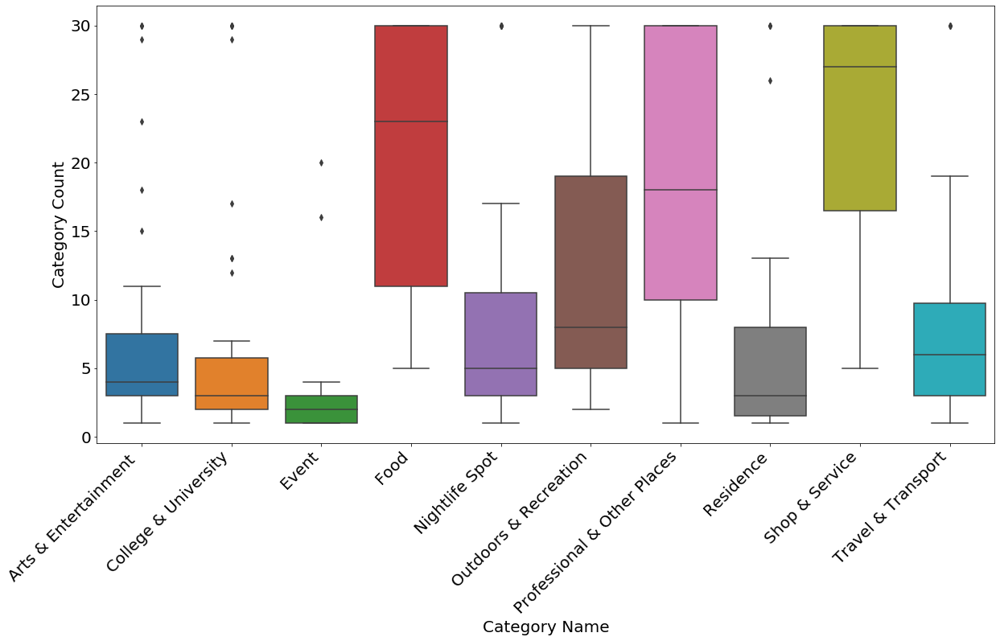

In [45]:
plt.figure(figsize=(20, 10))
plt.xticks(rotation='vertical')

ax = sns.boxplot(x='Category Name', y='Category Count',data=count_df)
ax.set_ylabel('Category Count', fontsize=20)
ax.set_xlabel('Category Name', fontsize=20)
ax.tick_params(labelsize=20)
plt.xticks(rotation=45, ha='right')

In [46]:
all_nearby_venues_df =  pd.DataFrame()
for key in venues_dictionary.keys():
        key_split = key.split(':')
        geohash = key_split[0]
        geohash = geohash.strip('\r\n')
        nearby_venues_cat = venues_dictionary[key]
        if  nearby_venues_cat is None:
            pass
        else:
            geohash_list = [geohash] * (nearby_venues_cat.shape[0])
            nearby_venues_cat['Geohash'] = geohash_list
            all_nearby_venues_df = all_nearby_venues_df.append(nearby_venues_cat, ignore_index=True)

In [47]:
display(all_nearby_venues_df)

,Venue,Venue Latitude,Venue Longitude,Venue Category,Geohash
0,Cineplex Entertainment - Head Office,43.684314,-79.392285,Movie Theater,dpz893q
1,Andrew Freedom Road,43.690156,-79.390726,Music Venue,dpz893q
2,Skyrims Movie Room,43.687683,-79.391580,Movie Theater,dpz893q
3,tarragon,43.688652,-79.393678,Theater,dpz893q
4,Tunnel of Glam,43.689242,-79.394352,Art Gallery,dpz893q
5,Kaghaz Rangi,43.689002,-79.394745,Art Gallery,dpz893q
6,Your Radio,43.688915,-79.394885,Music Venue,dpz893q
7,Toronto Chamber Choir,43.690963,-79.395103,Music Venue,dpz893q
8,Woodlawn Pottery Studio,43.684445,-79.389843,Art Gallery,dpz893q
9,Cineplex Office,43.684700,-79.392856,Movie Theater,dpz893q


In [48]:
#print(all_nearby_venues_df.groupby('Geohash').count())
print('There are {} uniques categories.'.format(len(all_nearby_venues_df['Venue Category'].unique())))

There are 391 uniques categories.


In [49]:
# one hot encoding
all_nearby_venues_df_onehot = pd.get_dummies(all_nearby_venues_df[['Venue Category']], prefix="", prefix_sep="")

# add geohash column back to dataframe
all_nearby_venues_df_onehot['Geohash'] = all_nearby_venues_df['Geohash'] 

# move geohash column to the first column
fixed_columns = [all_nearby_venues_df_onehot.columns[-1]] + list(all_nearby_venues_df_onehot.columns[:-1])
all_nearby_venues_df_onehot = all_nearby_venues_df_onehot[fixed_columns]

display(all_nearby_venues_df_onehot)

,Geohash,ATM,Accessories Store,Acupuncturist,Advertising Agency,Afghan Restaurant,Airport,Alternative Healer,American Restaurant,Animal Shelter,...,Voting Booth,Warehouse,Warehouse Store,Waste Facility,Whisky Bar,Wine Bar,Wine Shop,Wings Joint,Women's Store,Yoga Studio
0,dpz893q,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,dpz893q,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,dpz893q,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,dpz893q,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,dpz893q,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
5,dpz893q,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
6,dpz893q,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
7,dpz893q,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
8,dpz893q,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
9,dpz893q,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [50]:
all_nearby_venues_df_onehot_grouped = all_nearby_venues_df_onehot.groupby('Geohash').mean().reset_index()
print(all_nearby_venues_df_onehot_grouped.shape)
# set number of clusters
kclusters = 6

all_nearby_venues_df_onehot_grouped_clustering = all_nearby_venues_df_onehot_grouped.drop('Geohash', 1)

# run k-means clustering
kmeans = KMeans(n_clusters=kclusters, random_state=0).fit(all_nearby_venues_df_onehot_grouped_clustering)

# check cluster labels generated for each row in the dataframe
kmeans.labels_[0:10] 

(55, 392)


array([4, 1, 4, 3, 4, 4, 4, 4, 4, 3], dtype=int32)

In [51]:
num_top_venues = 5
for geohash in all_nearby_venues_df_onehot_grouped['Geohash']:
    print("----"+geohash+"----")
    temp = all_nearby_venues_df_onehot_grouped[all_nearby_venues_df_onehot_grouped['Geohash'] == geohash].T.reset_index()
    temp.columns = ['venue','freq']
    temp = temp.iloc[1:]
    temp['freq'] = temp['freq'].astype(float)
    temp = temp.round({'freq': 2})
    print(temp.sort_values('freq', ascending=False).reset_index(drop=True).head(num_top_venues))
    print('\n')

----dpxrvzv----
                venue  freq
0            Pharmacy  0.08
1                 Pub  0.06
2              Office  0.06
3    Dentist's Office  0.04
4  Light Rail Station  0.04


----dpz2kdu----
                venue  freq
0              Office  0.29
1               Hotel  0.05
2  Italian Restaurant  0.04
3      Baseball Field  0.04
4   Electronics Store  0.04


----dpz2nc3----
                          venue  freq
0     College Academic Building  0.07
1              Business Service  0.05
2                   Music Venue  0.03
3  General College & University  0.03
4                          Café  0.03


----dpz2nny----
                        venue  freq
0  Construction & Landscaping  0.06
1                      Office  0.05
2        Fast Food Restaurant  0.05
3            Business Service  0.03
4         Government Building  0.03


----dpz2pjw----
                                      venue  freq
0                                  Building  0.07
1                        Italian

                                      venue  freq
0                                    Office  0.10
1  Residential Building (Apartment / Condo)  0.06
2                       Japanese Restaurant  0.04
3                       Rental Car Location  0.04
4                                  Building  0.03


----dpz8dfd----
              venue  freq
0          Hospital  0.07
1              Park  0.07
2          Bus Stop  0.05
3  Business Service  0.05
4    Medical Center  0.05


----dpz8dk7----
               venue  freq
0             Office  0.06
1  Indian Restaurant  0.04
2  Mobile Phone Shop  0.03
3       Burger Joint  0.03
4        Pizza Place  0.03


----dpz8e4u----
          venue  freq
0          Park  0.08
1   Pizza Place  0.08
2        Church  0.05
3     Gastropub  0.05
4  Skating Rink  0.05


----dpz8edp----
                venue  freq
0              Office  0.05
1       Grocery Store  0.04
2   Electronics Store  0.03
3            Building  0.03
4  Chinese Restaurant  0.03


----dpz8

In [52]:
def return_most_common_venues(row, num_top_venues):
    row_categories = row.iloc[1:]
    row_categories_sorted = row_categories.sort_values(ascending=False)
    
    return row_categories_sorted.index.values[0:num_top_venues]

In [53]:
num_top_venues = 10

indicators = ['st', 'nd', 'rd']

# create columns according to number of top venues
columns = ['Geohash']
for ind in np.arange(num_top_venues):
    try:
        columns.append('{}{} Most Common Venue'.format(ind+1, indicators[ind]))
    except:
        columns.append('{}th Most Common Venue'.format(ind+1))

# create a new dataframe
geohash_venues_sorted = pd.DataFrame(columns=columns)
geohash_venues_sorted['Geohash'] = all_nearby_venues_df_onehot_grouped['Geohash']

for ind in np.arange(all_nearby_venues_df_onehot_grouped.shape[0]):
    geohash_venues_sorted.iloc[ind, 1:] = return_most_common_venues(all_nearby_venues_df_onehot_grouped.iloc[ind, :], num_top_venues)

display(geohash_venues_sorted)

,Geohash,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,dpxrvzv,Pharmacy,Office,Pub,Light Rail Station,Bar,Dentist's Office,Pizza Place,Seafood Restaurant,School,Café
1,dpz2kdu,Office,Hotel,Italian Restaurant,Electronics Store,Baseball Field,Deli / Bodega,Business Service,Mediterranean Restaurant,Sandwich Place,Restaurant
2,dpz2nc3,College Academic Building,Business Service,Park,Café,General College & University,Music Venue,Residential Building (Apartment / Condo),Bus Stop,Pharmacy,Mexican Restaurant
3,dpz2nny,Construction & Landscaping,Fast Food Restaurant,Office,Gym / Fitness Center,Home Service,Dance Studio,Music Venue,Business Service,Government Building,Bakery
4,dpz2pjw,Italian Restaurant,Residential Building (Apartment / Condo),Building,Park,Business Service,Light Rail Station,Electronics Store,Pharmacy,Grocery Store,Bar
5,dpz2pqw,Residential Building (Apartment / Condo),Gym / Fitness Center,Pharmacy,Italian Restaurant,Park,Bar,Building,Furniture / Home Store,Liquor Store,Business Service
6,dpz2pr7,Home Service,Italian Restaurant,Park,Building,Residential Building (Apartment / Condo),Pharmacy,Office,Bar,Furniture / Home Store,Business Service
7,dpz2q6p,Business Service,Office,Pub,Doctor's Office,Grocery Store,Pharmacy,Italian Restaurant,Metro Station,Gym,Mobile Phone Shop
8,dpz2quu,Park,Bus Stop,Pizza Place,Medical Center,Hotel,Doctor's Office,High School,Convenience Store,Event Space,Beer Store
9,dpz2sqq,Electronics Store,Mobile Phone Shop,Clothing Store,Doctor's Office,Office,Optical Shop,Department Store,College Classroom,Fast Food Restaurant,Restaurant


In [54]:
# add clustering labels
geohash_venues_sorted.insert(0, 'Cluster Labels', kmeans.labels_)

all_nearby_venues_df_merged = all_nearby_venues_df

# merge toronto_grouped with toronto_data to add latitude/longitude for each geohash
all_nearby_venues_df_merged = all_nearby_venues_df_merged.join(geohash_venues_sorted.set_index('Geohash'), on='Geohash')

In [55]:
display(all_nearby_venues_df_merged)

,Venue,Venue Latitude,Venue Longitude,Venue Category,Geohash,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,Cineplex Entertainment - Head Office,43.684314,-79.392285,Movie Theater,dpz893q,5,Office,Art Gallery,Gym,Gym / Fitness Center,Movie Theater,Park,Sushi Restaurant,Italian Restaurant,Residential Building (Apartment / Condo),Rental Car Location
1,Andrew Freedom Road,43.690156,-79.390726,Music Venue,dpz893q,5,Office,Art Gallery,Gym,Gym / Fitness Center,Movie Theater,Park,Sushi Restaurant,Italian Restaurant,Residential Building (Apartment / Condo),Rental Car Location
2,Skyrims Movie Room,43.687683,-79.391580,Movie Theater,dpz893q,5,Office,Art Gallery,Gym,Gym / Fitness Center,Movie Theater,Park,Sushi Restaurant,Italian Restaurant,Residential Building (Apartment / Condo),Rental Car Location
3,tarragon,43.688652,-79.393678,Theater,dpz893q,5,Office,Art Gallery,Gym,Gym / Fitness Center,Movie Theater,Park,Sushi Restaurant,Italian Restaurant,Residential Building (Apartment / Condo),Rental Car Location
4,Tunnel of Glam,43.689242,-79.394352,Art Gallery,dpz893q,5,Office,Art Gallery,Gym,Gym / Fitness Center,Movie Theater,Park,Sushi Restaurant,Italian Restaurant,Residential Building (Apartment / Condo),Rental Car Location
5,Kaghaz Rangi,43.689002,-79.394745,Art Gallery,dpz893q,5,Office,Art Gallery,Gym,Gym / Fitness Center,Movie Theater,Park,Sushi Restaurant,Italian Restaurant,Residential Building (Apartment / Condo),Rental Car Location
6,Your Radio,43.688915,-79.394885,Music Venue,dpz893q,5,Office,Art Gallery,Gym,Gym / Fitness Center,Movie Theater,Park,Sushi Restaurant,Italian Restaurant,Residential Building (Apartment / Condo),Rental Car Location
7,Toronto Chamber Choir,43.690963,-79.395103,Music Venue,dpz893q,5,Office,Art Gallery,Gym,Gym / Fitness Center,Movie Theater,Park,Sushi Restaurant,Italian Restaurant,Residential Building (Apartment / Condo),Rental Car Location
8,Woodlawn Pottery Studio,43.684445,-79.389843,Art Gallery,dpz893q,5,Office,Art Gallery,Gym,Gym / Fitness Center,Movie Theater,Park,Sushi Restaurant,Italian Restaurant,Residential Building (Apartment / Condo),Rental Car Location
9,Cineplex Office,43.684700,-79.392856,Movie Theater,dpz893q,5,Office,Art Gallery,Gym,Gym / Fitness Center,Movie Theater,Park,Sushi Restaurant,Italian Restaurant,Residential Building (Apartment / Condo),Rental Car Location


In [116]:
def Create_Map(df, map_clusters):
    # set color scheme for the clusters
    x = np.arange(kclusters)
    ys = [i + x + (i*x)**2 for i in range(kclusters)]
    colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
    rainbow = [colors.rgb2hex(i) for i in colors_array]
    
    # add markers to the map
    markers_colors = []
    for lat, lon, poi, cluster in zip(df['Venue Latitude'], df['Venue Longitude'], df['Geohash'], df['Cluster Labels']):
        label = folium.Popup(str(poi) + ' Cluster ' + str(cluster), parse_html=True)
        idx = int(cluster)
        folium.CircleMarker(
                            [lat, lon],
                            radius=5,
                            popup=label,
                            color=rainbow[idx-1],
                            fill=True,
                            fill_color=rainbow[idx-1],
                            fill_opacity=0.7).add_to(map_clusters)

In [57]:
area_address = 'Toronto, Ontario, CA'
toronto_location = get_coordinates(area_address)
map_clusters = folium.Map(location=[toronto_location.latitude, toronto_location.longitude], zoom_start=11)
Create_Map(all_nearby_venues_df_merged, map_clusters)
map_clusters

The geograpical coordinate of Toronto, Ontario, CA is 43.7170226, -79.4197830350134.


In [128]:
save_map_as_image(map_clusters, 'map_clusters')

In [58]:
parking_locations_cluster_0 = all_nearby_venues_df_merged.loc[all_nearby_venues_df_merged['Cluster Labels'] == 0]

In [59]:
parking_locations_cluster_0.shape

(210, 16)

In [60]:
geohash_list = parking_locations_cluster_0.Geohash.unique()

In [61]:
count_df_cluster_0 = pd.DataFrame()
for geohash in geohash_list: 
    count_df_cluster_0 = count_df_cluster_0.append(count_df.loc[count_df['Geohash'] == geohash], ignore_index=True)

(array([0, 1, 2, 3, 4, 5, 6, 7, 8]), <a list of 9 Text xticklabel objects>)

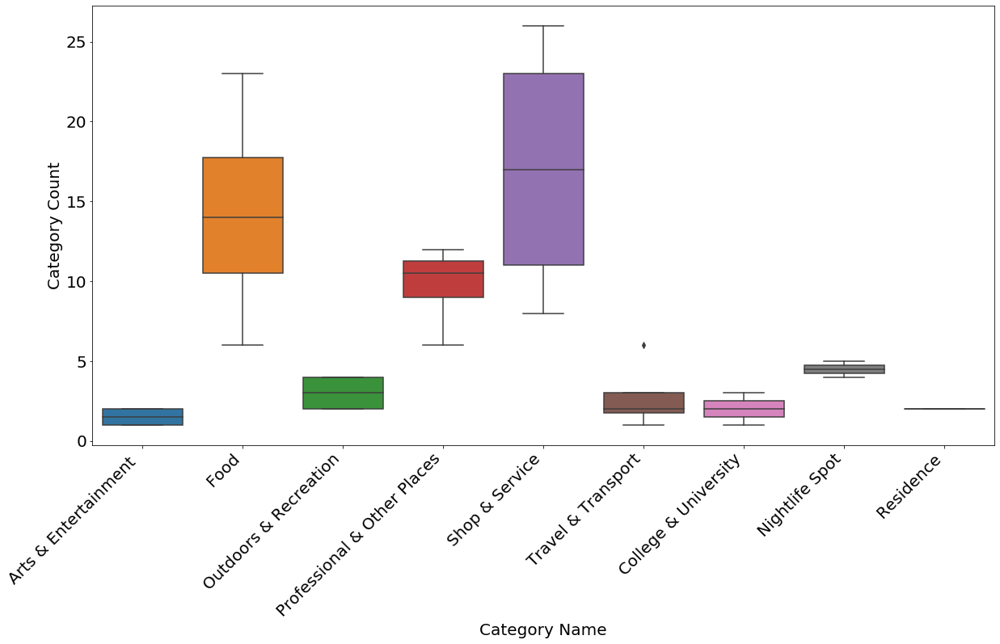

In [62]:
plt.figure(figsize=(20, 10))
plt.xticks(rotation='vertical')

ax = sns.boxplot(x='Category Name', y='Category Count',data=count_df_cluster_0)
ax.set_ylabel('Category Count', fontsize=20)
ax.set_xlabel('Category Name', fontsize=20)
ax.tick_params(labelsize=20)
plt.xticks(rotation=45, ha='right')

In [115]:
#area_address = 'Toronto, Ontario, CA'
#toronto_location = get_coordinates(area_address)
print(toronto_location.latitude, ',', toronto_location.longitude)
map_clusters_0 = folium.Map(location=[toronto_location.latitude, toronto_location.longitude], zoom_start=11)
Create_Map(parking_locations_cluster_0, map_clusters_0)
display(map_clusters_0)

43.7170226 , -79.4197830350134


In [129]:
save_map_as_image(map_clusters_0, 'map_clusters_0')

In [64]:
parking_locations_cluster_1 = all_nearby_venues_df_merged.loc[all_nearby_venues_df_merged['Cluster Labels'] == 1]
geohash_list = parking_locations_cluster_1.Geohash.unique()

In [65]:
count_df_cluster_1 = pd.DataFrame()
for geohash in geohash_list: 
    count_df_cluster_1 = count_df_cluster_1.append(count_df.loc[count_df['Geohash'] == geohash], ignore_index=True)

(array([0, 1, 2, 3, 4, 5, 6, 7, 8, 9]), <a list of 10 Text xticklabel objects>)

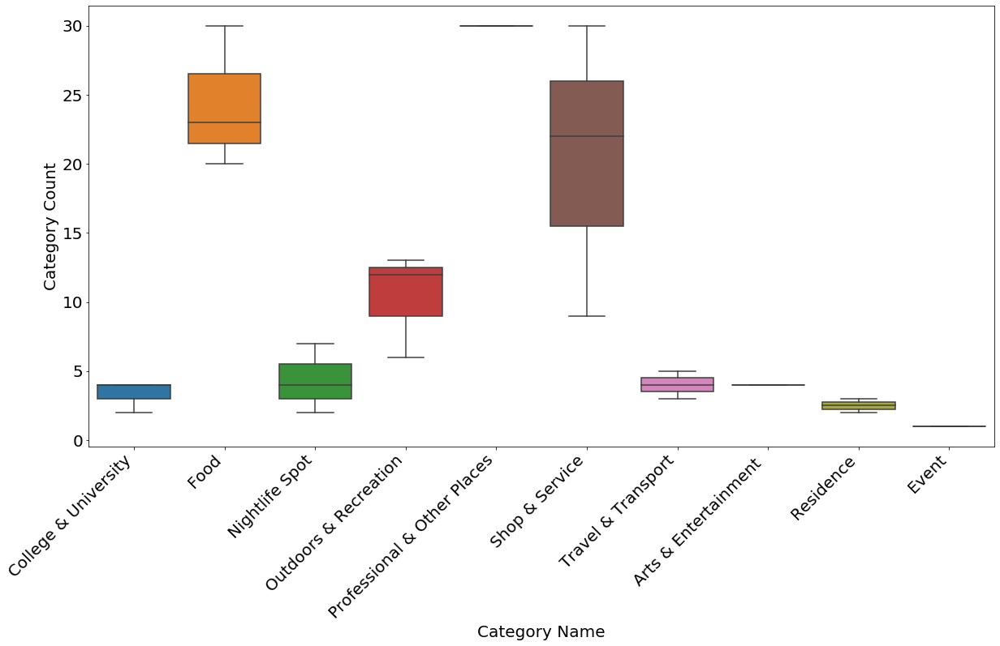

In [66]:
plt.figure(figsize=(20, 10))
plt.xticks(rotation='vertical')

ax = sns.boxplot(x='Category Name', y='Category Count',data=count_df_cluster_1)
ax.set_ylabel('Category Count', fontsize=20)
ax.set_xlabel('Category Name', fontsize=20)
ax.tick_params(labelsize=20)
plt.xticks(rotation=45, ha='right')

In [119]:
#area_address = 'Toronto, Ontario, CA'
#toronto_location = get_coordinates(area_address)
map_clusters_1 = folium.Map(location=[toronto_location.latitude, toronto_location.longitude], zoom_start=11)
Create_Map(parking_locations_cluster_1, map_clusters_1)
display(map_clusters_1)

In [130]:
save_map_as_image(map_clusters_1, 'map_clusters_1')

In [68]:
parking_locations_cluster_2 = all_nearby_venues_df_merged.loc[all_nearby_venues_df_merged['Cluster Labels'] == 2]
geohash_list = parking_locations_cluster_2.Geohash.unique()

In [69]:
count_df_cluster_2 = pd.DataFrame()
for geohash in geohash_list: 
    count_df_cluster_2 = count_df_cluster_2.append(count_df.loc[count_df['Geohash'] == geohash], ignore_index=True)
display(count_df_cluster_2)

,Geohash,Category Name,Category Count
0,dpz8fws,Arts & Entertainment,1
1,dpz8fws,College & University,2
2,dpz8fws,Event,1
3,dpz8fws,Food,6
4,dpz8fws,Outdoors & Recreation,5
5,dpz8fws,Professional & Other Places,5
6,dpz8fws,Residence,5
7,dpz8fws,Shop & Service,5
8,dpz8fws,Travel & Transport,7


In [121]:
#area_address = 'Toronto, Ontario, CA'
#toronto_location = get_coordinates(area_address)
map_clusters_2 = folium.Map(location=[toronto_location.latitude, toronto_location.longitude], zoom_start=11)
Create_Map(parking_locations_cluster_2, map_clusters_2)
display(map_clusters_2)

In [132]:
save_map_as_image(map_clusters_2, 'map_clusters_2')

In [71]:
parking_locations_cluster_3 = all_nearby_venues_df_merged.loc[all_nearby_venues_df_merged['Cluster Labels'] == 3]
geohash_list = parking_locations_cluster_3.Geohash.unique()

In [72]:
count_df_cluster_3 = pd.DataFrame()
for geohash in geohash_list: 
    count_df_cluster_3 = count_df_cluster_3.append(count_df.loc[count_df['Geohash'] == geohash], ignore_index=True)
#display(count_df_cluster_3)

(array([0, 1, 2, 3, 4, 5, 6, 7, 8]), <a list of 9 Text xticklabel objects>)

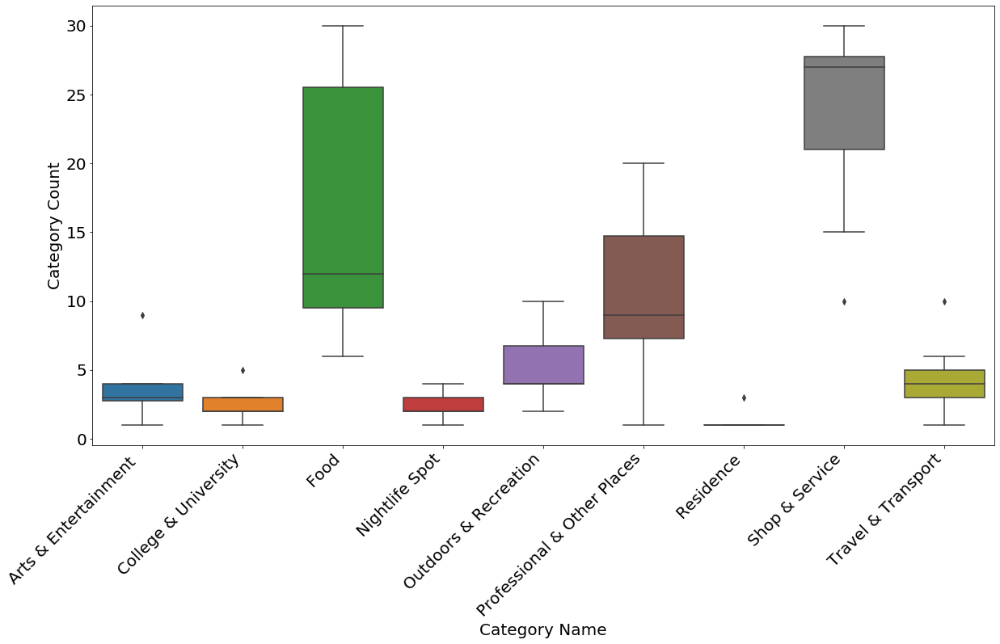

In [73]:
plt.figure(figsize=(20, 10))
plt.xticks(rotation='vertical')

ax = sns.boxplot(x='Category Name', y='Category Count',data=count_df_cluster_3)
ax.set_ylabel('Category Count', fontsize=20)
ax.set_xlabel('Category Name', fontsize=20)
ax.tick_params(labelsize=20)
plt.xticks(rotation=45, ha='right')

In [123]:
#area_address = 'Toronto, Ontario, CA'
#toronto_location = get_coordinates(area_address)
map_clusters_3 = folium.Map(location=[toronto_location.latitude, toronto_location.longitude], zoom_start=11)
Create_Map(parking_locations_cluster_3, map_clusters_3)
display(map_clusters_3)


In [133]:
save_map_as_image(map_clusters_3, 'map_clusters_3')

In [75]:
parking_locations_cluster_4 = all_nearby_venues_df_merged.loc[all_nearby_venues_df_merged['Cluster Labels'] == 4]
geohash_list = parking_locations_cluster_4.Geohash.unique()

In [76]:
count_df_cluster_4 = pd.DataFrame()
for geohash in geohash_list: 
    count_df_cluster_4 = count_df_cluster_4.append(count_df.loc[count_df['Geohash'] == geohash], ignore_index=True)
#display(count_df_cluster_3)

(array([0, 1, 2, 3, 4, 5, 6, 7, 8, 9]), <a list of 10 Text xticklabel objects>)

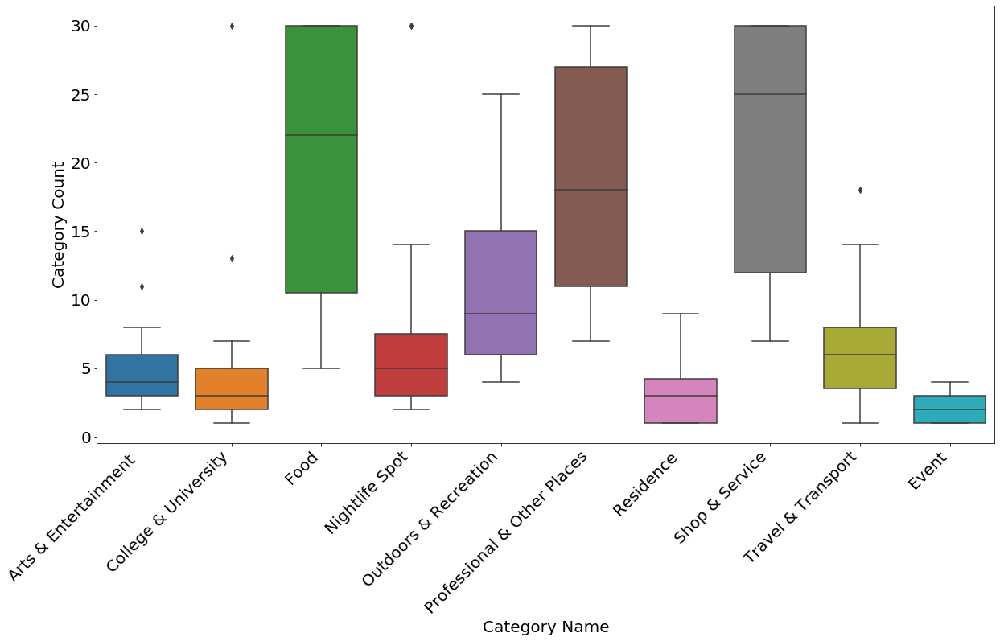

In [77]:
plt.figure(figsize=(20, 10))
plt.xticks(rotation='vertical')

ax = sns.boxplot(x='Category Name', y='Category Count',data=count_df_cluster_4)
ax.set_ylabel('Category Count', fontsize=20)
ax.set_xlabel('Category Name', fontsize=20)
ax.tick_params(labelsize=20)
plt.xticks(rotation=45, ha='right')

In [124]:
#area_address = 'Toronto, Ontario, CA'
#toronto_location = get_coordinates(area_address)
map_clusters_4 = folium.Map(location=[toronto_location.latitude, toronto_location.longitude], zoom_start=11)
Create_Map(parking_locations_cluster_4, map_clusters_4)
display(map_clusters_4)

In [134]:
save_map_as_image(map_clusters_4, 'map_clusters_4')

In [79]:
parking_locations_cluster_5 = all_nearby_venues_df_merged.loc[all_nearby_venues_df_merged['Cluster Labels'] == 5]
geohash_list = parking_locations_cluster_5.Geohash.unique()

In [80]:
count_df_cluster_5 = pd.DataFrame()
for geohash in geohash_list: 
    count_df_cluster_5 = count_df_cluster_5.append(count_df.loc[count_df['Geohash'] == geohash], ignore_index=True)
#display(count_df_cluster_3)

(array([0, 1, 2, 3, 4, 5, 6, 7, 8, 9]), <a list of 10 Text xticklabel objects>)

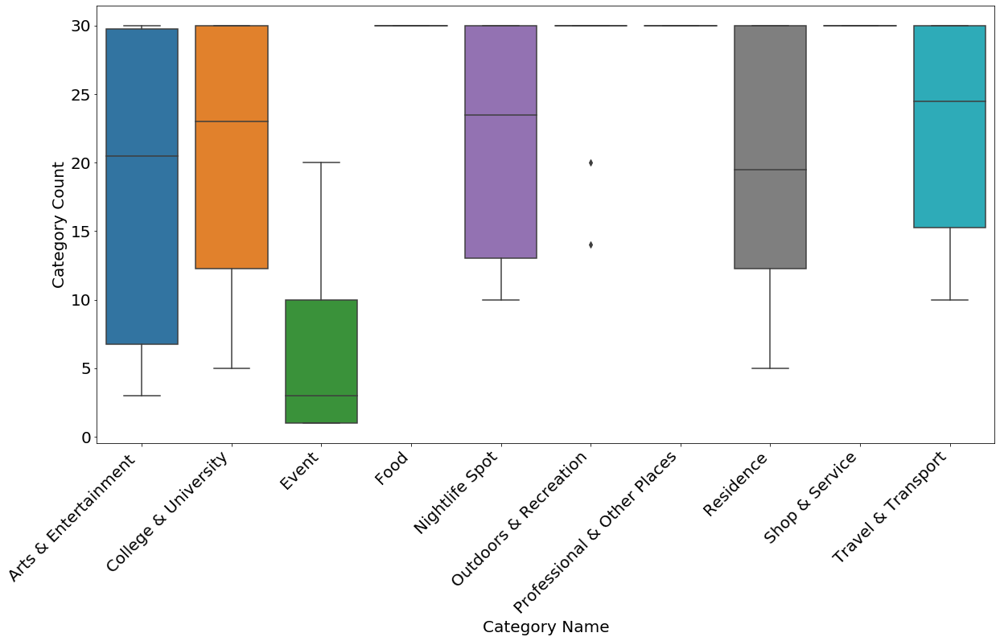

In [81]:
plt.figure(figsize=(20, 10))
plt.xticks(rotation='vertical')

ax = sns.boxplot(x='Category Name', y='Category Count',data=count_df_cluster_5)
ax.set_ylabel('Category Count', fontsize=20)
ax.set_xlabel('Category Name', fontsize=20)
ax.tick_params(labelsize=20)
plt.xticks(rotation=45, ha='right')

In [125]:
#area_address = 'Toronto, Ontario, CA'
#toronto_location = get_coordinates(area_address)
map_clusters_5 = folium.Map(location=[toronto_location.latitude, toronto_location.longitude], zoom_start=11)
Create_Map(parking_locations_cluster_5, map_clusters_5)
display(map_clusters_5)

In [ ]:
save_map_as_image(map_clusters_5, 'map_clusters_5')